<a href="https://colab.research.google.com/github/malcolmlett/ml-learning/blob/main/Experiment_SLAM_6b.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Experiment: SLAM (v6.b) - Visualising broken learning curve
Side-track from v6 focusing on visualising and identifying the cause of learning breakdown within the first 2 epochs of training when training just for ADLO output.

Something just seems weird. Why are we not getting any improvement to performance over time. Why did a different architecture not produce different results.

So let's track down that problem.

As part of this, we'll visualise the activations and gradients to identify the layer with the problem. We'll use the toolkit originally devised from my ml-learning repo:
* https://github.com/malcolmlett/ml-learning/blob/main/Learning_visualisations_v7.ipynb - gradient visualisation
* https://github.com/malcolmlett/ml-learning/blob/main/Learning_visualisations_v8.ipynb - activity visualisation


In [ ]:
# Clone repo and load its modules

import os
if os.path.isdir('repo'):
  # discard any local changes and update
  !cd repo && git reset --hard HEAD
  !cd repo && git fetch
else:
  !git clone https://github.com/malcolmlett/robovac.git repo

# start with the revision with problems
!cd repo && git checkout 6c8e34c79e2

# Also checkout ml-learning repo
if os.path.isdir('ml-learning'):
  # discard any local changes and update
  !cd ml-learning && git reset --hard HEAD
  !cd ml-learning && git fetch
else:
  !git clone https://github.com/malcolmlett/ml-learning.git ml-learning
#!cd ml-learning && git checkout c4f0bfe
!cd ml-learning && git pull

import sys
sys.path.append('repo')
sys.path.append('ml-learning')

from general_utils import display_history
import lds
import slam_models
import slam_data
import slam_operations
import train_observability_toolkit as tot
import train_explainer as te
from importlib import reload
reload(lds)
reload(slam_models)
reload(slam_data)
reload(slam_operations)
reload(tot)
reload(te)

HEAD is now at 6c8e34c Detailed examination of layer 35 but no clarity yet.
Already up to date.
HEAD is now at 130cd3e Bug fixes
remote: Enumerating objects: 5, done.
remote: Counting objects: 100% (5/5), done.
remote: Compressing objects: 100% (1/1), done.
remote: Total 3 (delta 2), reused 3 (delta 2), pack-reused 0 (from 0)
Unpacking objects: 100% (3/3), 419 bytes | 83.00 KiB/s, done.
From https://github.com/malcolmlett/ml-learning
   130cd3e..a886b7d  main       -> origin/main
Updating 130cd3e..a886b7d
Fast-forward
 train_observability_toolkit.py | 12 ++++++------
 1 file changed, 6 insertions(+), 6 deletions(-)


<module 'train_explainer' from '/content/ml-learning/train_explainer.py'>

In [ ]:
# Load standard libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import tensorflow as tf
import IPython.display as idisplay
import os
import sys
import math
import tqdm
import time
from timeit import default_timer as timer
from tensorflow.keras.layers import Input
from tensorflow.keras.layers import Conv2D
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import MaxPooling2D
from tensorflow.keras.layers import ZeroPadding2D
from tensorflow.keras.layers import Cropping2D
from tensorflow.keras.layers import Dropout
from tensorflow.keras.layers import Conv2DTranspose
from tensorflow.keras.layers import Concatenate
from tensorflow.keras.layers import Add


print(f"TensorFlow version: {tf.__version__}")
print(f"Keras version: {tf.keras.__version__}")
print(f"Python version: {sys.version}")

TensorFlow version: 2.18.0
Keras version: 3.8.0
Python version: 3.11.11 (main, Dec  4 2024, 08:55:07) [GCC 11.4.0]


In [ ]:
# Training data
# - use model-derived training data to emulate the end of the real training loop
floorplan = slam_data.load_floorplan('repo/data/experimental-floorplan2.png')

# Load training data
if os.path.isfile('custom-training-data.npz'):
  train_data = slam_data.load_dataset('custom-training-data.npz')
else:
  print(f"Sorry, pre-generated dataset not available, you'll need to generate it.")

  # Load pre-trained model
  raw_model = tf.keras.models.load_model('slam-model-300epochs.keras')

  # generate data
  np.random.seed(0)  # for consistency
  train_data = slam_data.generate_training_data(floorplan, 1000, model=raw_model)
  slam_data.validate_dataset(train_data)

  # save
  slam_data.save_dataset(train_data, 'custom-training-data.npz')

Loaded:
  input_maps:  (1000, 149, 149, 3) x float32
  lds_maps:    (1000, 149, 149) x float32
  output_maps: (1000, 149, 149, 3) x float32
  adlos:       (1000, 4) x float32
  metadatas:   (1000, 8) x float32
Dataset loaded from custom-training-data.npz


## Local tools


In [ ]:
def show_adlo_predictions(model, dataset, num=5, sample_types=None, display_type='plot', **kwargs):
    """
    display_type: one of 'plot', 'list'
    """
    print(sample_types)
    dataset = slam_data.filter_dataset(dataset, num, sample_types)
    inputs, outputs, metadatas = next(iter(dataset.batch(num)))
    preds = model.predict(inputs)

    if display_type == 'plot':
      for map_window, lds_map, ground_truth_map, adlo, metadata, adlo_pred in zip(
              inputs[0], inputs[1], outputs[0], outputs[1], metadatas, preds):
          map_pred = None
          show_adlo_prediction(map_window, lds_map, ground_truth_map, adlo, metadata, map_pred, adlo_pred, **kwargs)
    elif display_type == 'list':
      data = []
      for map_window, lds_map, ground_truth_map, adlo, metadata, adlo_pred in zip(
              inputs[0], inputs[1], outputs[0], outputs[1], metadatas, preds):
          map_pred = None
          adlo_pred_scaled = scale_adlo_prediction(map_window, lds_map, ground_truth_map, adlo, metadata, map_pred, adlo_pred, **kwargs)
          data.append([
              metadata[1].numpy(),  # sample type
              adlo[0].numpy(), adlo_pred[0],  # accept
              adlo[1].numpy(), adlo_pred[1],  # delta x
              adlo[2].numpy(), adlo_pred[2],  # delta y
              adlo[3].numpy(), adlo_pred[3],  # delta orientation
          ])
      columns = ['type', 'accept', 'accept_pred', 'delta_x', 'delta_x_pred', 'delta_y', 'delta_y_pred', 'delta_orientation', 'delta_orientation_pred']
      df = pd.DataFrame(data, columns=columns)
      display(df)
    else:
      raise ValueError(f"Unknown display type: {display_type}")

def scale_adlo_prediction(input_map, lds_map, map_true, adlo, metadata, map_pred, adlo_pred, **kwargs):
    from_logits = kwargs.get('from_logits', True)

    # apply scaling
    if adlo_pred is not None:
        accept = tf.nn.sigmoid(adlo_pred[0]) if from_logits else adlo_pred[0]
        adlo_pred_scaled = tf.stack([accept, adlo_pred[1], adlo_pred[2], adlo_pred[3]], axis=0)
    else:
        adlo_pred_scaled = None

    return adlo_pred_scaled

def show_adlo_prediction(input_map, lds_map, map_true, adlo, metadata, map_pred, adlo_pred, **kwargs):
    """
    :param input_map:
    :param lds_map:
    :param map_true:
    :param adlo:
    :param metadata:
    :param map_pred:
    :param adlo_pred:

    Keyword args:
      show_classes: one of 'none' (or False), 'all' (or True), 'pred'
    """
    from_logits = kwargs.get('from_logits', True)
    show_classes = kwargs.get('show_classes', 'none')
    map_size = np.array([input_map.shape[1], input_map.shape[0]])
    n_classes = input_map.shape[-1]

    # apply scaling
    if adlo_pred is not None:
        accept = tf.nn.sigmoid(adlo_pred[0]) if from_logits else adlo_pred[0]
        adlo_pred_scaled = tf.stack([accept, adlo_pred[1], adlo_pred[2], adlo_pred[3]], axis=0)
    else:
        adlo_pred_scaled = None

    # Log details that are not so great in visual form
    print(f"adlo-true: {adlo}")
    print(f"adlo-pred: {adlo_pred_scaled}")
    print(f"metadata:  {metadata}")

    # Calculate total number of plots to display
    cols = 0
    cols = cols + (1 if input_map is not None else 0)
    cols = cols + (1 if lds_map is not None else 0)
    cols = cols + (1 if map_true is not None else 0)

    # Show plots
    plt.figure(figsize=(10, 2))  # limits by row height
    i = iter(range(1, cols+1))

    if input_map is not None:
        plt.subplot(1, cols, next(i))
        plt.title('Map')
        plt.imshow(input_map)
        plt.axis('off')
        if adlo is not None and not adlo[0]:
            # to be rejected so just add cross through map
            plt.plot([0, map_size[0] - 1], [0, map_size[1] - 1], c='y')
            plt.plot([0, map_size[0] - 1], [map_size[1] - 1, 0], c='y')
        elif adlo is not None:
            # show adlo relative to centre dot
            centre = map_size / 2
            error_loc = centre + adlo[1:3] * map_size
            angle_loc = error_loc + np.array([np.cos(adlo[3] * np.pi), np.sin(adlo[3] * np.pi)]) * 50
            plt.plot([error_loc[0], angle_loc[0]], [error_loc[1], angle_loc[1]], c='m')
            plt.scatter(centre[0], centre[1], c='k', s=50)
            plt.scatter(error_loc[0], error_loc[1], c='m', s=50)

    if lds_map is not None:
        plt.subplot(1, cols, next(i))
        plt.title('LDS')
        plt.imshow(lds_map, cmap='gray')
        plt.axis('off')

    if map_true is not None:
        plt.subplot(1, cols, next(i))
        plt.title('Ground Truth')
        plt.imshow(map_true)
        plt.axis('off')
        if adlo_pred_scaled is not None:
            centre = map_size / 2
            error_loc = centre + adlo_pred_scaled[1:3] * map_size
            angle = adlo_pred_scaled[3] * np.pi
            angle_loc = error_loc + np.array([np.cos(angle), np.sin(angle)]) * 50
            plt.plot([error_loc[0], angle_loc[0]], [error_loc[1], angle_loc[1]], c='m')
            plt.scatter(centre[0], centre[1], c='k', s=50)
            plt.scatter(error_loc[0], error_loc[1], c='m', s=50)

    plt.show()

def plot_weights(model, all_layers=False):
  """
  model - the model
  """

  # collect all variables across the entire model into a single flattened array
  all_variables = []
  for layer in model.layers:
    for weight in layer.weights:
      all_variables = np.append(all_variables, weight.numpy().flatten())

  L = len(model.layers)
  if all_layers:
    plots_tot = L+1
  else:
    plots_tot = 1
  plots_cols = math.floor(math.sqrt(plots_tot))
  plots_rows = math.ceil(plots_tot / plots_cols)

  plt.figure(layout='constrained', figsize=(20,20))

  plt.subplot(plots_rows, plots_cols, 1)
  plt.title("All Layers")
  plt.hist(all_variables)
  plt.xlabel("value")
  plt.ylabel("histogram count")

  if all_layers:
    for l in range(L):
      variables = []
      for weight in model.layers[l].weights:
        variables = np.append(variables, weight.numpy().flatten())
      plt.subplot(plots_rows, plots_cols, l+2)
      plt.title(f"layer {l}:\n{model.layers[l].name}")
      plt.hist(variables)
      plt.xlabel("value")
      plt.ylabel("histogram count")
  plt.show()

def plot_conv_layer_values(values):
  global_min = tf.reduce_min(values).numpy()
  global_max = tf.reduce_max(values).numpy()
  inp_to_outp_min = tf.reduce_min(values, axis=(0,1))
  inp_to_outp_mean = tf.reduce_mean(values, axis=(0,1))
  inp_to_outp_max = tf.reduce_max(values, axis=(0,1))
  plot_aspect = inp_to_outp_mean.shape[1] / inp_to_outp_mean.shape[0]
  kernel_min = tf.reduce_min(values, axis=(2,3))
  kernel_mean = tf.reduce_mean(values, axis=(2,3))
  kernel_max = tf.reduce_max(values, axis=(2,3))

  plt.figure(figsize=(15,10))

  plt.subplot(2,3,1)
  plt.title(f"min:{w.numpy().shape} --> {inp_to_outp_min.numpy().shape}")
  plt.xlabel("output channels")
  plt.ylabel("input channels")
  plt.imshow(inp_to_outp_min, aspect=plot_aspect, vmin=global_min, vmax=global_max)
  plt.colorbar()

  plt.subplot(2,3,2)
  plt.title(f"mean:{w.numpy().shape} --> {inp_to_outp_mean.numpy().shape}")
  plt.xlabel("output channels")
  plt.ylabel("input channels")
  plt.imshow(inp_to_outp_mean, aspect=plot_aspect, vmin=global_min, vmax=global_max)
  plt.colorbar()

  plt.subplot(2,3,3)
  plt.title(f"max:{w.numpy().shape} --> {inp_to_outp_max.numpy().shape}")
  plt.xlabel("output channels")
  plt.ylabel("input channels")
  plt.imshow(inp_to_outp_max, aspect=plot_aspect, vmin=global_min, vmax=global_max)
  plt.colorbar()

  plt.subplot(2,3,4)
  plt.title(f"min:{w.numpy().shape} --> {kernel_min.numpy().shape}")
  plt.imshow(kernel_min, vmin=global_min, vmax=global_max)
  plt.colorbar()

  plt.subplot(2,3,5)
  plt.title(f"mean:{w.numpy().shape} --> {kernel_mean.numpy().shape}")
  plt.imshow(kernel_mean, vmin=global_min, vmax=global_max)
  plt.colorbar()

  plt.subplot(2,3,6)
  plt.title(f"max:{w.numpy().shape} --> {kernel_max.numpy().shape}")
  plt.imshow(kernel_max, vmin=global_min, vmax=global_max)
  plt.colorbar()

  plt.show()

## Simplified Model
ADLO Output only model.

In [ ]:
def adlo_model(map_shape, conv_filters=32, adlo_units=256, **kwargs):
    merge_mode = kwargs.get('merge_mode', 'concat')
    output_logits = kwargs.get('output_logits', True)
    do_compile = kwargs.get('compile', False)
    dlo_encoding = kwargs.get('dlo_encoding', 'linear/importance')

    # Sanity check
    if np.size(map_shape) != 3:
        raise ValueError(f"Map shape must have 3 dims, found {np.size(map_shape)}")

    # Prepare map input
    # (pad so it's a multiple of our down/up-scaling blocks)
    map_input = Input(shape=map_shape, name='map_input')
    map_down, pad_w, pad_h = slam_models.pad_block(map_input, map_shape)
    n_classes = map_shape[2]

    # Prepare LDS input
    # (convert from (B,H,W) to (B,H,W,1) to make later work easier)
    # (pad so it's a multiple of our down/up-scaling blocks)
    lds_shape = (map_shape[0], map_shape[1], 1)
    lds_input = Input(shape=(map_shape[0], map_shape[1]), name='lds_input')  # raw input omits channels axis
    lds_down = tf.keras.layers.Reshape(target_shape=lds_shape)(lds_input)
    lds_down, _, _ = slam_models.pad_block(lds_down, lds_shape)

    # Map downsampling input arm
    # (each block here returns two outputs (downsampled, convolved-only),
    #  the latter is used for skip-connections)
    map_down, map_skip1 = slam_models.slam_down_block(map_down, conv_filters)
    map_down, map_skip2 = slam_models.slam_down_block(map_down, conv_filters * 2)
    map_down, map_skip3 = slam_models.slam_down_block(map_down, conv_filters * 4)
    map_down, map_skip4 = slam_models.slam_down_block(map_down, conv_filters * 8, dropout_prob=0.3)

    # LDS downsampling input arm
    lds_down, lds_skip1 = slam_models.slam_down_block(lds_down, conv_filters)
    lds_down, lds_skip2 = slam_models.slam_down_block(lds_down, conv_filters * 2)
    lds_down, lds_skip3 = slam_models.slam_down_block(lds_down, conv_filters * 4)
    lds_down, lds_skip4 = slam_models.slam_down_block(lds_down, conv_filters * 8, dropout_prob=0.3)

    # Bottom layer
    # (combine both input arms, apply some final convolutions, leave at same scale)
    bottom = Concatenate(axis=3)([map_down, lds_down])
    #bottom, _ = slam_models.slam_down_block(bottom, conv_filters * 16, max_pooling=False)
    #bottom, _ = slam_models.slam_down_block(bottom, conv_filters * 16, max_pooling=False)
    bottom, _ = slam_models.slam_down_block(bottom, conv_filters * 16, dropout_prob=0.3, max_pooling=False)

    # Accept and Delta location/orientation output
    adlo_out = slam_models.adlo_block(bottom, adlo_units, output_logits, dlo_encoding)

    model = tf.keras.Model(inputs=[map_input, lds_input], outputs=[adlo_out])

    if do_compile:
        loss = (
            slam_models.ADLOLoss(from_logits=output_logits, dlo_encoding=dlo_encoding)
        )
        metrics = {
            'adlo_output': [slam_models.ADLOLoss(from_logits=output_logits, dlo_encoding=dlo_encoding),
                            slam_models.AcceptAccuracy(),
                            slam_models.LocationError(),
                            slam_models.OrientationError()]
        }
        model.compile(optimizer='adam', loss=loss, metrics=metrics)

    print(f"Prepared SLAM model")
    print(f"  Map shape:        {map_shape} + padding ({pad_h}, {pad_w}, 0)")
    print(f"  Skip-connections: {merge_mode}")
    print(f"  Output scaling:   {'logits' if output_logits else 'scaled'}")
    print(f"  DLO encoding:     {dlo_encoding}")
    print(f"  Layers:           {len(model.layers)}")
    print(f"  Inputs:           {model.inputs}")
    print(f"  Outputs:          {model.outputs}")
    print(f"  Output names:     {model.output_names}")
    print(f"  Compiled:         {do_compile}")
    return model

def for_adlo_training(inputs, outputs, metadata):
    (map_input, lds_input), (map_output, adlo_output) = inputs, outputs
    return (map_input, lds_input), adlo_output

/usr/local/lib/python3.11/dist-packages/tensorflow/python/data/ops/structured_function.py:258: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(


Prepared SLAM model
  Map shape:        (149, 149, 3) + padding (11, 11, 0)
  Skip-connections: concat
  Output scaling:   logits
  DLO encoding:     linear/importance
  Layers:           38
  Inputs:           [<KerasTensor shape=(None, 149, 149, 3), dtype=float32, sparse=False, name=map_input>, <KerasTensor shape=(None, 149, 149), dtype=float32, sparse=False, name=lds_input>]
  Outputs:          [<KerasTensor shape=(None, 4), dtype=float32, sparse=False, name=keras_tensor_377>]
  Output names:     ListWrapper(['adlo_output'])
  Compiled:         True
Epoch 1/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 14s 424ms/step - accept_accuracy: 0.6381 - adlo_loss: 5.7788 - loc_error: 0.2044 - loss: 5.7805 - orientation_error: 1.4584
Epoch 2/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 15s 457ms/step - accept_accuracy: 0.7480 - adlo_loss: 1.2874 - loc_error: 0.1122 - loss: 1.2881 - orientation_error: 0.2029
Epoch 3/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 14s 429ms/step - accept_accuracy: 0.7595 - adlo_loss: 1.2410 - loc_error: 0.108

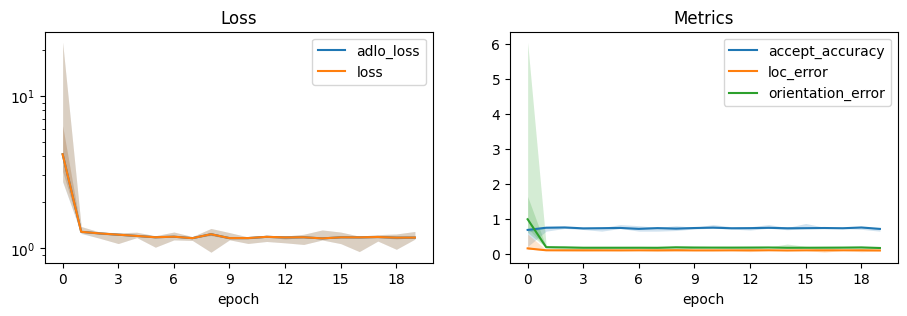

In [ ]:
# Train model
reload(slam_models)
np.random.seed(42)
tf.random.set_seed(42)
epochs = 20
batch_size = 32
tf.config.run_functions_eagerly(True)
map_shape = next(iter(train_data))[0][0].shape
model_train_data = train_data.map(for_adlo_training)\
  .shuffle(buffer_size=len(train_data))\
  .batch(batch_size)\
  .prefetch(tf.data.experimental.AUTOTUNE)
model = adlo_model(map_shape, compile=True)

per_step=False
variables = tot.VariableHistoryCallback(per_step=per_step)
outputs = tot.LayerOutputHistoryCallback(per_step=per_step)
gradients = tot.GradientHistoryCallback(per_step=per_step)
output_gradients = tot.LayerOutputGradientHistoryCallback(per_step=per_step)

start = timer()
#model_history = model.fit(model_train_data, epochs=epochs, callbacks=[tot.HistoryStats()])
model_history = tot.fit(model, model_train_data, epochs=epochs, callbacks=[variables, outputs, gradients, output_gradients, tot.HistoryStats(per_step=per_step)])
duration = (timer() - start)

print(f"Total epochs: {epochs}, duration: {duration} sec")
tot.plot_train_history(model_history)

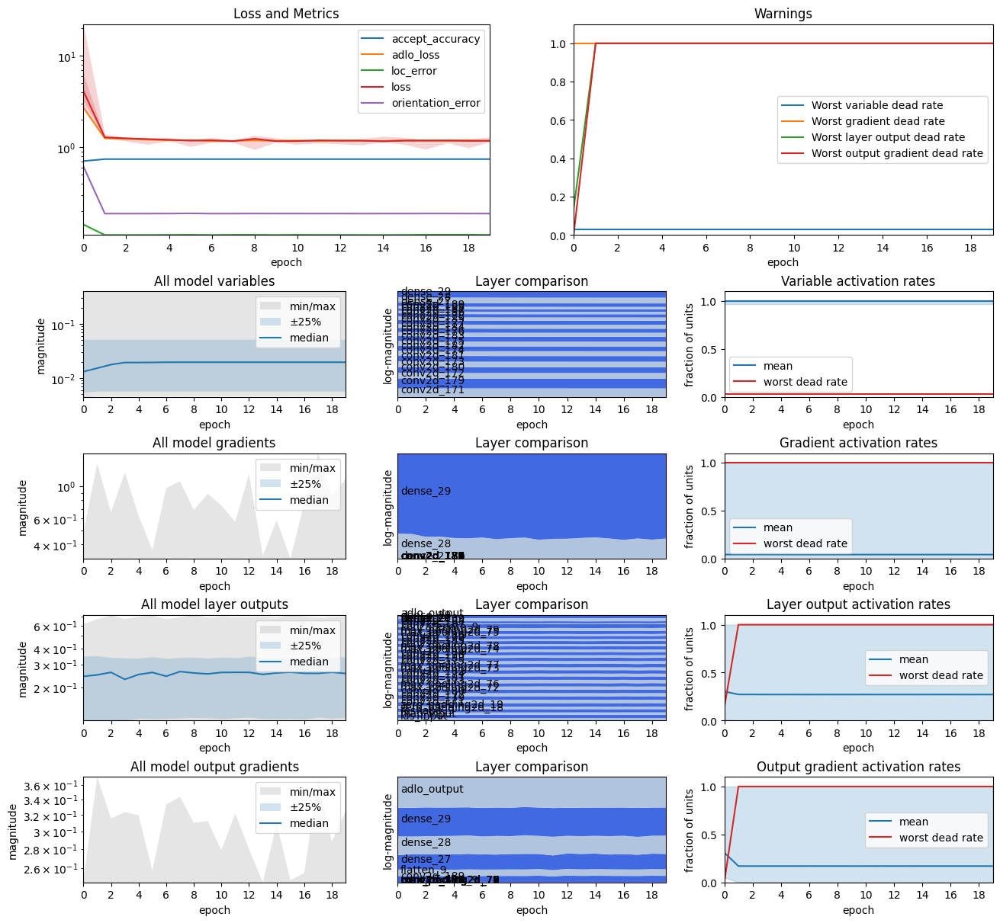

In [ ]:
tot.plot_history_overview(callbacks=[model_history, variables, outputs, gradients, output_gradients])

In [ ]:
model.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ lds_input (InputLayer)    │ (None, 149, 149)       │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ map_input (InputLayer)    │ (None, 149, 149, 3)    │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ reshape (Reshape)         │ (None, 149, 149, 1)    │              0 │ lds_input[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ zero_padding2d            │ (None, 160, 160, 3)    │              0 │ map_input[0][0]        │
│ (ZeroPadding2D)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ zero_padding2d_1          │ (None, 160, 160, 1)    │              0 │ reshape[0][0]          │
│ (ZeroPadding2D)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d (Conv2D)           │ (None, 160, 160, 32)   │            896 │ zero_padding2d[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_8 (Conv2D)         │ (None, 160, 160, 32)   │            320 │ zero_padding2d_1[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_1 (Conv2D)         │ (None, 160, 160, 32)   │          9,248 │ conv2d[0][0]           │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_9 (Conv2D)         │ (None, 160, 160, 32)   │          9,248 │ conv2d_8[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d             │ (None, 80, 80, 32)     │              0 │ conv2d_1[0][0]         │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_4           │ (None, 80, 80, 32)     │              0 │ conv2d_9[0][0]         │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_2 (Conv2D)         │ (None, 80, 80, 64)     │         18,496 │ max_pooling2d[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_10 (Conv2D)        │ (None, 80, 80, 64)     │         18,496 │ max_pooling2d_4[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_3 (Conv2D)         │ (None, 80, 80, 64)     │         36,928 │ conv2d_2[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_11 (Conv2D)        │ (None, 80, 80, 64)     │         36,928 │ conv2d_10[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_1           │ (None, 40, 40, 64)     │              0 │ conv2d_3[0][0]         │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_5           │ (None, 40, 40, 64)     │              0 │ conv2d_11[0][0]        │
│ (MaxPooling2D)       

 Total params: 22,841,918 (87.14 MB)

 Trainable params: 7,613,972 (29.04 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 15,227,946 (58.09 MB)

In [ ]:
model_train_data = train_data.map(for_adlo_training)\
  .shuffle(buffer_size=len(train_data))\
  .batch(batch_size)\
  .prefetch(tf.data.experimental.AUTOTUNE)

for inputs, outputs in model_train_data.take(1):
    print(f"map_input: {inputs[0].shape}, lds_input: {inputs[0].shape}, adlo_output: {outputs.shape}")
    print(outputs)

map_input: (32, 149, 149, 3), lds_input: (32, 149, 149, 3), adlo_output: (32, 4)
tf.Tensor(
[[ 1.         -0.07320844  0.01934298  0.05644173]
 [ 1.         -0.04037928 -0.07756054 -0.9664013 ]
 [ 0.          0.          0.          0.        ]
 [ 0.          0.          0.          0.        ]
 [ 1.         -0.00257928  0.08261996  0.4208455 ]
 [ 1.          0.20963933  0.4359479   0.07194548]
 [ 1.          0.03346982  0.09646053  0.02116238]
 [ 1.         -0.02974556  0.03847384  0.04092568]
 [ 1.          0.0355035   0.03130757  0.07745349]
 [ 1.          0.16503759 -0.04050856  0.02129916]
 [ 0.          0.          0.          0.        ]
 [ 0.          0.          0.          0.        ]
 [ 1.          0.37230057  0.36318237 -0.9952725 ]
 [ 1.          0.          0.          0.        ]
 [ 1.         -0.05613437 -0.01806871  0.06638716]
 [ 0.          0.          0.          0.        ]
 [ 0.          0.          0.          0.        ]
 [ 1.          0.37502027  0.01257772 -0.

In [ ]:
# Let's look at the model predictions
show_adlo_predictions(model, train_data, num=10, display_type='list')

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


,type,accept,accept_pred,delta_x,delta_x_pred,delta_y,delta_y_pred,delta_orientation,delta_orientation_pred
0,0.0,1.0,0.989997,0.000000,-0.001116,0.000000,0.000946,0.000000,-0.002191
1,3.0,0.0,0.989997,0.000000,-0.001116,0.000000,0.000946,0.000000,-0.002191
2,2.0,1.0,0.989997,-0.494130,-0.001116,-0.206749,0.000946,-0.944113,-0.002191
3,1.0,1.0,0.989997,-0.032534,-0.001116,-0.002947,0.000946,0.050610,-0.002191
4,2.0,1.0,0.989997,0.274840,-0.001116,-0.128493,0.000946,0.629031,-0.002191
5,3.0,0.0,0.989997,0.000000,-0.001116,0.000000,0.000946,0.000000,-0.002191
6,1.0,1.0,0.989997,-0.022084,-0.001116,0.030389,0.000946,0.078957,-0.002191
7,2.0,1.0,0.989997,-0.225254,-0.001116,0.444011,0.000946,-0.485207,-0.002191
8,1.0,1.0,0.989997,-0.040690,-0.001116,-0.061804,0.000946,0.018774,-0.002191
9,2.0,1.0,0.989997,0.388187,-0.001116,-0.212914,0.000946,0.628041,-0.002191


Interesting. Most of the time when I run this I end with with some or all of the pred fields producing (non-zero) constant values.

But not always. Sometimes I get just as bad a learning curving, but I get a good variety of outputs.

In any case, this "constant output" seems to be the target for training.

## Using the Training Observability Toolkit
Let's re-train but this time collect all availabe stats about the model activity and training and plot that information using the Training Observability Toolkit.

In [ ]:
# note: this will take a while
reload(slam_models)
np.random.seed(42)
tf.random.set_seed(42)
epochs = 5
batch_size = 32
tf.config.run_functions_eagerly(False)
map_shape = next(iter(train_data))[0][0].shape
model_train_data = train_data.map(for_adlo_training)\
  .shuffle(buffer_size=len(train_data))\
  .batch(batch_size)\
  .prefetch(tf.data.experimental.AUTOTUNE)
model = adlo_model(map_shape, compile=True)

per_step=True
variables = tot.VariableHistoryCallback(per_step=per_step)
outputs = tot.LayerOutputHistoryCallback(per_step=per_step)
gradients = tot.GradientHistoryCallback(per_step=per_step)
output_gradients = tot.LayerOutputGradientHistoryCallback(per_step=per_step)
model_history = tot.fit(model, model_train_data, epochs=epochs, callbacks=[variables, outputs, gradients, output_gradients, tot.HistoryStats(per_step=per_step)])

Prepared SLAM model
  Map shape:        (149, 149, 3) + padding (11, 11, 0)
  Skip-connections: concat
  Output scaling:   logits
  DLO encoding:     linear/importance
  Layers:           41
  Inputs:           [<KerasTensor shape=(None, 149, 149, 3), dtype=float32, sparse=False, name=map_input>, <KerasTensor shape=(None, 149, 149), dtype=float32, sparse=False, name=lds_input>]
  Outputs:          [<KerasTensor shape=(None, 4), dtype=float32, sparse=False, name=keras_tensor_116>]
  Output names:     ListWrapper(['adlo_output'])
  Compiled:         True
Epoch 1/5
32/32 ━━━━━━━━━━━━━━━━━━━━ 62s 2s/step - accept_accuracy: 0.7259 - adlo_loss: 9.1525 - loc_error: 0.3122 - loss: 9.1560 - orientation_error: 2.7562
Epoch 2/5
32/32 ━━━━━━━━━━━━━━━━━━━━ 27s 852ms/step - accept_accuracy: 0.7480 - adlo_loss: 1.2903 - loc_error: 0.1120 - loss: 1.2910 - orientation_error: 0.2029
Epoch 3/5
32/32 ━━━━━━━━━━━━━━━━━━━━ 27s 854ms/step - accept_accuracy: 0.7595 - adlo_loss: 1.2423 - loc_error: 0.1086 - lo

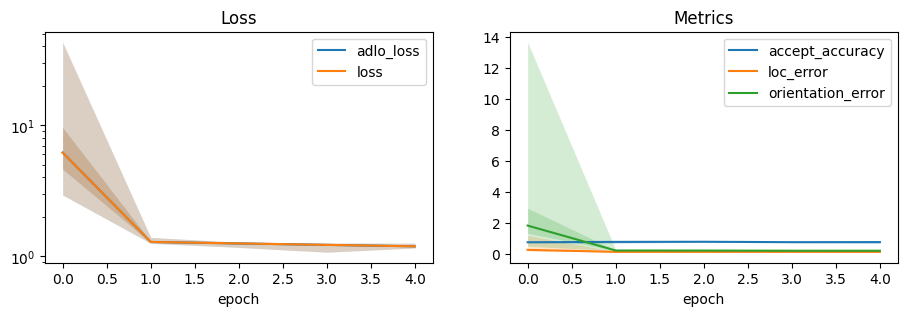

In [ ]:
tot.plot_train_history(model_history)

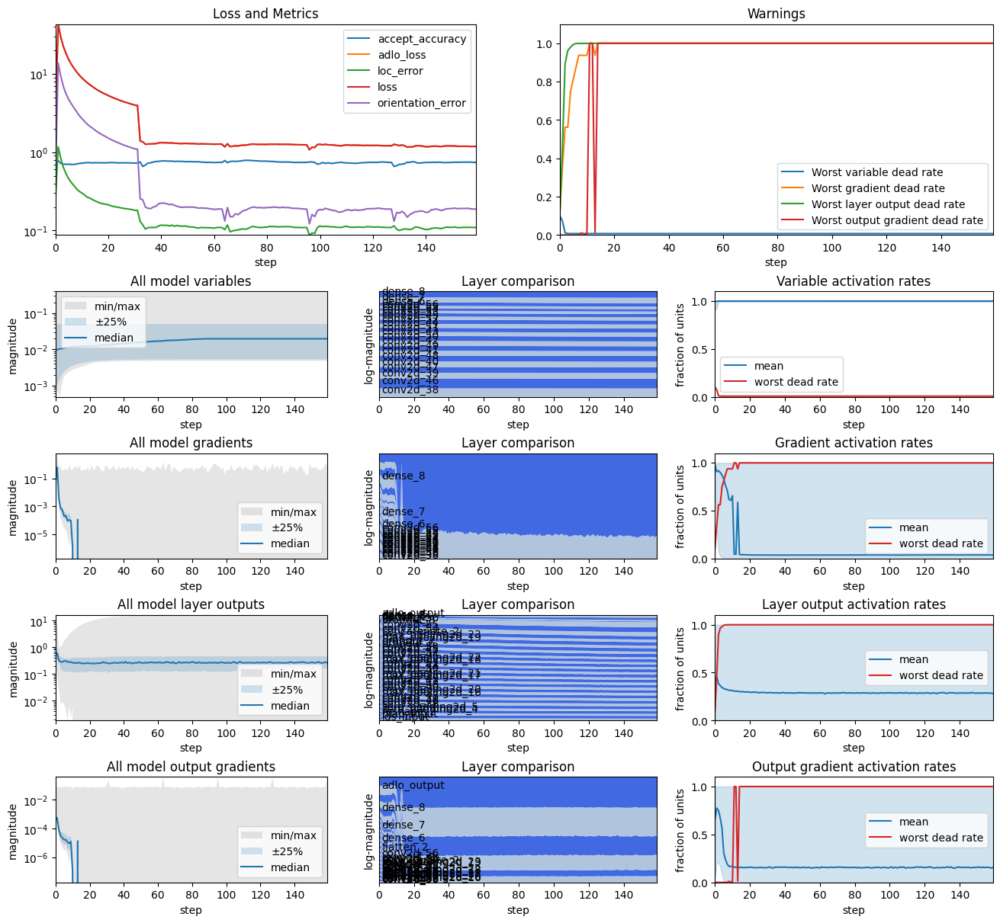

In [ ]:
tot.plot_history_overview([variables, outputs, gradients, output_gradients, model_history])

In [ ]:
# Check layer numbers and names
model.summary()

Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ lds_input (InputLayer)    │ (None, 149, 149)       │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ map_input (InputLayer)    │ (None, 149, 149, 3)    │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ reshape_2 (Reshape)       │ (None, 149, 149, 1)    │              0 │ lds_input[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ zero_padding2d_4          │ (None, 160, 160, 3)    │              0 │ map_input[0][0]        │
│ (ZeroPadding2D)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ zero_padding2d_5          │ (None, 160, 160, 1)    │              0 │ reshape_2[0][0]        │
│ (ZeroPadding2D)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_38 (Conv2D)        │ (None, 160, 160, 32)   │            896 │ zero_padding2d_4[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_46 (Conv2D)        │ (None, 160, 160, 32)   │            320 │ zero_padding2d_5[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_39 (Conv2D)        │ (None, 160, 160, 32)   │          9,248 │ conv2d_38[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_47 (Conv2D)        │ (None, 160, 160, 32)   │          9,248 │ conv2d_46[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_16          │ (None, 80, 80, 32)     │              0 │ conv2d_39[0][0]        │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_20          │ (None, 80, 80, 32)     │              0 │ conv2d_47[0][0]        │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_40 (Conv2D)        │ (None, 80, 80, 64)     │         18,496 │ max_pooling2d_16[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_48 (Conv2D)        │ (None, 80, 80, 64)     │         18,496 │ max_pooling2d_20[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_41 (Conv2D)        │ (None, 80, 80, 64)     │         36,928 │ conv2d_40[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_49 (Conv2D)        │ (None, 80, 80, 64)     │         36,928 │ conv2d_48[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_17          │ (None, 40, 40, 64)     │              0 │ conv2d_41[0][0]        │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_21          │ (None, 40, 40, 64)     │              0 │ conv2d_49[0][0]        │
│ (MaxPooling2D)       

 Total params: 22,841,918 (87.14 MB)

 Trainable params: 7,613,972 (29.04 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 15,227,946 (58.09 MB)

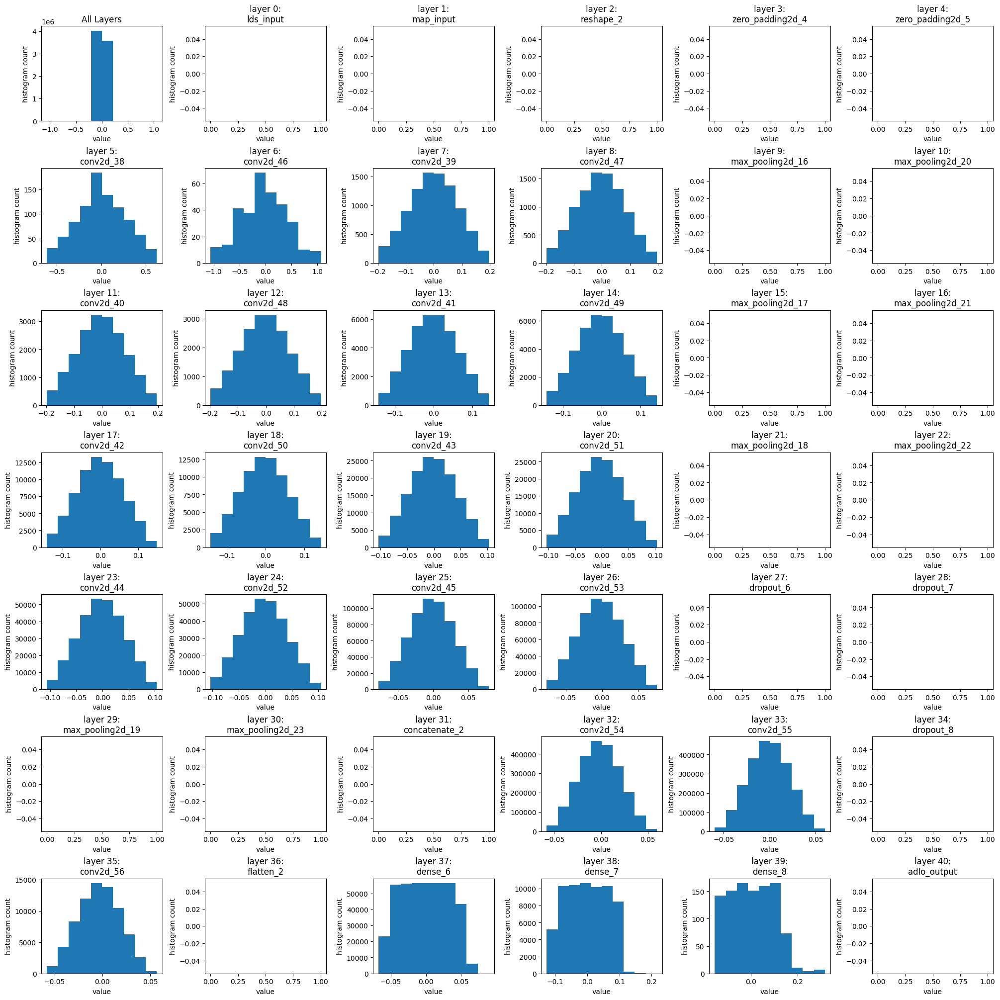

In [ ]:
# What do the trained model weights looked like?
plot_weights(model, all_layers=True)

In [ ]:
# and spatial activations after training
model_stats, layer_stats, layer_channel_activity, layer_spatial_activity = tot.measure_unit_activity(model, model_train_data, include_channel_activity=True, include_spatial_activity=True, verbose=1)
print(f"model_stats: {model_stats}")
print(f"layer_stats: {layer_stats}")

100%|██████████| 32/32 [00:04<00:00,  7.67it/s]

model_stats: {'min_dead_rate': 0.0, 'max_dead_rate': 1.0, 'mean_dead_rate': 0.24885670731707318, 'min_activation_rate': 0.0, 'max_activation_rate': 1.0, 'mean_activation_rate': 0.29282707}
layer_stats: [{'dead_rate': 0.0, 'activation_rate': 0.009289241}, {'dead_rate': 0.0, 'activation_rate': 0.7845485}, {'dead_rate': 0.0, 'activation_rate': 0.009289243}, {'dead_rate': 0.0, 'activation_rate': 0.6803813}, {'dead_rate': 0.0, 'activation_rate': 0.008055878}, {'dead_rate': 0.0, 'activation_rate': 0.4297538}, {'dead_rate': 0.0, 'activation_rate': 0.19737656}, {'dead_rate': 0.0, 'activation_rate': 0.47986406}, {'dead_rate': 0.0, 'activation_rate': 0.19739494}, {'dead_rate': 0.0, 'activation_rate': 0.5092787}, {'dead_rate': 0.0, 'activation_rate': 0.22201057}, {'dead_rate': 0.0, 'activation_rate': 0.30418393}, {'dead_rate': 0.0, 'activation_rate': 0.21981966}, {'dead_rate': 0.0, 'activation_rate': 0.3901527}, {'dead_rate': 0.0, 'activation_rate': 0.25242046}, {'dead_rate': 0.0, 'activation_rat

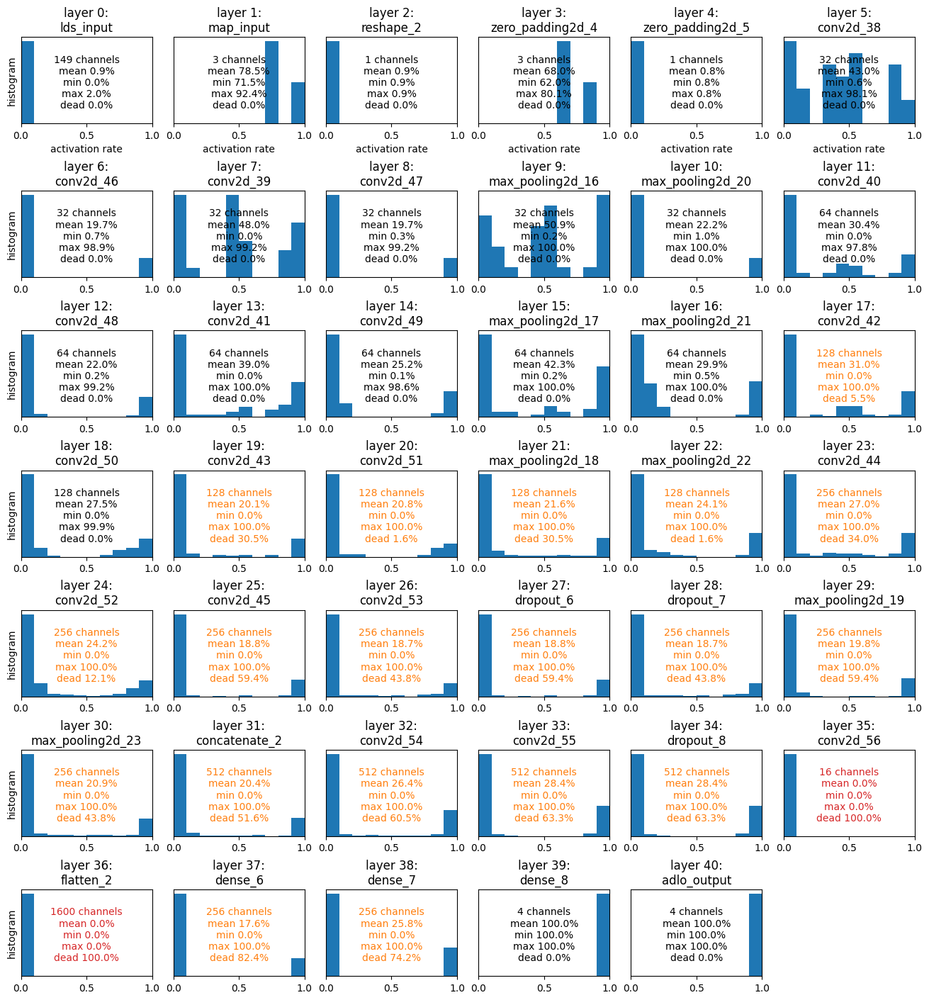

In [ ]:
tot.plot_channel_stats(layer_channel_activity, model)

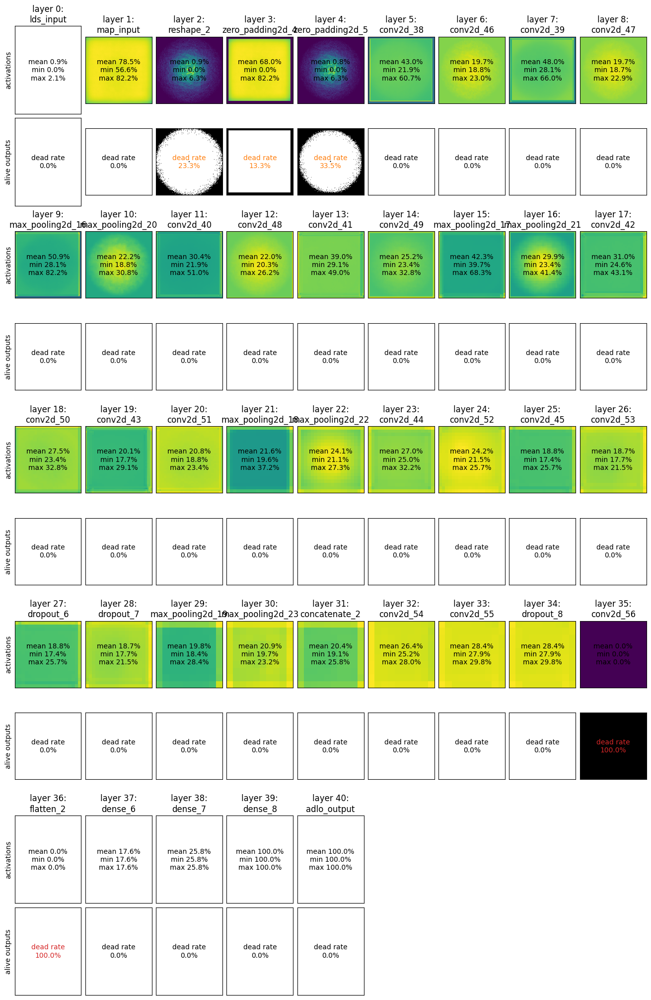

In [ ]:
tot.plot_spatial_stats(layer_spatial_activity, model)

Something's very off with the activation rates in layer 35.
Curiously it shows up when you look at both the channel and spatial dimensions.
Let's sanity check if there's anything obvious with the weights for that layer, but looking at those weights across different axis.

In [ ]:
l_idx = 35
print(f"layer {l_idx}: {model.layers[l_idx].name}")
print(f"layer weights: {model.layers[l_idx].weights[0].shape}")
print(f"layer biases: {model.layers[l_idx].weights[1].numpy()}")


layer 35: conv2d_56
layer weights: (3, 3, 512, 16)
layer biases: [-0.00347327 -0.00621532 -0.00838198 -0.00772878 -0.00747885 -0.00600543
 -0.0059444  -0.00430853 -0.00390466 -0.00602953 -0.00272465 -0.0033771
 -0.00600543 -0.0060054  -0.00433322 -0.00600543]


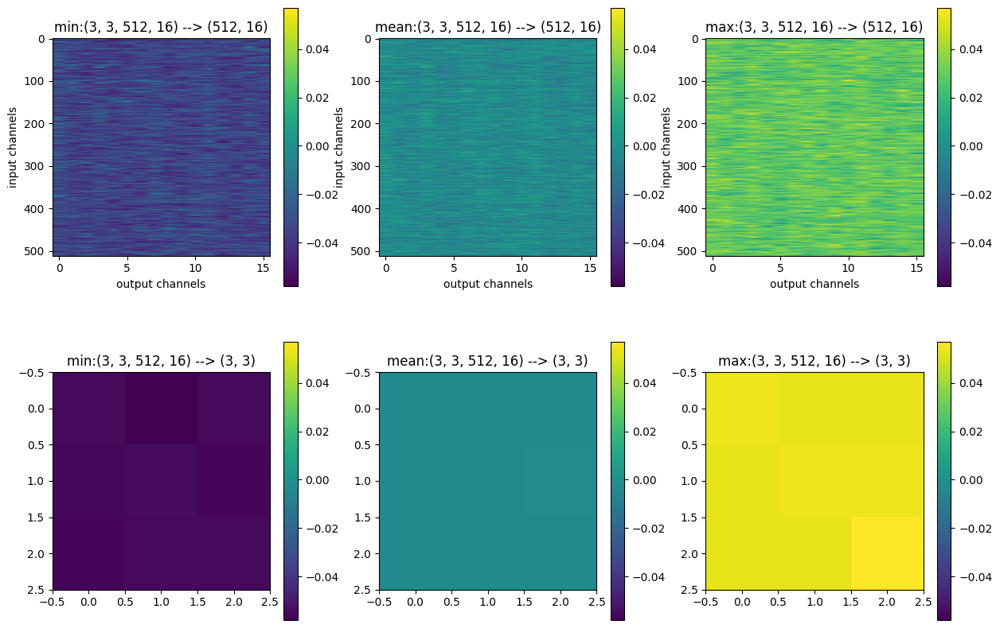

In [ ]:
w = model.layers[l_idx].weights[0]
plot_conv_layer_values(w)

## Deeper Investigation
The problem doesn't seem to be with the weights _per se_.

There's something really interesting happening within the 20 steps, so let's narrow in on that.


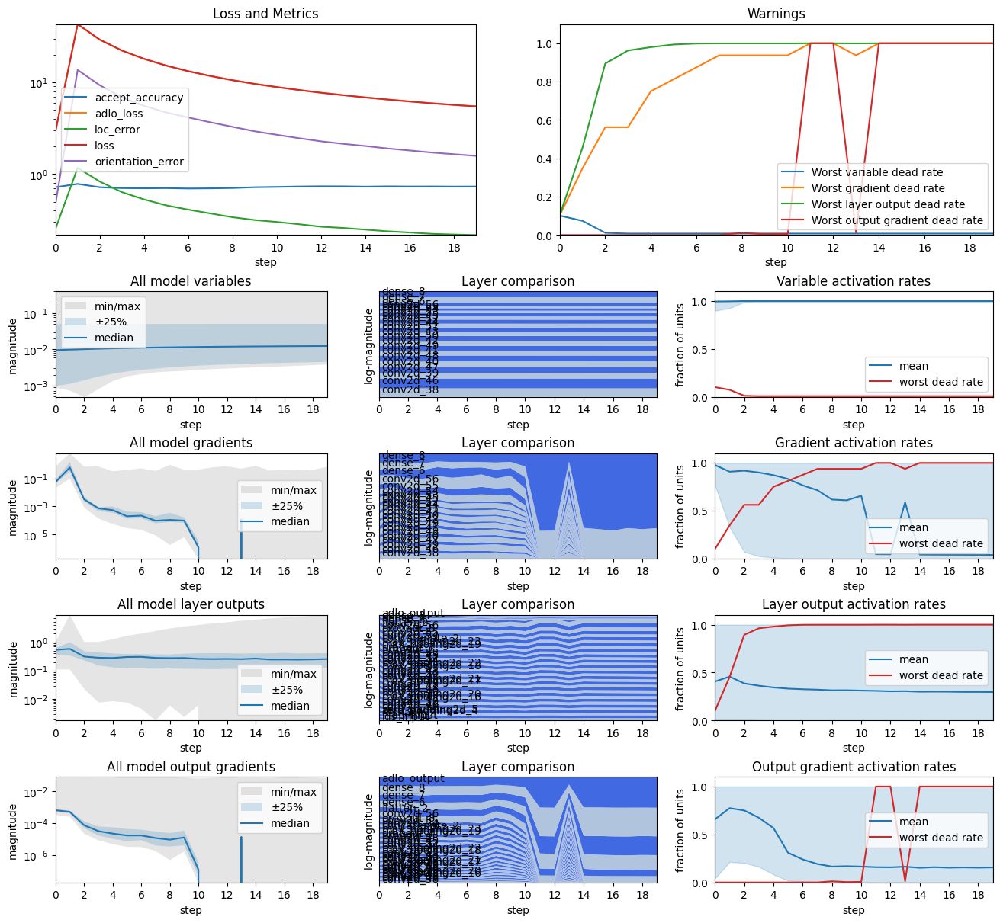

In [ ]:
tot.plot_history_overview([variables, outputs, gradients, output_gradients, model_history], iterations=slice(0, 20))

The areas that have the biggest problem, appearing the earliest are, worst first:

* layer output dead rate
* gradient dead rate

Let's look more closely

/usr/local/lib/python3.11/dist-packages/matplotlib/cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
/usr/local/lib/python3.11/dist-packages/matplotlib/cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


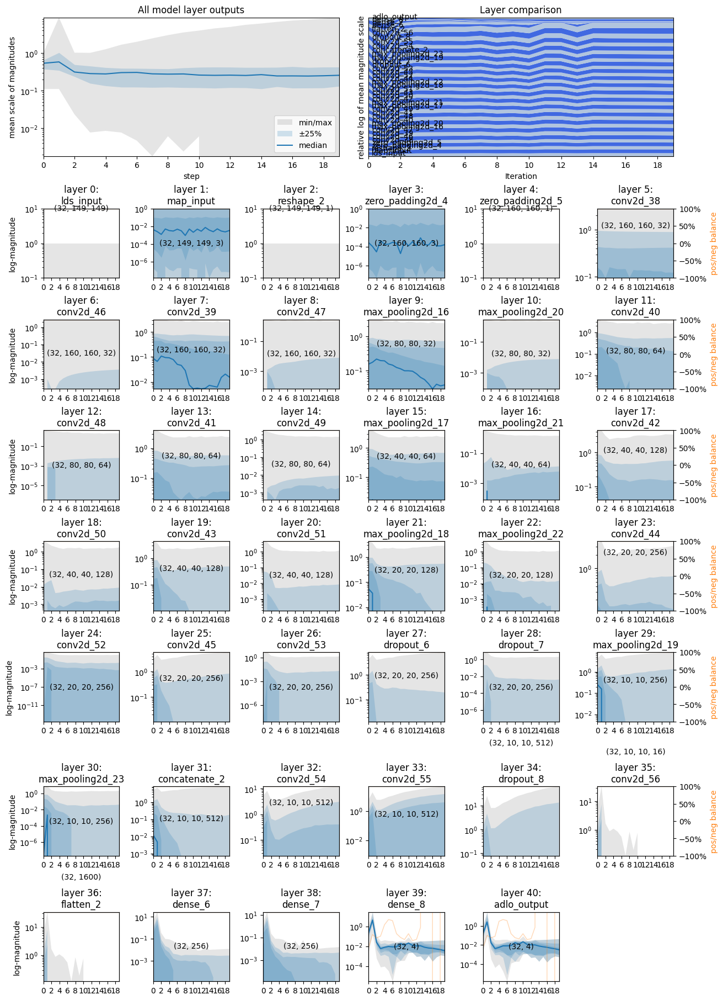

In [ ]:
tot.plot_value_history(outputs, iterations=slice(0,20))

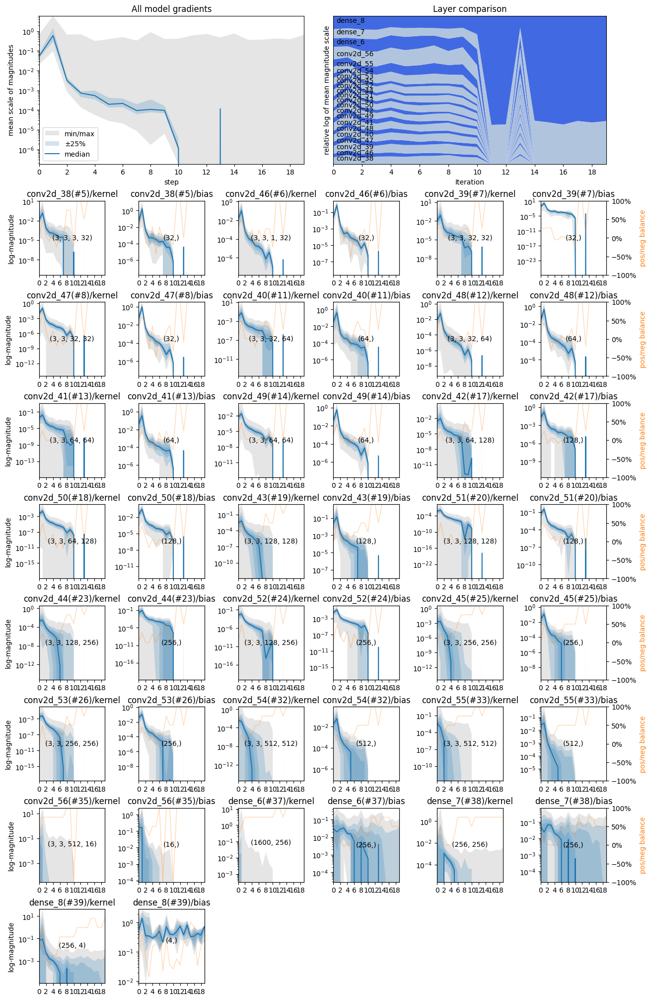

In [ ]:
tot.plot_value_history(gradients, iterations=slice(0,20))

The value plots for layer output activations shows that the median is hitting zero, but it retains some non-zero values.
However the gradients are all hitting zero, hard.

Let's look more directly at the activation and dead rates.

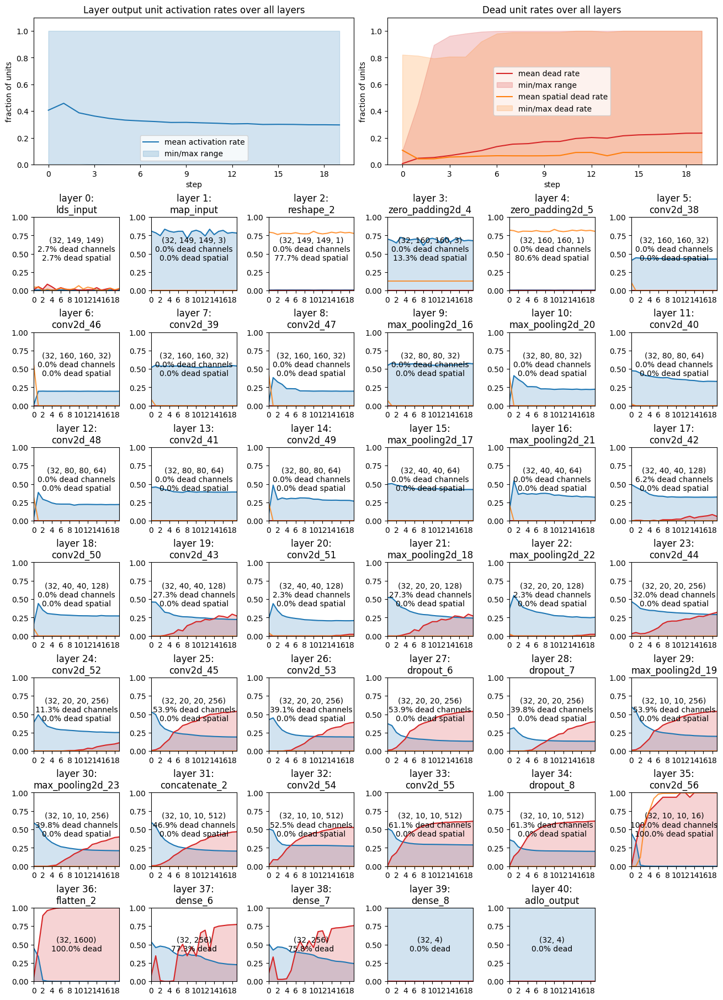

In [ ]:
tot.plot_activity_history(outputs, iterations=slice(0,20))

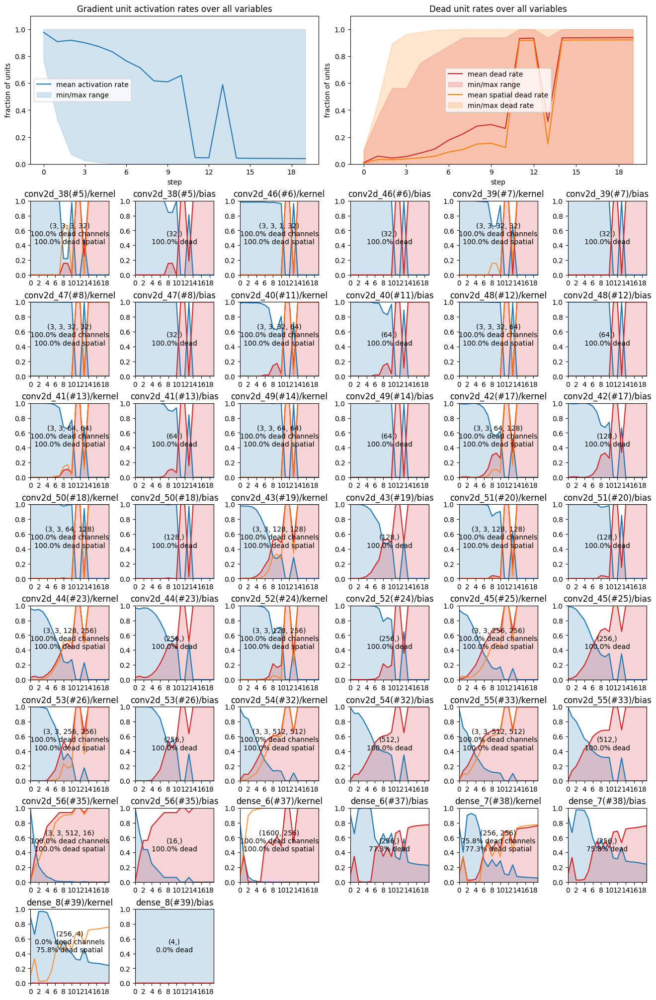

In [ ]:
tot.plot_activity_history(gradients, iterations=slice(0,20))

## Near-zero Gradients Explainer: Layer 35
It's still hard to tell from this what's going on.
Layer 35 seems to be the one that gets hit the hardest and fastest the earliest on, so let's target that as the possible underlying cause.
That hits in at iteration 0 or 1, so let's run some diagnostics.

To do that, we'll need to run training again, this time collecting raw data for that layer. We'll only need to collect data for the first epoch though.

We'll also capture data around layer 17 (with layer 15 as input), because it exhibits some outlier behaviour relative to its surroundings too.

In [ ]:
reload(slam_models)
reload(tot)
np.random.seed(42)
tf.random.set_seed(42)
epochs = 1
batch_size = 32
tf.config.run_functions_eagerly(False)
map_shape = next(iter(train_data))[0][0].shape
model_train_data = train_data.map(for_adlo_training)\
  .shuffle(buffer_size=len(train_data))\
  .batch(batch_size)\
  .prefetch(tf.data.experimental.AUTOTUNE)
model = adlo_model(map_shape, compile=True)

per_step=True
collection_sets=[{'layer_indices': [15, 17, 34, 35]}]
variables = tot.VariableHistoryCallback(per_step=per_step, before_updates=True, collection_sets=collection_sets)
outputs = tot.LayerOutputHistoryCallback(per_step=per_step, collection_sets=collection_sets)
gradients = tot.GradientHistoryCallback(per_step=per_step, collection_sets=collection_sets)
output_gradients = tot.LayerOutputGradientHistoryCallback(per_step=per_step, collection_sets=collection_sets)

model_history = tot.fit(model, model_train_data, epochs=epochs, callbacks=[variables, outputs, gradients, output_gradients, tot.HistoryStats(per_step=per_step)])

Prepared SLAM model
  Map shape:        (149, 149, 3) + padding (11, 11, 0)
  Skip-connections: concat
  Output scaling:   logits
  DLO encoding:     linear/importance
  Layers:           41
  Inputs:           [<KerasTensor shape=(None, 149, 149, 3), dtype=float32, sparse=False, name=map_input>, <KerasTensor shape=(None, 149, 149), dtype=float32, sparse=False, name=lds_input>]
  Outputs:          [<KerasTensor shape=(None, 4), dtype=float32, sparse=False, name=keras_tensor_233>]
  Output names:     ListWrapper(['adlo_output'])
  Compiled:         True
[on_train_begin]: values=['0=(3, 3, 3, 32)', '1=(32,)', '2=(3, 3, 1, 32)', '3=(32,)', '4=(3, 3, 32, 32)', '5=(32,)', '6=(3, 3, 32, 32)', '7=(32,)', '8=(3, 3, 32, 64)', '9=(64,)', '10=(3, 3, 32, 64)', '11=(64,)', '12=(3, 3, 64, 64)', '13=(64,)', '14=(3, 3, 64, 64)', '15=(64,)', '16=(3, 3, 64, 128)', '17=(128,)', '18=(3, 3, 64, 128)', '19=(128,)', '20=(3, 3, 128, 128)', '21=(128,)', '22=(3, 3, 128, 128)', '23=(128,)', '24=(3, 3, 128, 256)'

In [ ]:
reload(te)
te.explain_near_zero_gradients(callbacks=[variables, gradients, outputs, output_gradients], layer_index=35, step=0)

layer: #35 = <Conv2D name=conv2d_113, built=True> at iteration 0
  inbound_layer_indices: [34]
  outbound_layer_indices: [36]

Summary...
  near-zero gradients: 2594 (3.5%) = 0

Let:
  A_0      <- input activation to target layer
  W_l      <- weights of target layer
  Z_l      <- pre-activation output of target layer
  S_l      <- effect of activation function as element-wise multiplier
  A_l      <- output activation of target layer

Forward pass...
A_0 - input value:
  shape:             (32, 10, 10, 512) -> total values: 1638400
  summary:           66.6% near-zero
W_l - weights of target layer:
  shape:             (3, 3, 512, 16) -> total values: 73728
  summary:           1.0% near-zero
  corresponding to near-zero gradients: 0.7% near-zero
compute Z_l = A_0 conv W_l + b_l:
  inputs examined:   A_0, W_l
  summary:           1.0% near-zero
Z_l - pre-activation output:
  shape:             (32, 10, 10, 16) -> total values: 51200
  summary:           56.5% negative
S_l - activation

In [ ]:
te.explain_near_zero_gradients(callbacks=[variables, gradients, outputs, output_gradients], layer_index=35, step=1)

layer: #35 = <Conv2D name=conv2d_113, built=True> at iteration 1
  inbound_layer_indices: [34]
  outbound_layer_indices: [36]

Summary...
  near-zero gradients: 24798 (33.6%) = 0

Let:
  A_0      <- input activation to target layer
  W_l      <- weights of target layer
  Z_l      <- pre-activation output of target layer
  S_l      <- effect of activation function as element-wise multiplier
  A_l      <- output activation of target layer

Forward pass...
A_0 - input value:
  shape:             (32, 10, 10, 512) -> total values: 1638400
  summary:           67.0% near-zero, 11.1% of units always near-zero across all batch and spatial dims
W_l - weights of target layer:
  shape:             (3, 3, 512, 16) -> total values: 73728
  summary:           1.0% near-zero
  corresponding to near-zero gradients: 1.0% near-zero
compute Z_l = A_0 conv W_l + b_l:
  inputs examined:   A_0, W_l
  summary:           1.0% near-zero
Z_l - pre-activation output:
  shape:             (32, 10, 10, 16) -> tot

In [ ]:
te.explain_near_zero_gradients(callbacks=[variables, gradients, outputs, output_gradients], layer_index=35, step=2)

layer: #35 = <Conv2D name=conv2d_113, built=True> at iteration 2
  inbound_layer_indices: [34]
  outbound_layer_indices: [36]

Summary...
  near-zero gradients: 51389 (69.7%) = 0

Let:
  A_0      <- input activation to target layer
  W_l      <- weights of target layer
  Z_l      <- pre-activation output of target layer
  S_l      <- effect of activation function as element-wise multiplier
  A_l      <- output activation of target layer

Forward pass...
A_0 - input value:
  shape:             (32, 10, 10, 512) -> total values: 1638400
  summary:           73.0% near-zero, 20.3% of units always near-zero across all batch and spatial dims
W_l - weights of target layer:
  shape:             (3, 3, 512, 16) -> total values: 73728
  summary:           1.0% near-zero
  corresponding to near-zero gradients: 1.0% near-zero
compute Z_l = A_0 conv W_l + b_l:
  inputs examined:   A_0, W_l
  summary:           1.0% near-zero
Z_l - pre-activation output:
  shape:             (32, 10, 10, 16) -> tot

In [ ]:
te.explain_near_zero_gradients(callbacks=[variables, gradients, outputs, output_gradients], layer_index=35, step=0, verbose=True)

layer: #35 = <Conv2D name=conv2d_113, built=True> at iteration 0
  inbound_layer_indices: [34]
  outbound_layer_indices: [36]

Summary...
  near-zero gradients: 2594 (3.5%) = 0

Let:
  A_0      <- input activation to target layer
  W_l      <- weights of target layer
  Z_l      <- pre-activation output of target layer
  S_l      <- effect of activation function as element-wise multiplier
  A_l      <- output activation of target layer
  PZN      <- breakdown of values into (P)ositive, near-(Z)ero, or (N)egative
  x . y    <- matmul (aka dot product)
  x (.) y  <- element-wise multiply

Forward pass...
A_0 - input value:
  shape:             (32, 10, 10, 512) -> total values: 1638400
  summary:           66.6% near-zero (= 0), 0.8% of units always near-zero across all batch and spatial dims
  value percentiles: [0, 25, 50, 75, 100] -> [0.        0.        0.        0.4937087 9.419615 ]
  PZN counts/sums:   Z: 1091940.0 = Σ 0, P: 546460.0 = Σ 738004
  PZN counts/means:  Z: 66.6% x 0.000,

In [ ]:
te.explain_near_zero_gradients(callbacks=[variables, gradients, outputs, output_gradients], layer_index=35, step=2, verbose=True)

layer: #35 = <Conv2D name=conv2d_113, built=True> at iteration 2
  inbound_layer_indices: [34]
  outbound_layer_indices: [36]

Summary...
  near-zero gradients: 51389 (69.7%) = 0

Let:
  A_0      <- input activation to target layer
  W_l      <- weights of target layer
  Z_l      <- pre-activation output of target layer
  S_l      <- effect of activation function as element-wise multiplier
  A_l      <- output activation of target layer
  PZN      <- breakdown of values into (P)ositive, near-(Z)ero, or (N)egative
  x . y    <- matmul (aka dot product)
  x (.) y  <- element-wise multiply

Forward pass...
A_0 - input value:
  shape:             (32, 10, 10, 512) -> total values: 1638400
  summary:           73.0% near-zero (= 0), 20.3% of units always near-zero across all batch and spatial dims
  value percentiles: [0, 25, 50, 75, 100] -> [ 0.          0.          0.          0.23311232 16.622566  ]
  PZN counts/sums:   Z: 1195827.0 = Σ 0, P: 442573.0 = Σ 1120120
  PZN counts/means:  Z: 

In [ ]:
te.explain_near_zero_gradients(callbacks=[variables, gradients, outputs, output_gradients], layer_index=35, step=3, verbose=True)

layer: #35 = <Conv2D name=conv2d_113, built=True> at iteration 3
  inbound_layer_indices: [34]
  outbound_layer_indices: [36]

Summary...
  near-zero gradients: 61787 (83.8%) = 0

Let:
  A_0      <- input activation to target layer
  W_l      <- weights of target layer
  Z_l      <- pre-activation output of target layer
  S_l      <- effect of activation function as element-wise multiplier
  A_l      <- output activation of target layer
  PZN      <- breakdown of values into (P)ositive, near-(Z)ero, or (N)egative
  x . y    <- matmul (aka dot product)
  x (.) y  <- element-wise multiply

Forward pass...
A_0 - input value:
  shape:             (32, 10, 10, 512) -> total values: 1638400
  summary:           75.6% near-zero (= 0), 29.9% of units always near-zero across all batch and spatial dims
  value percentiles: [0, 25, 50, 75, 100] -> [ 0.        0.        0.        0.       11.986693]
  PZN counts/sums:   Z: 1238284.0 = Σ 0, P: 400116.0 = Σ 856122
  PZN counts/means:  Z: 75.6% x 0.0

`A_0` is increasing in its amount of zero:
* At step 0 it looks fairly innocuous, it's close to 50% overall, but < 1% of units are always zero across all spatial dims.
* At step 1 it's at 67% overall near-zero.
* At step 2 that's now 76% overall, and 30% of units are dead for all spatial dims.

`Z_1` is increasingly negative:
* At step 0 it's sitting at 57% negative overall, and no dead units.
* At step 1 it's at 69% negative overall
* At step 2 it's at 97% negative overall, with 31% dead units.

The biggest factors as we move through the steps are:
* step 0:
  * 57% of `Z_1` negative, but not particularly alarming because no units are always zero or negative.
  * 67% of `A_0` near zero, but not particularly alarming because < 1% of units are dead.
* step 1:
  * 69% of `Z_1` negative, with 12.5% units always zero or negative
  * 67% of `A_0` near zero, with 11% units always zero.
* step 2:
  * 97% of `Z_1` negative, with 31% units always zero or negative
  * 73% of `A_0` near zero, with 20% units always zero.
* step 3:
  * 99.6% of `Z_1` negative, with 75% units always zero or negative
  * 76% of `A_0` near zero, with 30% units always zero.

Conclusions so far:
* The problem kicks in immediately, upon the very first batch update.
* The problem must surely be the loss function.
* I know that it ultimately results in constant values at least one of its outputs after 5 epochs.
* Maybe it's pushing for constant values on everything.
* It's like it's trying to achieve that by making all the internal pre-activations as negative as possible, that way the activations become zero, and only the bias has any effect on the outcome.


## Near-zero Gradients Explainer: Layer 17
Let's look at layer 17, just in case it's helpful.

In [ ]:
te.explain_near_zero_gradients(callbacks=[variables, gradients, outputs, output_gradients], layer_index=17, step=0)

layer: #17 = <Conv2D name=conv2d_99, built=True> at iteration 0
  inbound_layer_indices: [15]
  outbound_layer_indices: [19]

Summary...
  near-zero gradients: 922 (1.3%) = 0

Let:
  A_0      <- input activation to target layer
  W_l      <- weights of target layer
  Z_l      <- pre-activation output of target layer
  S_l      <- effect of activation function as element-wise multiplier
  A_l      <- output activation of target layer

Forward pass...
A_0 - input value:
  shape:             (32, 40, 40, 64) -> total values: 3276800
  summary:           42.8% near-zero
W_l - weights of target layer:
  shape:             (3, 3, 64, 128) -> total values: 73728
  summary:           1.0% near-zero
  corresponding to near-zero gradients: 1.1% near-zero
compute Z_l = A_0 conv W_l + b_l:
  inputs examined:   A_0, W_l
  summary:           1.0% near-zero
Z_l - pre-activation output:
  shape:             (32, 40, 40, 128) -> total values: 6553600
  summary:           47.8% negative
S_l - activation

In [ ]:
te.explain_near_zero_gradients(callbacks=[variables, gradients, outputs, output_gradients], layer_index=17, step=1)

layer: #17 = <Conv2D name=conv2d_99, built=True> at iteration 1
  inbound_layer_indices: [15]
  outbound_layer_indices: [19]

Summary...
  near-zero gradients: 1968 (2.7%) = 0

Let:
  A_0      <- input activation to target layer
  W_l      <- weights of target layer
  Z_l      <- pre-activation output of target layer
  S_l      <- effect of activation function as element-wise multiplier
  A_l      <- output activation of target layer

Forward pass...
A_0 - input value:
  shape:             (32, 40, 40, 64) -> total values: 3276800
  summary:           44.2% near-zero
W_l - weights of target layer:
  shape:             (3, 3, 64, 128) -> total values: 73728
  summary:           1.0% near-zero
  corresponding to near-zero gradients: 1.1% near-zero
compute Z_l = A_0 conv W_l + b_l:
  inputs examined:   A_0, W_l
  summary:           1.0% near-zero
Z_l - pre-activation output:
  shape:             (32, 40, 40, 128) -> total values: 6553600
  summary:           50.6% negative, 2.3% of units 

In [ ]:
te.explain_near_zero_gradients(callbacks=[variables, gradients, outputs, output_gradients], layer_index=17, step=2)

layer: #17 = <Conv2D name=conv2d_99, built=True> at iteration 2
  inbound_layer_indices: [15]
  outbound_layer_indices: [19]

Summary...
  near-zero gradients: 1533 (2.1%) = 0

Let:
  A_0      <- input activation to target layer
  W_l      <- weights of target layer
  Z_l      <- pre-activation output of target layer
  S_l      <- effect of activation function as element-wise multiplier
  A_l      <- output activation of target layer

Forward pass...
A_0 - input value:
  shape:             (32, 40, 40, 64) -> total values: 3276800
  summary:           46.1% near-zero
W_l - weights of target layer:
  shape:             (3, 3, 64, 128) -> total values: 73728
  summary:           1.0% near-zero
  corresponding to near-zero gradients: 1.1% near-zero
compute Z_l = A_0 conv W_l + b_l:
  inputs examined:   A_0, W_l
  summary:           1.0% near-zero
Z_l - pre-activation output:
  shape:             (32, 40, 40, 128) -> total values: 6553600
  summary:           56.3% negative, 1.6% of units 

## Full Plots

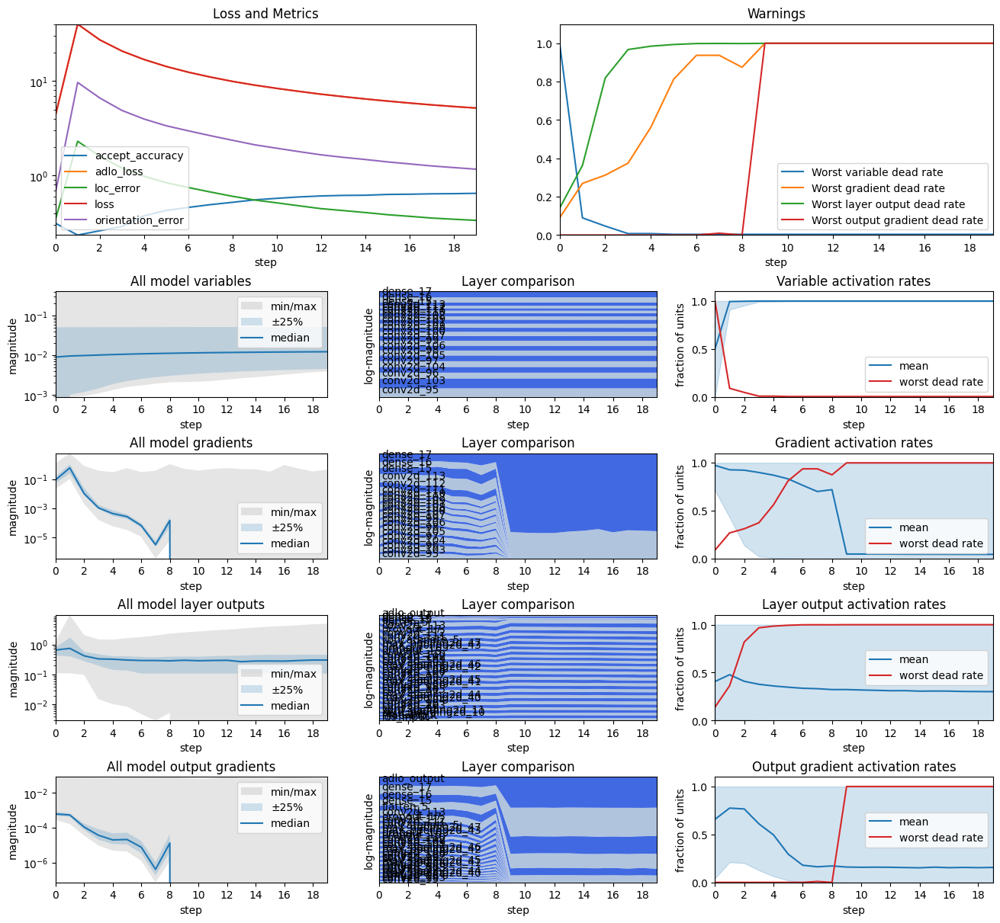

In [ ]:
tot.plot_history_overview([model_history, variables, gradients, outputs, output_gradients], iterations=slice(0,20))

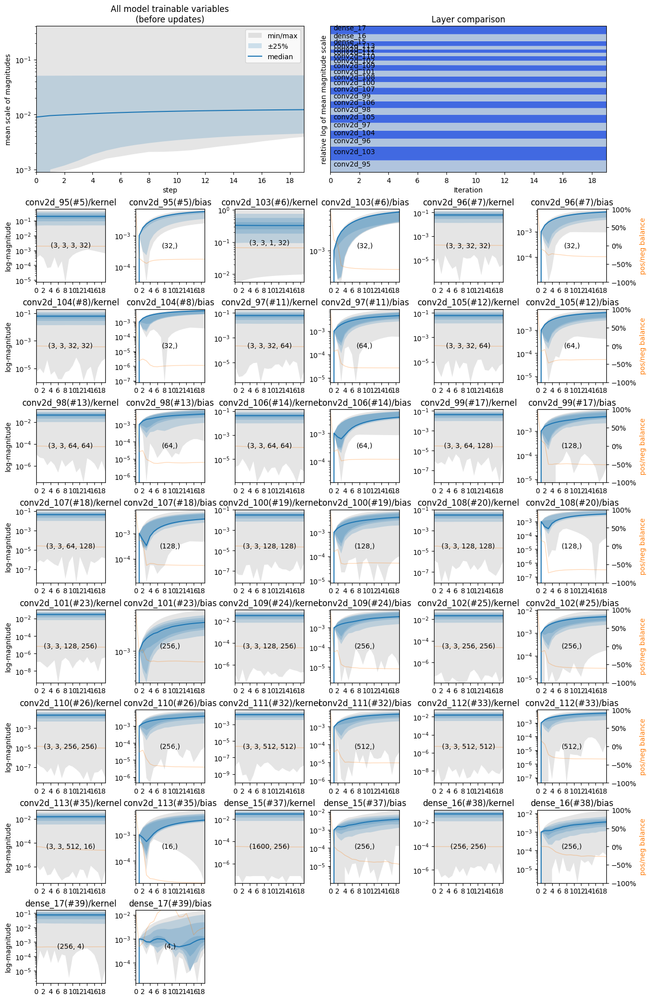

In [ ]:
tot.plot_value_history(variables, iterations=slice(0,20))

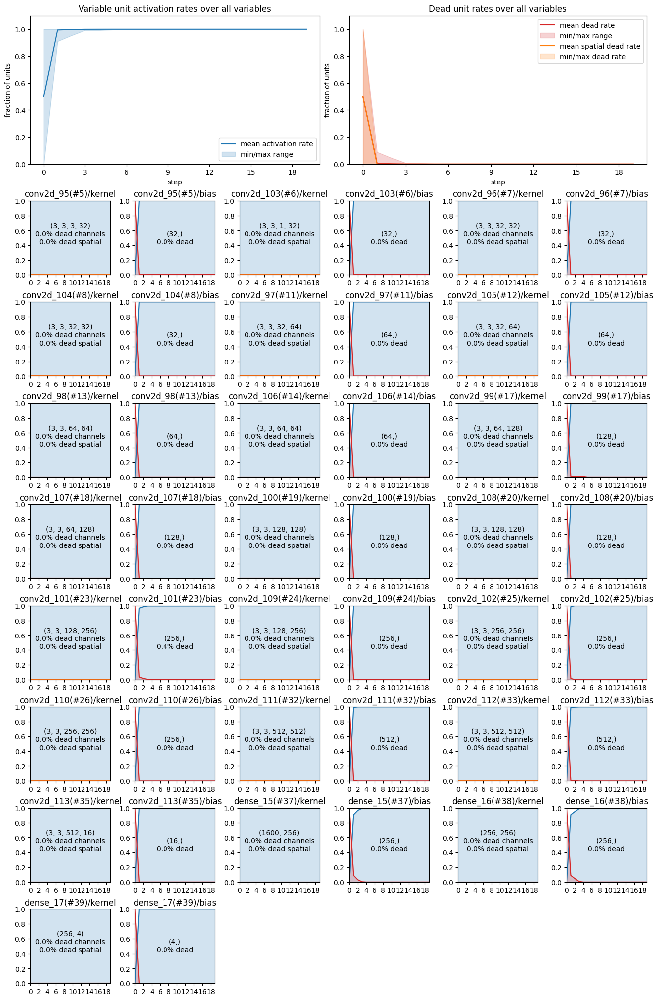

In [ ]:
tot.plot_activity_history(variables, iterations=slice(0,20))

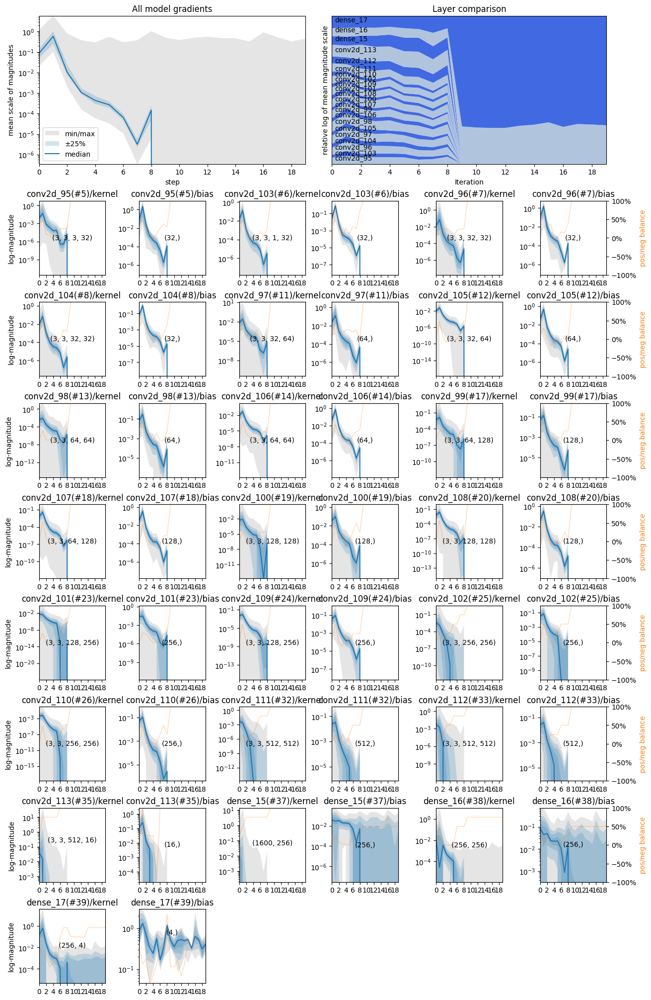

In [ ]:
tot.plot_value_history(gradients, iterations=slice(0,20))

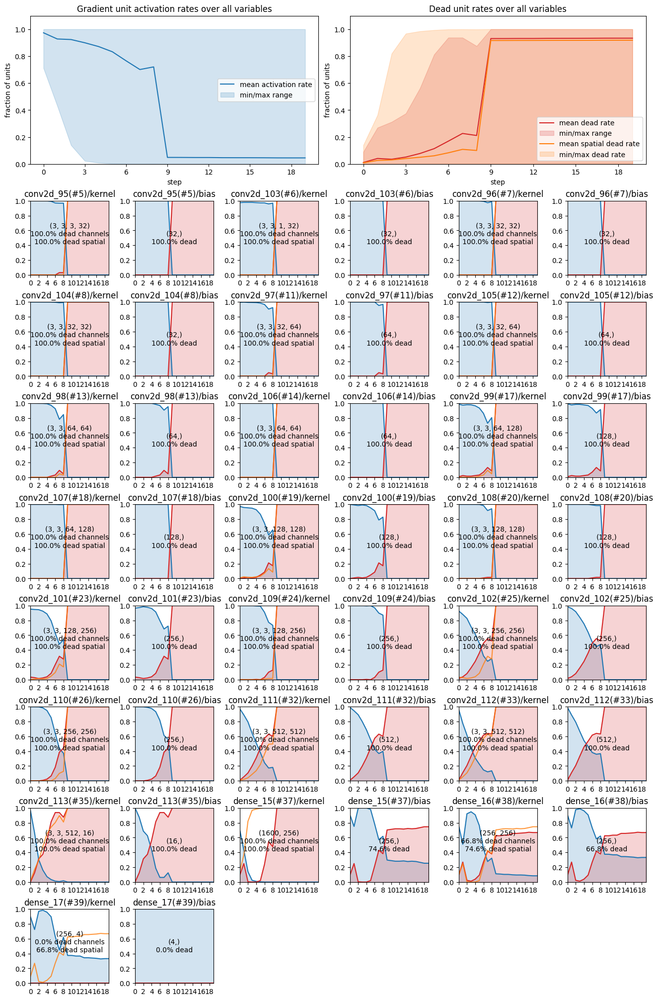

In [ ]:
tot.plot_activity_history(gradients, iterations=slice(0,20))

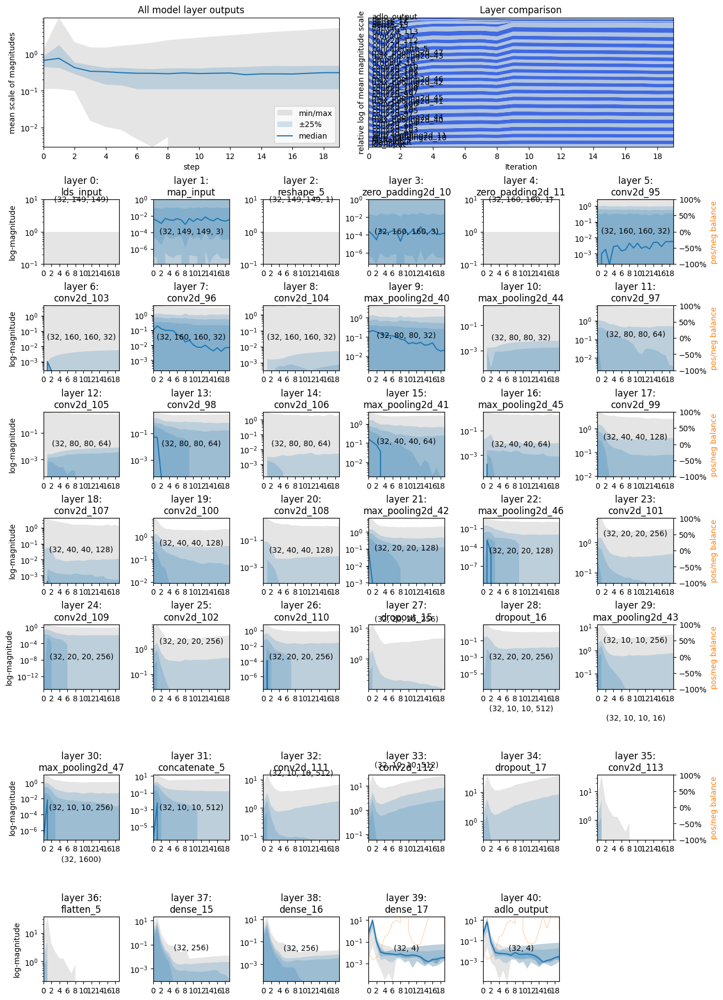

In [ ]:
tot.plot_value_history(outputs, iterations=slice(0,20))

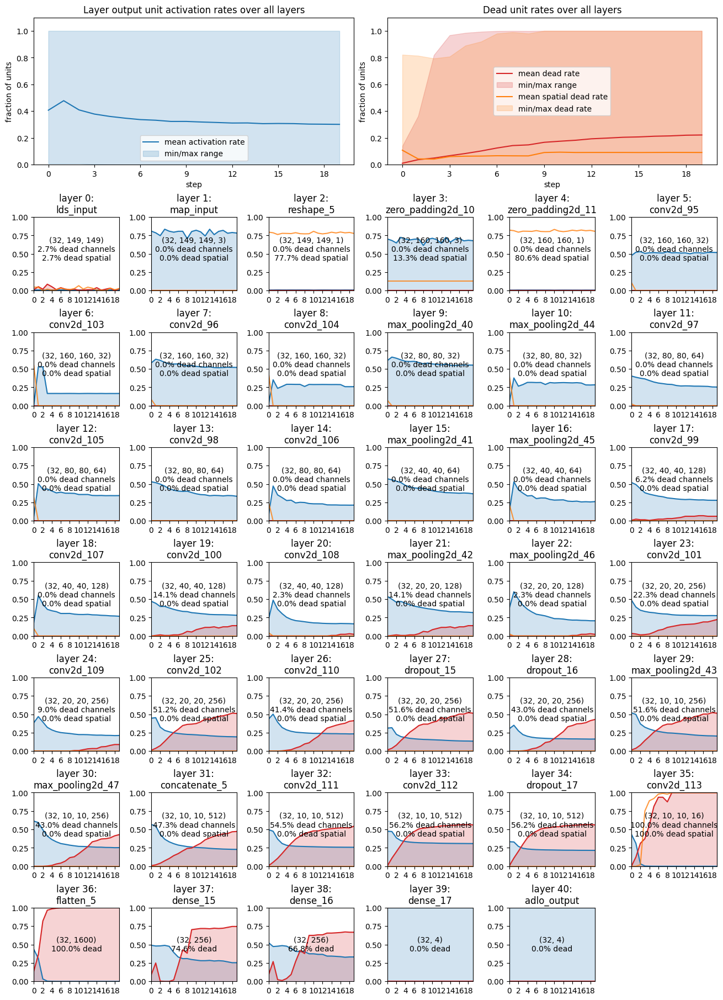

In [ ]:
tot.plot_activity_history(outputs, iterations=slice(0,20))

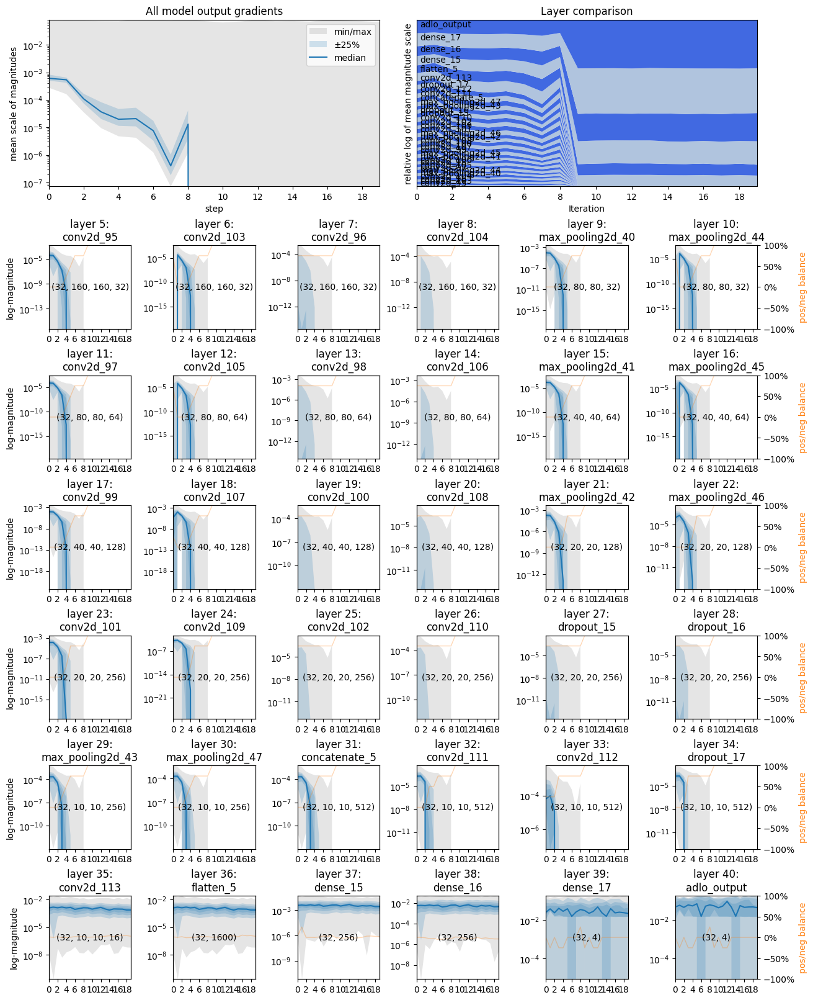

In [ ]:
tot.plot_value_history(output_gradients, iterations=slice(0,20))

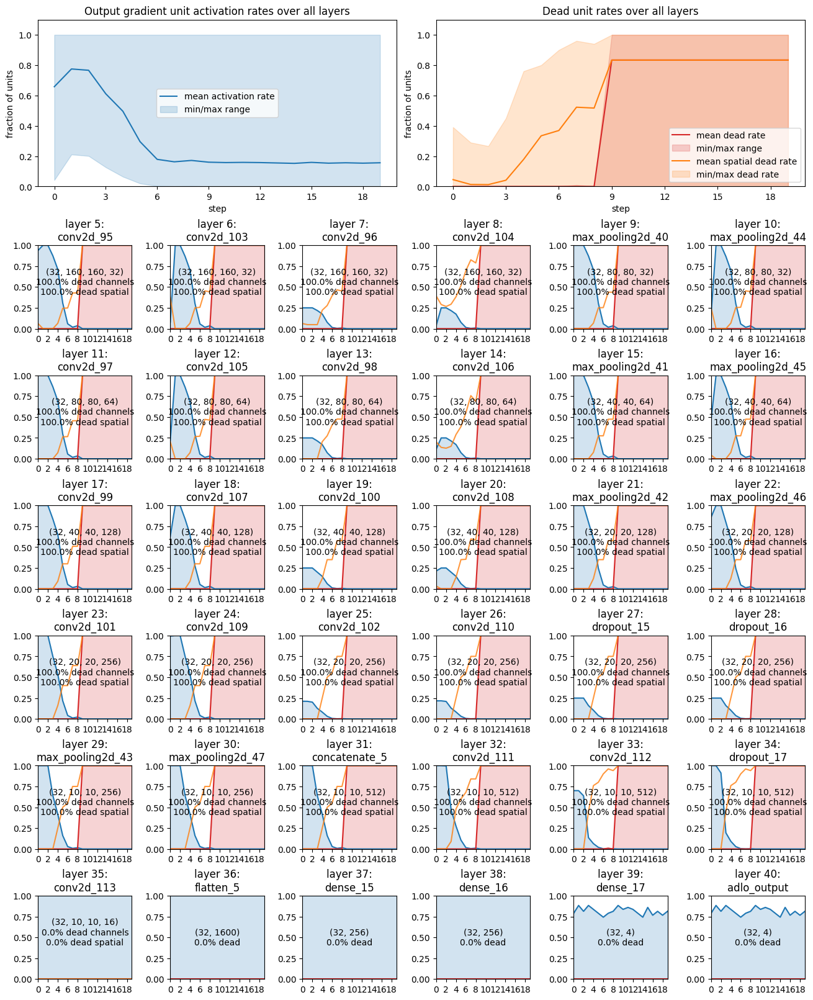

In [ ]:
tot.plot_activity_history(output_gradients, iterations=slice(0,20))

## Trial and Error
I still don't see an _exact_ explanation for the problem. But it seems to be in the vascinity of a couple of possible things:
* Layer 35 - the layer immediately afterwards is a `flatten()`, what if there's some bug in there that's causing issues?
* The loss function.

Other interesting things of note:
* the second conv of each block behaves quite differently to the first. Don't know what to make of that.

Things to try:
* remove all the dropout layers and double check.
* experiment with some alternative to the flatten() layer.
* investigate the loss function, perhaps with that scaling that I do.

Prepared SLAM model
  Map shape:        (149, 149, 3) + padding (11, 11, 0)
  Skip-connections: concat
  Output scaling:   logits
  DLO encoding:     linear/importance
  Layers:           38
  Inputs:           [<KerasTensor shape=(None, 149, 149, 3), dtype=float32, sparse=False, name=map_input>, <KerasTensor shape=(None, 149, 149), dtype=float32, sparse=False, name=lds_input>]
  Outputs:          [<KerasTensor shape=(None, 4), dtype=float32, sparse=False, name=keras_tensor_413>]
  Output names:     ListWrapper(['adlo_output'])
  Compiled:         True
Epoch 1/2
 1/32 ━━━━━━━━━━━━━━━━━━━━ 6:02 12s/step - accept_accuracy: 0.2812 - adlo_loss: 2.8295 - loc_error: 0.2766 - loss: 2.8295 - orientation_error: 0.2904

32/32 ━━━━━━━━━━━━━━━━━━━━ 59s 2s/step - accept_accuracy: 0.6381 - adlo_loss: 6.0706 - loc_error: 0.4735 - loss: 6.0726 - orientation_error: 1.1545
Epoch 2/2
32/32 ━━━━━━━━━━━━━━━━━━━━ 25s 784ms/step - accept_accuracy: 0.7480 - adlo_loss: 1.2860 - loc_error: 0.1121 - loss: 1.2868 - orientation_error: 0.2028


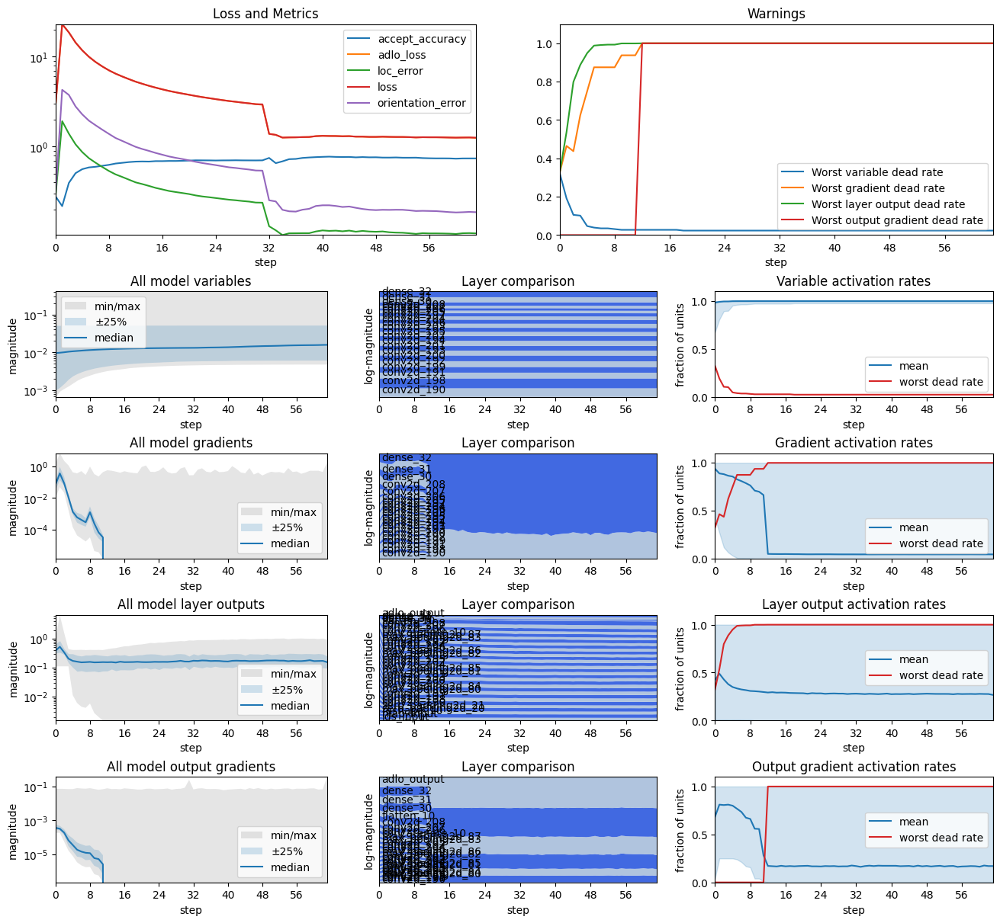

In [ ]:
# without dropout
def adlo_model(map_shape, conv_filters=32, adlo_units=256, **kwargs):
    merge_mode = kwargs.get('merge_mode', 'concat')
    output_logits = kwargs.get('output_logits', True)
    do_compile = kwargs.get('compile', False)
    dlo_encoding = kwargs.get('dlo_encoding', 'linear/importance')

    # Sanity check
    if np.size(map_shape) != 3:
        raise ValueError(f"Map shape must have 3 dims, found {np.size(map_shape)}")

    # Prepare map input
    # (pad so it's a multiple of our down/up-scaling blocks)
    map_input = Input(shape=map_shape, name='map_input')
    map_down, pad_w, pad_h = slam_models.pad_block(map_input, map_shape)
    n_classes = map_shape[2]

    # Prepare LDS input
    # (convert from (B,H,W) to (B,H,W,1) to make later work easier)
    # (pad so it's a multiple of our down/up-scaling blocks)
    lds_shape = (map_shape[0], map_shape[1], 1)
    lds_input = Input(shape=(map_shape[0], map_shape[1]), name='lds_input')  # raw input omits channels axis
    lds_down = tf.keras.layers.Reshape(target_shape=lds_shape)(lds_input)
    lds_down, _, _ = slam_models.pad_block(lds_down, lds_shape)

    # Map downsampling input arm
    # (each block here returns two outputs (downsampled, convolved-only),
    #  the latter is used for skip-connections)
    map_down, map_skip1 = slam_models.slam_down_block(map_down, conv_filters)
    map_down, map_skip2 = slam_models.slam_down_block(map_down, conv_filters * 2)
    map_down, map_skip3 = slam_models.slam_down_block(map_down, conv_filters * 4)
    map_down, map_skip4 = slam_models.slam_down_block(map_down, conv_filters * 8)

    # LDS downsampling input arm
    lds_down, lds_skip1 = slam_models.slam_down_block(lds_down, conv_filters)
    lds_down, lds_skip2 = slam_models.slam_down_block(lds_down, conv_filters * 2)
    lds_down, lds_skip3 = slam_models.slam_down_block(lds_down, conv_filters * 4)
    lds_down, lds_skip4 = slam_models.slam_down_block(lds_down, conv_filters * 8)

    # Bottom layer
    # (combine both input arms, apply some final convolutions, leave at same scale)
    bottom = Concatenate(axis=3)([map_down, lds_down])
    #bottom, _ = slam_models.slam_down_block(bottom, conv_filters * 16, max_pooling=False)
    #bottom, _ = slam_models.slam_down_block(bottom, conv_filters * 16, max_pooling=False)
    bottom, _ = slam_models.slam_down_block(bottom, conv_filters * 16, max_pooling=False)

    # Accept and Delta location/orientation output
    adlo_out = slam_models.adlo_block(bottom, adlo_units, output_logits, dlo_encoding)

    model = tf.keras.Model(inputs=[map_input, lds_input], outputs=[adlo_out])

    if do_compile:
        loss = (
            slam_models.ADLOLoss(from_logits=output_logits, dlo_encoding=dlo_encoding)
        )
        metrics = {
            'adlo_output': [slam_models.ADLOLoss(from_logits=output_logits, dlo_encoding=dlo_encoding),
                            slam_models.AcceptAccuracy(),
                            slam_models.LocationError(),
                            slam_models.OrientationError()]
        }
        model.compile(optimizer='adam', loss=loss, metrics=metrics)

    print(f"Prepared SLAM model")
    print(f"  Map shape:        {map_shape} + padding ({pad_h}, {pad_w}, 0)")
    print(f"  Skip-connections: {merge_mode}")
    print(f"  Output scaling:   {'logits' if output_logits else 'scaled'}")
    print(f"  DLO encoding:     {dlo_encoding}")
    print(f"  Layers:           {len(model.layers)}")
    print(f"  Inputs:           {model.inputs}")
    print(f"  Outputs:          {model.outputs}")
    print(f"  Output names:     {model.output_names}")
    print(f"  Compiled:         {do_compile}")
    return model

def for_adlo_training(inputs, outputs, metadata):
    (map_input, lds_input), (map_output, adlo_output) = inputs, outputs
    return (map_input, lds_input), adlo_output

reload(slam_models)
np.random.seed(42)
tf.random.set_seed(42)
epochs = 2
batch_size = 32
tf.config.run_functions_eagerly(False)
map_shape = next(iter(train_data))[0][0].shape
model_train_data = train_data.map(for_adlo_training)\
  .shuffle(buffer_size=len(train_data))\
  .batch(batch_size)\
  .prefetch(tf.data.experimental.AUTOTUNE)
model = adlo_model(map_shape, compile=True)

per_step=True
variables = tot.VariableHistoryCallback(per_step=per_step)
outputs = tot.LayerOutputHistoryCallback(per_step=per_step)
gradients = tot.GradientHistoryCallback(per_step=per_step)
output_gradients = tot.LayerOutputGradientHistoryCallback(per_step=per_step)
model_history = tot.fit(model, model_train_data, epochs=epochs, callbacks=[variables, outputs, gradients, output_gradients, tot.HistoryStats(per_step=per_step)])

tot.plot_history_overview([model_history, variables, gradients, outputs, output_gradients])

Prepared SLAM model
  Map shape:        (149, 149, 3) + padding (11, 11, 0)
  Skip-connections: concat
  Output scaling:   logits
  Layers:           37
  Inputs:           [<KerasTensor shape=(None, 149, 149, 3), dtype=float32, sparse=False, name=map_input>, <KerasTensor shape=(None, 149, 149), dtype=float32, sparse=False, name=lds_input>]
  Outputs:          [<KerasTensor shape=(None, 4), dtype=float32, sparse=False, name=keras_tensor_578>]
  Output names:     ListWrapper(['adlo_output'])
  Compiled:         True
Epoch 1/2
 1/32 ━━━━━━━━━━━━━━━━━━━━ 6:14 12s/step - accept_accuracy: 0.7188 - adlo_loss: 1.5733 - loc_error: 0.5140 - loss: 1.5733 - orientation_error: 0.5157

32/32 ━━━━━━━━━━━━━━━━━━━━ 61s 2s/step - accept_accuracy: 0.7567 - adlo_loss: 19.3871 - loc_error: 1.1049 - loss: 19.3960 - orientation_error: 0.8746
Epoch 2/2
32/32 ━━━━━━━━━━━━━━━━━━━━ 28s 888ms/step - accept_accuracy: 0.7480 - adlo_loss: 0.7255 - loc_error: 0.1451 - loss: 0.7258 - orientation_error: 0.2356


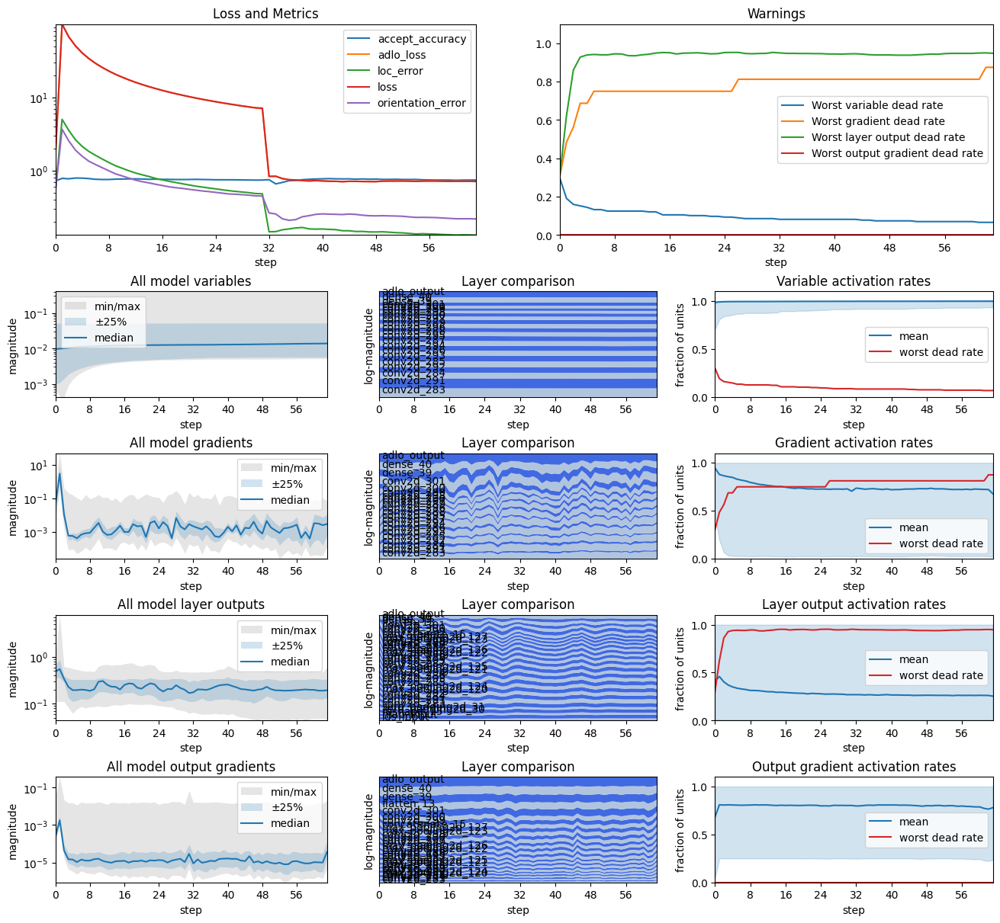

In [ ]:
# with significantly simplified ADLOOutput and ADLOLoss
def local_adlo_block(input, n_units):
    # Reduce the level of dimensionality and flatten
    adlo = Conv2D(16,
                  kernel_size=(3, 3),
                  activation='relu',
                  padding='same',
                  kernel_initializer='he_normal')(input)
    adlo = Flatten()(adlo)

    # Apply some fully-connected layers
    adlo = Dense(units=n_units, activation='relu')(adlo)
    adlo = Dense(units=n_units, activation='relu')(adlo)

    # Squish down into our output shape and apply final activations
    output = Dense(units=4, name='adlo_output')(adlo)

    return output

class local_ADLOLoss(tf.keras.losses.Loss):
    def __init__(self, name="adlo_loss", reduction=None):
        super().__init__(name=name)
        self._from_logits = True

    def call(self, y_true, y_pred):
        y_true = tf.cast(y_true, tf.float32)

        # binary cross-entropy loss for accept
        accept_true = y_true[:, 0]  # shape: (B,)
        accept_pred = y_pred[:, 0]  # shape: (B,)
        accept_losses = tf.keras.losses.binary_crossentropy(accept_true, accept_pred, from_logits=self._from_logits)

        # DLO mask - simply: include if accept_true, exclude otherwise
        mask = accept_true

        dlo_true = y_true[:, 1:4]  # shape: (B,3)
        dlo_pred = y_pred[:, 1:4]  # shape: (B,3)
        dlo_losses = tf.reduce_sum((dlo_pred - dlo_true)**2, axis=-1)  # shape: (B,)
        dlo_losses = dlo_losses * mask
        dlo_losses = tf.reduce_sum(dlo_losses) / (tf.reduce_sum(mask) + 1e-8)

        return accept_losses + dlo_losses  # shape: scalar

def adlo_model(map_shape, conv_filters=32, adlo_units=256, **kwargs):
    merge_mode = kwargs.get('merge_mode', 'concat')
    output_logits = kwargs.get('output_logits', True)
    do_compile = kwargs.get('compile', False)

    # Sanity check
    if np.size(map_shape) != 3:
        raise ValueError(f"Map shape must have 3 dims, found {np.size(map_shape)}")

    # Prepare map input
    # (pad so it's a multiple of our down/up-scaling blocks)
    map_input = Input(shape=map_shape, name='map_input')
    map_down, pad_w, pad_h = slam_models.pad_block(map_input, map_shape)
    n_classes = map_shape[2]

    # Prepare LDS input
    # (convert from (B,H,W) to (B,H,W,1) to make later work easier)
    # (pad so it's a multiple of our down/up-scaling blocks)
    lds_shape = (map_shape[0], map_shape[1], 1)
    lds_input = Input(shape=(map_shape[0], map_shape[1]), name='lds_input')  # raw input omits channels axis
    lds_down = tf.keras.layers.Reshape(target_shape=lds_shape)(lds_input)
    lds_down, _, _ = slam_models.pad_block(lds_down, lds_shape)

    # Map downsampling input arm
    # (each block here returns two outputs (downsampled, convolved-only),
    #  the latter is used for skip-connections)
    map_down, map_skip1 = slam_models.slam_down_block(map_down, conv_filters)
    map_down, map_skip2 = slam_models.slam_down_block(map_down, conv_filters * 2)
    map_down, map_skip3 = slam_models.slam_down_block(map_down, conv_filters * 4)
    map_down, map_skip4 = slam_models.slam_down_block(map_down, conv_filters * 8)

    # LDS downsampling input arm
    lds_down, lds_skip1 = slam_models.slam_down_block(lds_down, conv_filters)
    lds_down, lds_skip2 = slam_models.slam_down_block(lds_down, conv_filters * 2)
    lds_down, lds_skip3 = slam_models.slam_down_block(lds_down, conv_filters * 4)
    lds_down, lds_skip4 = slam_models.slam_down_block(lds_down, conv_filters * 8)

    # Bottom layer
    # (combine both input arms, apply some final convolutions, leave at same scale)
    bottom = Concatenate(axis=3)([map_down, lds_down])
    #bottom, _ = slam_models.slam_down_block(bottom, conv_filters * 16, max_pooling=False)
    #bottom, _ = slam_models.slam_down_block(bottom, conv_filters * 16, max_pooling=False)
    bottom, _ = slam_models.slam_down_block(bottom, conv_filters * 16, max_pooling=False)

    # Accept and Delta location/orientation output
    adlo_out = local_adlo_block(bottom, adlo_units)

    model = tf.keras.Model(inputs=[map_input, lds_input], outputs=[adlo_out])

    if do_compile:
        loss = (
            local_ADLOLoss()
        )
        metrics = {
            'adlo_output': [local_ADLOLoss(),
                            slam_models.AcceptAccuracy(),
                            slam_models.LocationError(),
                            slam_models.OrientationError()]
        }
        model.compile(optimizer='adam', loss=loss, metrics=metrics)

    print(f"Prepared SLAM model")
    print(f"  Map shape:        {map_shape} + padding ({pad_h}, {pad_w}, 0)")
    print(f"  Skip-connections: {merge_mode}")
    print(f"  Output scaling:   {'logits' if output_logits else 'scaled'}")
    print(f"  Layers:           {len(model.layers)}")
    print(f"  Inputs:           {model.inputs}")
    print(f"  Outputs:          {model.outputs}")
    print(f"  Output names:     {model.output_names}")
    print(f"  Compiled:         {do_compile}")
    return model

def for_adlo_training(inputs, outputs, metadata):
    (map_input, lds_input), (map_output, adlo_output) = inputs, outputs
    return (map_input, lds_input), adlo_output

reload(slam_models)
np.random.seed(42)
tf.random.set_seed(42)
epochs = 2
batch_size = 32
tf.config.run_functions_eagerly(False)
map_shape = next(iter(train_data))[0][0].shape
model_train_data = train_data.map(for_adlo_training)\
  .shuffle(buffer_size=len(train_data))\
  .batch(batch_size)\
  .prefetch(tf.data.experimental.AUTOTUNE)
model = adlo_model(map_shape, compile=True)

per_step=True
variables = tot.VariableHistoryCallback(per_step=per_step)
outputs = tot.LayerOutputHistoryCallback(per_step=per_step)
gradients = tot.GradientHistoryCallback(per_step=per_step)
output_gradients = tot.LayerOutputGradientHistoryCallback(per_step=per_step)
model_history = tot.fit(model, model_train_data, epochs=epochs, callbacks=[variables, outputs, gradients, output_gradients, tot.HistoryStats(per_step=per_step)])

tot.plot_history_overview([model_history, variables, gradients, outputs, output_gradients])

Prepared SLAM model
  Map shape:        (149, 149, 3) + padding (11, 11, 0)
  Skip-connections: concat
  Output scaling:   logits
  Layers:           37
  Inputs:           [<KerasTensor shape=(None, 149, 149, 3), dtype=float32, sparse=False, name=map_input>, <KerasTensor shape=(None, 149, 149), dtype=float32, sparse=False, name=lds_input>]
  Outputs:          [<KerasTensor shape=(None, 4), dtype=float32, sparse=False, name=keras_tensor_613>]
  Output names:     ListWrapper(['adlo_output'])
  Compiled:         True
Epoch 1/2
32/32 ━━━━━━━━━━━━━━━━━━━━ 60s 2s/step - accept_accuracy: 0.7103 - adlo_loss: 20.4747 - loc_error: 0.4878 - loss: 20.4747 - orientation_error: 1.3110
Epoch 2/2
32/32 ━━━━━━━━━━━━━━━━━━━━ 28s 892ms/step - accept_accuracy: 0.7480 - adlo_loss: 0.0818 - loc_error: 0.1239 - loss: 0.0818 - orientation_error: 0.2080


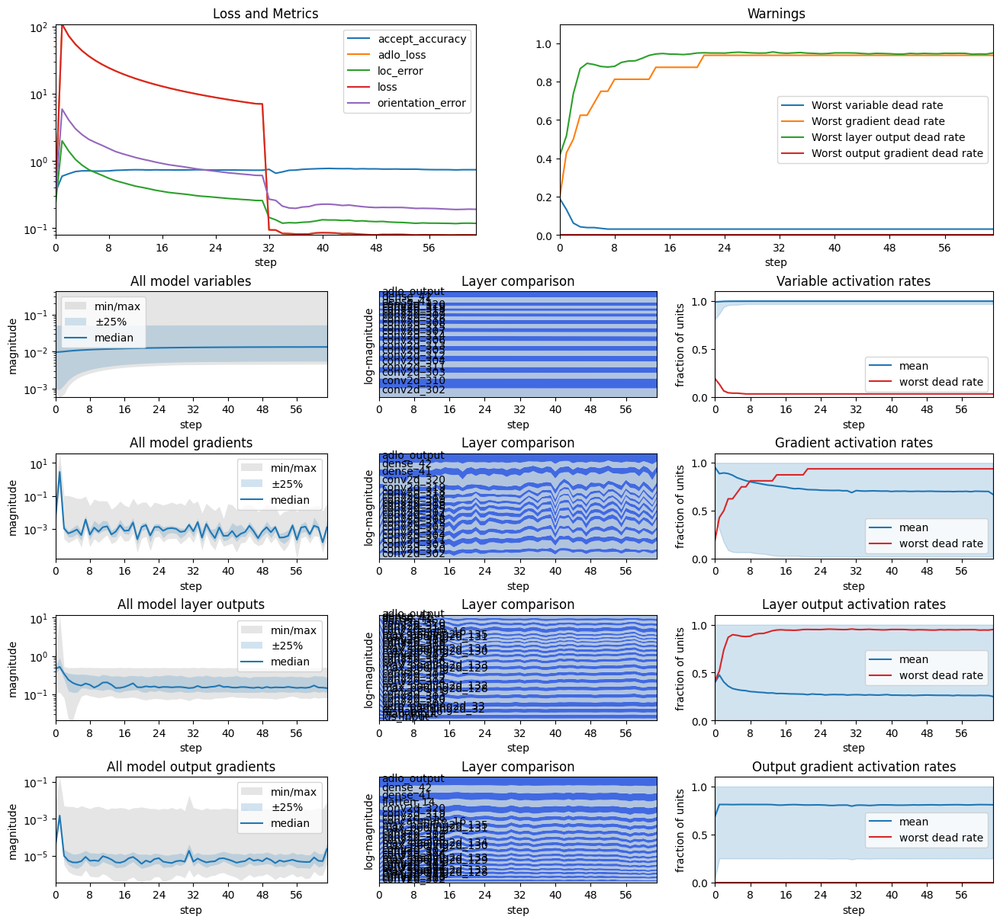

In [ ]:
# with drastically simplified ADLOOutput and ADLOLoss
def local_adlo_block(input, n_units):
    # Reduce the level of dimensionality and flatten
    adlo = Conv2D(16,
                  kernel_size=(3, 3),
                  activation='relu',
                  padding='same',
                  kernel_initializer='he_normal')(input)
    adlo = Flatten()(adlo)

    # Apply some fully-connected layers
    adlo = Dense(units=n_units, activation='relu')(adlo)
    adlo = Dense(units=n_units, activation='relu')(adlo)

    # Squish down into our output shape and apply final activations
    output = Dense(units=4, name='adlo_output')(adlo)

    return output

def adlo_model(map_shape, conv_filters=32, adlo_units=256, **kwargs):
    merge_mode = kwargs.get('merge_mode', 'concat')
    output_logits = kwargs.get('output_logits', True)
    do_compile = kwargs.get('compile', False)

    # Sanity check
    if np.size(map_shape) != 3:
        raise ValueError(f"Map shape must have 3 dims, found {np.size(map_shape)}")

    # Prepare map input
    # (pad so it's a multiple of our down/up-scaling blocks)
    map_input = Input(shape=map_shape, name='map_input')
    map_down, pad_w, pad_h = slam_models.pad_block(map_input, map_shape)
    n_classes = map_shape[2]

    # Prepare LDS input
    # (convert from (B,H,W) to (B,H,W,1) to make later work easier)
    # (pad so it's a multiple of our down/up-scaling blocks)
    lds_shape = (map_shape[0], map_shape[1], 1)
    lds_input = Input(shape=(map_shape[0], map_shape[1]), name='lds_input')  # raw input omits channels axis
    lds_down = tf.keras.layers.Reshape(target_shape=lds_shape)(lds_input)
    lds_down, _, _ = slam_models.pad_block(lds_down, lds_shape)

    # Map downsampling input arm
    # (each block here returns two outputs (downsampled, convolved-only),
    #  the latter is used for skip-connections)
    map_down, map_skip1 = slam_models.slam_down_block(map_down, conv_filters)
    map_down, map_skip2 = slam_models.slam_down_block(map_down, conv_filters * 2)
    map_down, map_skip3 = slam_models.slam_down_block(map_down, conv_filters * 4)
    map_down, map_skip4 = slam_models.slam_down_block(map_down, conv_filters * 8)

    # LDS downsampling input arm
    lds_down, lds_skip1 = slam_models.slam_down_block(lds_down, conv_filters)
    lds_down, lds_skip2 = slam_models.slam_down_block(lds_down, conv_filters * 2)
    lds_down, lds_skip3 = slam_models.slam_down_block(lds_down, conv_filters * 4)
    lds_down, lds_skip4 = slam_models.slam_down_block(lds_down, conv_filters * 8)

    # Bottom layer
    # (combine both input arms, apply some final convolutions, leave at same scale)
    bottom = Concatenate(axis=3)([map_down, lds_down])
    #bottom, _ = slam_models.slam_down_block(bottom, conv_filters * 16, max_pooling=False)
    #bottom, _ = slam_models.slam_down_block(bottom, conv_filters * 16, max_pooling=False)
    bottom, _ = slam_models.slam_down_block(bottom, conv_filters * 16, max_pooling=False)

    # Accept and Delta location/orientation output
    adlo_out = local_adlo_block(bottom, adlo_units)

    model = tf.keras.Model(inputs=[map_input, lds_input], outputs=[adlo_out])

    if do_compile:
        loss = (
            'mse'
        )
        metrics = {
            'adlo_output': [tf.keras.metrics.MeanSquaredError(name='adlo_loss'),
                            slam_models.AcceptAccuracy(),
                            slam_models.LocationError(),
                            slam_models.OrientationError()]
        }
        model.compile(optimizer='adam', loss=loss, metrics=metrics)

    print(f"Prepared SLAM model")
    print(f"  Map shape:        {map_shape} + padding ({pad_h}, {pad_w}, 0)")
    print(f"  Skip-connections: {merge_mode}")
    print(f"  Output scaling:   {'logits' if output_logits else 'scaled'}")
    print(f"  Layers:           {len(model.layers)}")
    print(f"  Inputs:           {model.inputs}")
    print(f"  Outputs:          {model.outputs}")
    print(f"  Output names:     {model.output_names}")
    print(f"  Compiled:         {do_compile}")
    return model

def for_adlo_training(inputs, outputs, metadata):
    (map_input, lds_input), (map_output, adlo_output) = inputs, outputs
    return (map_input, lds_input), adlo_output

reload(slam_models)
np.random.seed(42)
tf.random.set_seed(42)
epochs = 2
batch_size = 32
tf.config.run_functions_eagerly(False)
map_shape = next(iter(train_data))[0][0].shape
model_train_data = train_data.map(for_adlo_training)\
  .shuffle(buffer_size=len(train_data))\
  .batch(batch_size)\
  .prefetch(tf.data.experimental.AUTOTUNE)
model = adlo_model(map_shape, compile=True)

per_step=True
variables = tot.VariableHistoryCallback(per_step=per_step)
outputs = tot.LayerOutputHistoryCallback(per_step=per_step)
gradients = tot.GradientHistoryCallback(per_step=per_step)
output_gradients = tot.LayerOutputGradientHistoryCallback(per_step=per_step)
model_history = tot.fit(model, model_train_data, epochs=epochs, callbacks=[variables, outputs, gradients, output_gradients, tot.HistoryStats(per_step=per_step)])

tot.plot_history_overview([model_history, variables, gradients, outputs, output_gradients])

Significantly, even with the worst changes to the ADLOOutput, there's a new trend in play here - that the Layer Output gradients never go to zero. Superficially, this looks to be because the layer outputs never quite reach 100% dead rate.

Let's take a closer look.

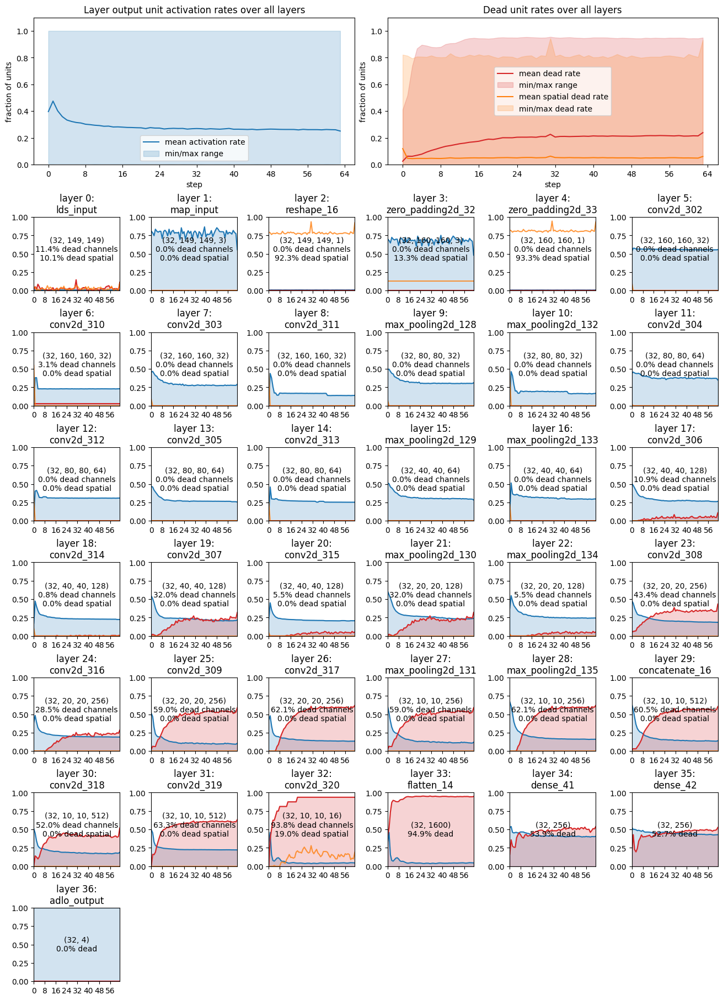

In [ ]:
tot.plot_activity_history(outputs)

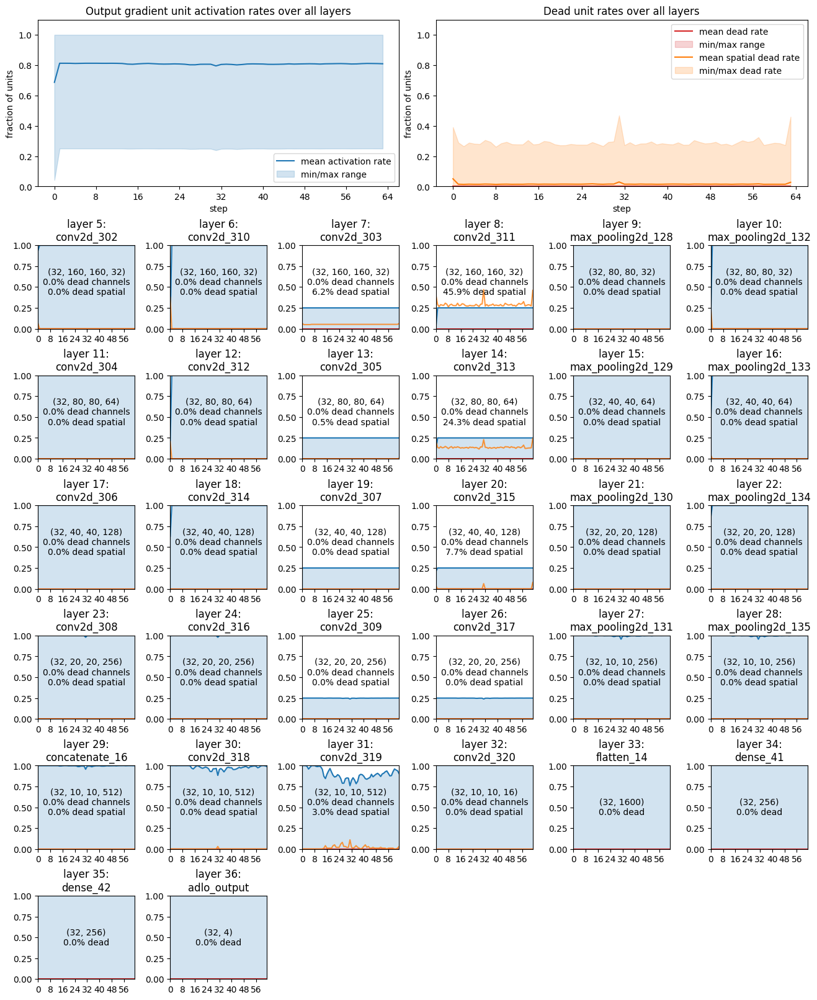

In [ ]:
tot.plot_activity_history(output_gradients)

Amazingly, the output gradients are all 0% dead (by channel). And that's true even for layers that have reached around 90% dead outputs.

The dead outputs doesn't look great, but it's surviving. The final output only has 4 units, and it appears to be fulfilling the needs of those 4 units from around 50% of the two dense layers before it.

In turn, they're fulfulling their needs from only about 5% of the 1600 outputs from the flatten layer.

On the face it, you might think the network is just way over-sized for its needs. Let's see what happens if we train for longer.

Prepared SLAM model
  Map shape:        (149, 149, 3) + padding (11, 11, 0)
  Skip-connections: concat
  Output scaling:   logits
  Layers:           37
  Inputs:           [<KerasTensor shape=(None, 149, 149, 3), dtype=float32, sparse=False, name=map_input>, <KerasTensor shape=(None, 149, 149), dtype=float32, sparse=False, name=lds_input>]
  Outputs:          [<KerasTensor shape=(None, 4), dtype=float32, sparse=False, name=keras_tensor_648>]
  Output names:     ListWrapper(['adlo_output'])
  Compiled:         True
Epoch 1/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 22s 520ms/step - accept_accuracy: 0.7567 - adlo_loss: 0.5725 - loc_error: 0.4890 - loss: 0.5725 - orientation_error: 0.3087
Epoch 2/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 7s 200ms/step - accept_accuracy: 0.7480 - adlo_loss: 0.0919 - loc_error: 0.1257 - loss: 0.0919 - orientation_error: 0.2183
Epoch 3/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 7s 201ms/step - accept_accuracy: 0.7595 - adlo_loss: 0.0768 - loc_error: 0.1109 - loss: 0.0768 - orientation_error: 0.

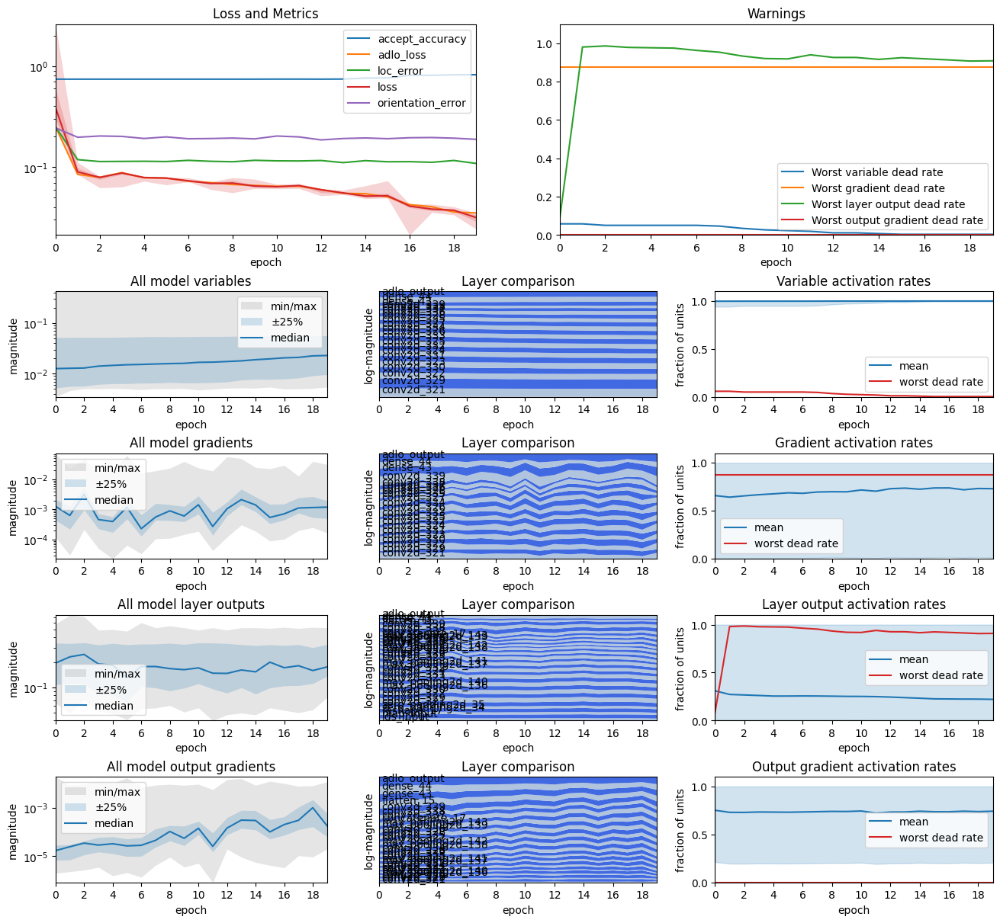

In [ ]:
reload(slam_models)
np.random.seed(42)
tf.random.set_seed(42)
epochs = 20
batch_size = 32
tf.config.run_functions_eagerly(False)
map_shape = next(iter(train_data))[0][0].shape
model_train_data = train_data.map(for_adlo_training)\
  .shuffle(buffer_size=len(train_data))\
  .batch(batch_size)\
  .prefetch(tf.data.experimental.AUTOTUNE)
model = adlo_model(map_shape, compile=True)

per_step=False
variables = tot.VariableHistoryCallback(per_step=per_step)
outputs = tot.LayerOutputHistoryCallback(per_step=per_step)
gradients = tot.GradientHistoryCallback(per_step=per_step)
output_gradients = tot.LayerOutputGradientHistoryCallback(per_step=per_step)
model_history = tot.fit(model, model_train_data, epochs=epochs, callbacks=[variables, outputs, gradients, output_gradients, tot.HistoryStats(per_step=per_step)])

tot.plot_history_overview([model_history, variables, gradients, outputs, output_gradients])

In [ ]:
show_adlo_predictions(model, train_data, num=10, display_type='list')

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


,type,accept,accept_pred,delta_x,delta_x_pred,delta_y,delta_y_pred,delta_orientation,delta_orientation_pred
0,0.0,1.0,1.080328,0.000000,-0.037044,0.000000,0.011476,0.000000,0.020126
1,3.0,0.0,0.032081,0.000000,-0.016612,0.000000,0.021873,0.000000,0.003529
2,2.0,1.0,1.006793,-0.494130,-0.100180,-0.206749,-0.204052,-0.944113,-0.091556
3,1.0,1.0,1.001183,-0.032534,-0.009806,-0.002947,0.079231,0.050610,0.191381
4,2.0,1.0,1.018318,0.274840,0.098472,-0.128493,0.049418,0.629031,0.131979
5,3.0,0.0,0.048815,0.000000,-0.048283,0.000000,0.008606,0.000000,-0.020744
6,1.0,1.0,1.141596,-0.022084,0.081184,0.030389,-0.042602,0.078957,0.209609
7,2.0,1.0,1.093662,-0.225254,-0.102237,0.444011,-0.033144,-0.485207,-0.007052
8,1.0,1.0,1.052413,-0.040690,-0.005585,-0.061804,-0.105018,0.018774,0.080651
9,2.0,1.0,1.012835,0.388187,-0.012412,-0.212914,-0.003968,0.628041,0.374089


Analysis:
* It doesn't look great, but it is working. It's producing a variety of outputs, and the training curve looks like it's edging towards a point where it'll shoot off and start working well.
* It also shows that the dead rate can recover from ~100%. I'm amazed that that is even possible.
* I think what's happening is:
  * the domain is _difficult_
  * the initial randomly initialised model does _very badly_
  * the loss function pushes against the _worst offenders_ first.
  * those are initially positive output activations, but they get pushed _hard_ in the opposite direction and go past zero.
  * once they're out of the way, it starts to push the _good actors_ into stronger positions
  * and then finally brings back some of the otherwise dead units (thanks to the criss-cross interactions in matrix multiplications).

* It's hard to imagine why this would actually be happening exactly this way. And I still assume that a better behaved network wouldn't behave this way, and would train significantly faster.

Next steps:
* As an idea, let's try out a radically reduced-capacity network that cannot afford to kill off any units, and see if it exhibits similar behaviour.
* Another idea could even be to add in more dropout, because that'll keep the model forced to rely upon a wider pool of inputs at each layer.

## Much simpler network

Prepared SLAM model
  Map shape:        (149, 149, 3) + padding (11, 11, 0)
  Skip-connections: concat
  Output scaling:   logits
  Layers:           38
  Inputs:           [<KerasTensor shape=(None, 149, 149, 3), dtype=float32, sparse=False, name=map_input>, <KerasTensor shape=(None, 149, 149), dtype=float32, sparse=False, name=lds_input>]
  Outputs:          [<KerasTensor shape=(None, 4), dtype=float32, sparse=False, name=keras_tensor_143>]
  Output names:     ListWrapper(['adlo_output'])
  Compiled:         True
Epoch 1/2
 1/32 ━━━━━━━━━━━━━━━━━━━━ 5:13 10s/step - accept_accuracy: 0.7188 - adlo_loss: 0.2129 - loc_error: 0.2427 - loss: 0.2129 - orientation_error: 0.3555

32/32 ━━━━━━━━━━━━━━━━━━━━ 45s 1s/step - accept_accuracy: 0.7567 - adlo_loss: 0.1381 - loc_error: 0.1935 - loss: 0.1381 - orientation_error: 0.2388  
Epoch 2/2
32/32 ━━━━━━━━━━━━━━━━━━━━ 15s 466ms/step - accept_accuracy: 0.7480 - adlo_loss: 0.0802 - loc_error: 0.1257 - loss: 0.0802 - orientation_error: 0.2020


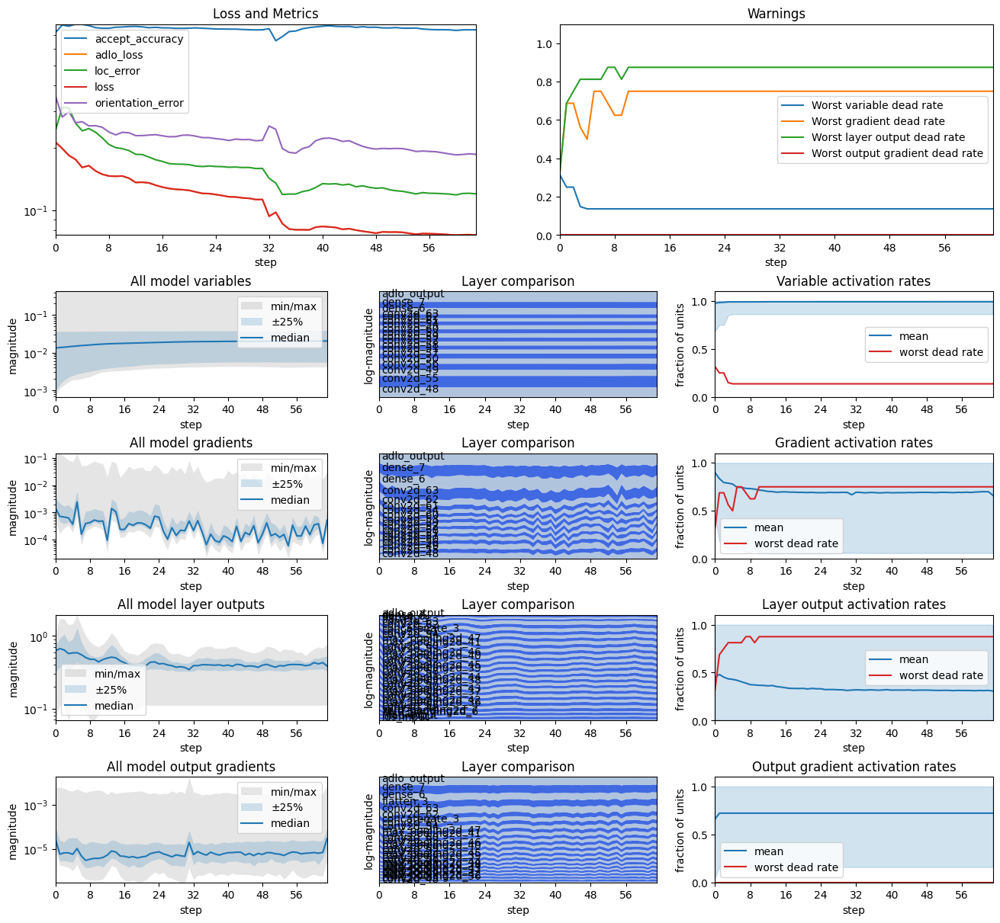

In [ ]:
def pad_block(x, input_size):
    """
    Works out if padding is required and applies it if needed.
    Args:
      x: image or map tensor (B,H,W,...)
      input_size: size of input (H,W,...)
    Returns:
      padded tensor (B,H+pad_h,W+pad_w,...), total padded width, total padded height
    """
    pad_h = 64 - input_size[0] % 64
    pad_w = 64 - input_size[1] % 64
    if pad_h > 0 or pad_w > 0:
        padded = ZeroPadding2D(padding=((pad_h//2, pad_h-pad_h//2), (pad_w//2, pad_w-pad_w//2)))(x)
    else:
        padded = x
    return padded, pad_w, pad_h

def adlo_model(map_shape, conv_filters=32, adlo_units=256, **kwargs):
    merge_mode = kwargs.get('merge_mode', 'concat')
    output_logits = kwargs.get('output_logits', True)
    do_compile = kwargs.get('compile', False)

    # Sanity check
    if np.size(map_shape) != 3:
        raise ValueError(f"Map shape must have 3 dims, found {np.size(map_shape)}")

    # Prepare map input
    # (pad so it's a multiple of our down/up-scaling blocks)
    map_input = Input(shape=map_shape, name='map_input')
    map_down, pad_w, pad_h = slam_models.pad_block(map_input, map_shape)
    n_classes = map_shape[2]

    # Prepare LDS input
    # (convert from (B,H,W) to (B,H,W,1) to make later work easier)
    # (pad so it's a multiple of our down/up-scaling blocks)
    lds_shape = (map_shape[0], map_shape[1], 1)
    lds_input = Input(shape=(map_shape[0], map_shape[1]), name='lds_input')  # raw input omits channels axis
    lds_down = tf.keras.layers.Reshape(target_shape=lds_shape)(lds_input)
    lds_down, _, _ = slam_models.pad_block(lds_down, lds_shape)

    # Map downsampling input arm
    # (each block here returns two outputs (downsampled, convolved-only),
    #  the latter is used for skip-connections)
    map_down = Conv2D(filters=conv_filters, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(map_down)
    map_down = MaxPooling2D(pool_size=(2, 2))(map_down)
    map_down = Conv2D(filters=conv_filters * 2, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(map_down)
    map_down = MaxPooling2D(pool_size=(2, 2))(map_down)
    map_down = Conv2D(filters=conv_filters * 4, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(map_down)
    map_down = MaxPooling2D(pool_size=(2, 2))(map_down)
    map_down = Conv2D(filters=conv_filters * 4, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(map_down)
    map_down = MaxPooling2D(pool_size=(2, 2))(map_down)
    map_down = Conv2D(filters=conv_filters * 4, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(map_down)
    map_down = MaxPooling2D(pool_size=(2, 2))(map_down)
    map_down = Conv2D(filters=conv_filters * 4, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(map_down)
    map_down = MaxPooling2D(pool_size=(2, 2))(map_down)
    # reduce before concatenating
    map_down = Conv2D(filters=conv_filters * 4, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(map_down)

    # LDS downsampling input arm
    lds_down = Conv2D(filters=conv_filters, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(lds_down)
    lds_down = MaxPooling2D(pool_size=(2, 2))(lds_down)
    lds_down = Conv2D(filters=conv_filters * 2, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(lds_down)
    lds_down = MaxPooling2D(pool_size=(2, 2))(lds_down)
    lds_down = Conv2D(filters=conv_filters * 4, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(lds_down)
    lds_down = MaxPooling2D(pool_size=(2, 2))(lds_down)
    lds_down = Conv2D(filters=conv_filters * 4, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(lds_down)
    lds_down = MaxPooling2D(pool_size=(2, 2))(lds_down)
    lds_down = Conv2D(filters=conv_filters * 4, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(lds_down)
    lds_down = MaxPooling2D(pool_size=(2, 2))(lds_down)
    lds_down = Conv2D(filters=conv_filters * 4, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(lds_down)
    lds_down = MaxPooling2D(pool_size=(2, 2))(lds_down)
    # reduce before concatenating
    lds_down = Conv2D(filters=conv_filters * 4, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(lds_down)

    # Bottom layer
    # (combine both input arms, apply some final convolutions, leave at same scale)
    bottom = Concatenate(axis=3)([map_down, lds_down])
    bottom = Conv2D(filters=conv_filters * 4, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(bottom)

    # ADLO output
    adlo = Conv2D(filters=4, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(bottom)
    adlo = Flatten()(adlo)
    adlo = Dense(units=256, activation='relu')(adlo)
    adlo = Dense(units=16, activation='relu')(adlo)
    adlo_out = Dense(units=4, name='adlo_output')(adlo)

    model = tf.keras.Model(inputs=[map_input, lds_input], outputs=[adlo_out])

    if do_compile:
        loss = (
            'mse'
        )
        metrics = {
            'adlo_output': [tf.keras.metrics.MeanSquaredError(name='adlo_loss'),
                            slam_models.AcceptAccuracy(),
                            slam_models.LocationError(),
                            slam_models.OrientationError()]
        }
        model.compile(optimizer='adam', loss=loss, metrics=metrics)

    print(f"Prepared SLAM model")
    print(f"  Map shape:        {map_shape} + padding ({pad_h}, {pad_w}, 0)")
    print(f"  Skip-connections: {merge_mode}")
    print(f"  Output scaling:   {'logits' if output_logits else 'scaled'}")
    print(f"  Layers:           {len(model.layers)}")
    print(f"  Inputs:           {model.inputs}")
    print(f"  Outputs:          {model.outputs}")
    print(f"  Output names:     {model.output_names}")
    print(f"  Compiled:         {do_compile}")
    return model

def for_adlo_training(inputs, outputs, metadata):
    (map_input, lds_input), (map_output, adlo_output) = inputs, outputs
    return (map_input, lds_input), adlo_output

reload(slam_models)
np.random.seed(42)
tf.random.set_seed(42)
epochs = 2
batch_size = 32
tf.config.run_functions_eagerly(False)
map_shape = next(iter(train_data))[0][0].shape
model_train_data = train_data.map(for_adlo_training)\
  .shuffle(buffer_size=len(train_data))\
  .batch(batch_size)\
  .prefetch(tf.data.experimental.AUTOTUNE)
model = adlo_model(map_shape, compile=True)

per_step=True
variables = tot.VariableHistoryCallback(per_step=per_step)
outputs = tot.LayerOutputHistoryCallback(per_step=per_step)
gradients = tot.GradientHistoryCallback(per_step=per_step)
output_gradients = tot.LayerOutputGradientHistoryCallback(per_step=per_step)
model_history = tot.fit(model, model_train_data, epochs=epochs, callbacks=[variables, outputs, gradients, output_gradients, tot.HistoryStats(per_step=per_step)])

tot.plot_history_overview([model_history, variables, gradients, outputs, output_gradients])

In [ ]:
model.summary()

Model: "functional_5"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ lds_input (InputLayer)    │ (None, 149, 149)       │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ map_input (InputLayer)    │ (None, 149, 149, 3)    │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ reshape_3 (Reshape)       │ (None, 149, 149, 1)    │              0 │ lds_input[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ zero_padding2d_6          │ (None, 160, 160, 3)    │              0 │ map_input[0][0]        │
│ (ZeroPadding2D)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ zero_padding2d_7          │ (None, 160, 160, 1)    │              0 │ reshape_3[0][0]        │
│ (ZeroPadding2D)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_48 (Conv2D)        │ (None, 160, 160, 32)   │            896 │ zero_padding2d_6[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_55 (Conv2D)        │ (None, 160, 160, 32)   │            320 │ zero_padding2d_7[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_36          │ (None, 80, 80, 32)     │              0 │ conv2d_48[0][0]        │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_42          │ (None, 80, 80, 32)     │              0 │ conv2d_55[0][0]        │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_49 (Conv2D)        │ (None, 80, 80, 64)     │         18,496 │ max_pooling2d_36[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_56 (Conv2D)        │ (None, 80, 80, 64)     │         18,496 │ max_pooling2d_42[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_37          │ (None, 40, 40, 64)     │              0 │ conv2d_49[0][0]        │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_43          │ (None, 40, 40, 64)     │              0 │ conv2d_56[0][0]        │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_50 (Conv2D)        │ (None, 40, 40, 128)    │         73,856 │ max_pooling2d_37[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_57 (Conv2D)        │ (None, 40, 40, 128)    │         73,856 │ max_pooling2d_43[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_38          │ (None, 20, 20, 128)    │              0 │ conv2d_50[0][0]        │
│ (MaxPooling2D)            │                        │                │                        │
├──────────────────────

 Total params: 5,024,330 (19.17 MB)

 Trainable params: 1,674,776 (6.39 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 3,349,554 (12.78 MB)

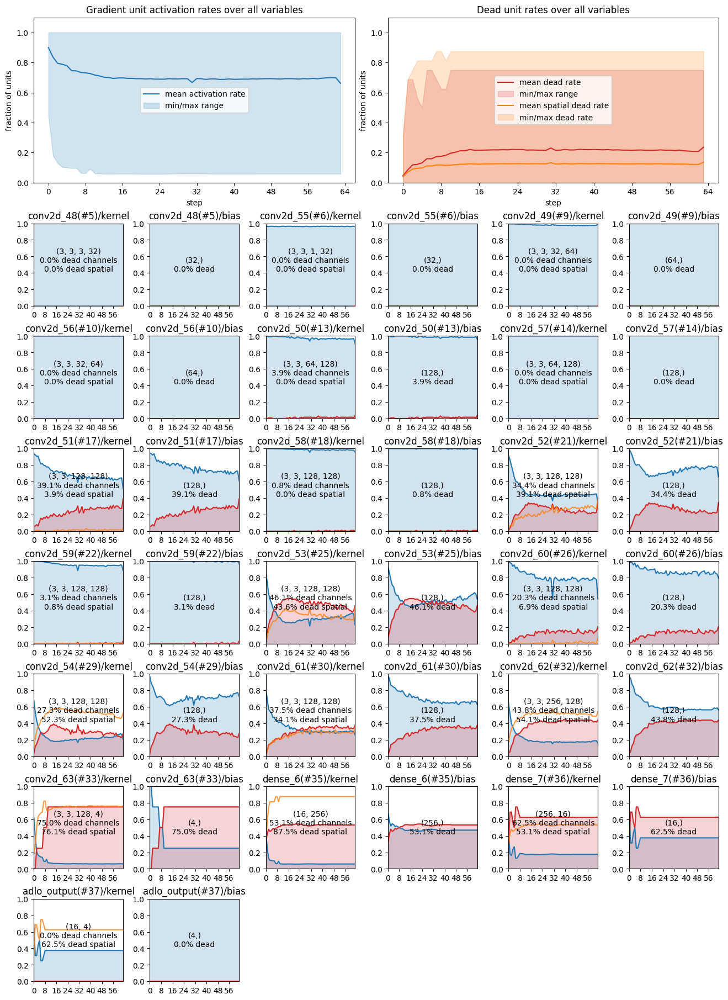

In [ ]:
tot.plot_activity_history(gradients)

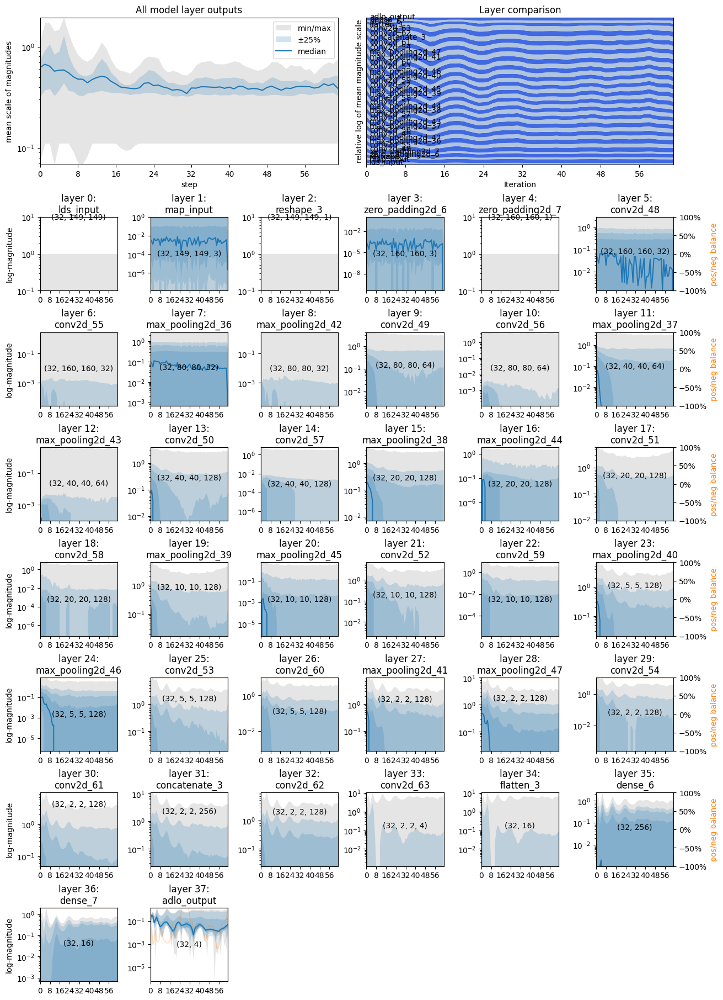

In [ ]:
tot.plot_value_history(outputs)

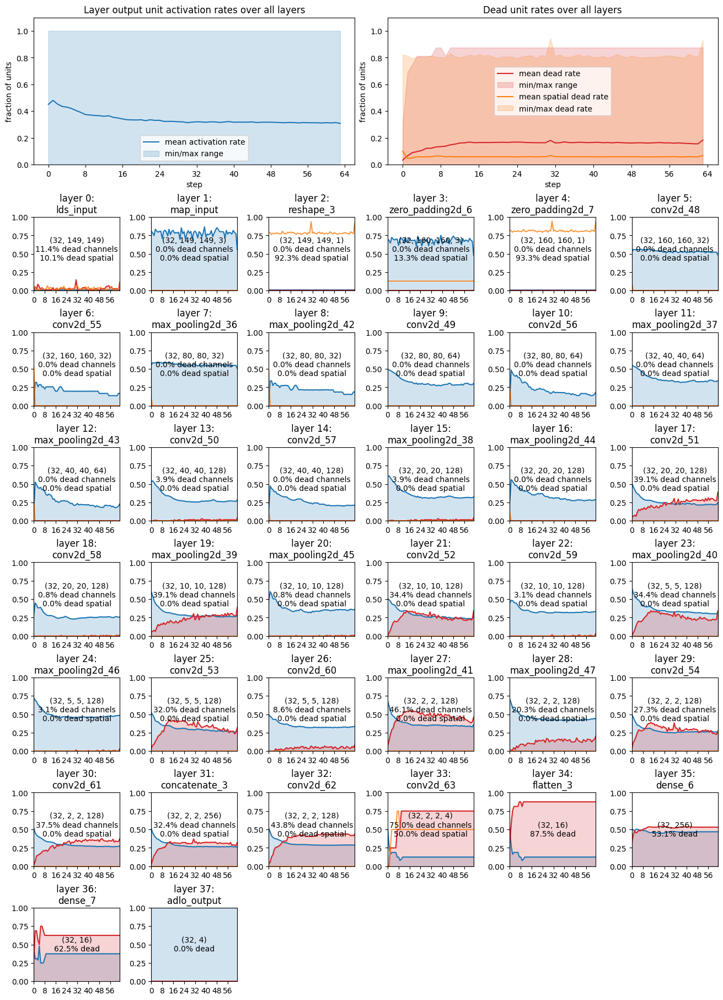

In [ ]:
tot.plot_activity_history(outputs)

87.5% of 16 output units means 2 units being used. I've also seen it as low as a single unit. Notice also that the subsequent dense layers are both 50% dead.

So that's 2 at best, but probably only 1 activation going into our final output value, which has 4 independent values.

This means we're not really getting 4 independent values. Let's look closer at that.

In [ ]:
model_stats, layer_stats, layer_channel_activity, layer_spatial_activity = tot.measure_unit_activity(model, model_train_data, include_channel_activity=True, include_spatial_activity=True, verbose=1)

100%|██████████| 32/32 [00:03<00:00, 10.64it/s]


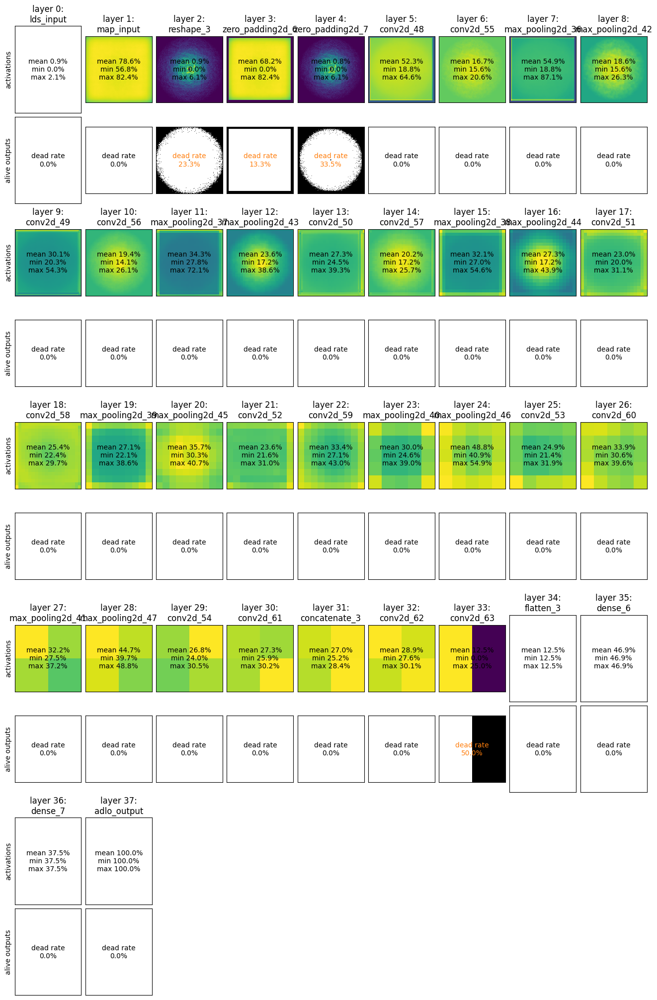

In [ ]:
tot.plot_spatial_stats(layer_spatial_activity, model)

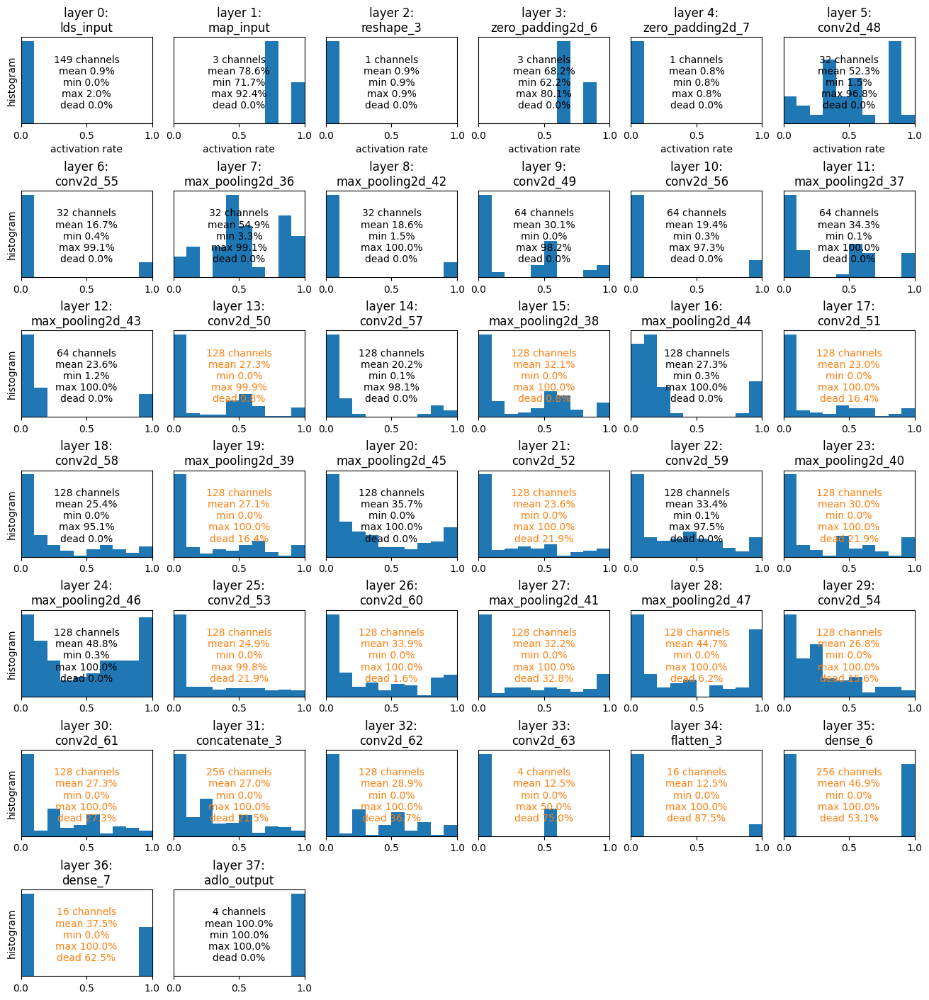

In [ ]:
tot.plot_channel_stats(layer_channel_activity, model)

Even after running across the entire training set, only 2 outputs from the flatten layer are in use.

This means that I should be able to do a PCA across the outputs and see a 1 or 2 variable explanation for the 4 outputs.

In [ ]:
show_adlo_predictions(model, train_data, num=10, display_type='list', sample_types=[0])

[0]
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 654ms/step


,type,accept,accept_pred,delta_x,delta_x_pred,delta_y,delta_y_pred,delta_orientation,delta_orientation_pred
0,0.0,1.0,0.924271,0.0,0.023314,0.0,0.041422,0.0,0.062900
1,0.0,1.0,0.934516,0.0,0.023973,0.0,0.040995,0.0,0.062231
2,0.0,1.0,1.001010,0.0,0.022650,0.0,0.046030,0.0,0.066426
3,0.0,1.0,0.899683,0.0,0.023970,0.0,0.039327,0.0,0.061094
4,0.0,1.0,0.970346,0.0,0.024010,0.0,0.042663,0.0,0.063349
5,0.0,1.0,0.947349,0.0,0.023451,0.0,0.042338,0.0,0.063447
6,0.0,1.0,1.062504,0.0,0.020811,0.0,0.051543,0.0,0.071242
7,0.0,1.0,0.931752,0.0,0.023073,0.0,0.042116,0.0,0.063511
8,0.0,1.0,1.036118,0.0,0.023101,0.0,0.047085,0.0,0.066889
9,0.0,1.0,1.109306,0.0,0.023017,0.0,0.050716,0.0,0.069417


In [ ]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

In [ ]:
(map_input, lds_input), y_true = next(iter(model_train_data))
y_pred = model((map_input, lds_input))
print(f"map_input: {map_input.shape}")
print(f"lds_input: {lds_input.shape}")
print(f"y_true: {y_true.shape}")
print(f"y_pred: {y_pred.shape}")

map_input: (32, 149, 149, 3)
lds_input: (32, 149, 149)
y_true: (32, 4)
y_pred: (32, 4)


In [ ]:
# Baseline: let's look at a PCA of y_true
# - the ratios suggest that at least 3 to 4 components are needed to explain the data
df = pd.DataFrame(y_true)
scaling=StandardScaler()
scaling.fit(df)
df = scaling.transform(df)
principle = PCA(n_components=4)
principle.fit(df)
print(f"principle.explained_variance_ratio_: {principle.explained_variance_ratio_}")

principle.explained_variance_ratio_: [0.42747203 0.27202585 0.21970682 0.08079524]


In [ ]:
# Now for our predicted data
# - the ratios here suggest that we need at most 2 components, exactly consistent with what I'd predicted
df = pd.DataFrame(y_pred)
scaling=StandardScaler()
scaling.fit(df)
df = scaling.transform(df)
principle = PCA(n_components=4)
principle.fit(df)
print(f"principle.explained_variance_ratio_: {principle.explained_variance_ratio_}")

principle.explained_variance_ratio_: [7.1801186e-01 2.8198808e-01 3.9720720e-11 2.0923686e-12]


100%|██████████| 32/32 [00:01<00:00, 19.53it/s]


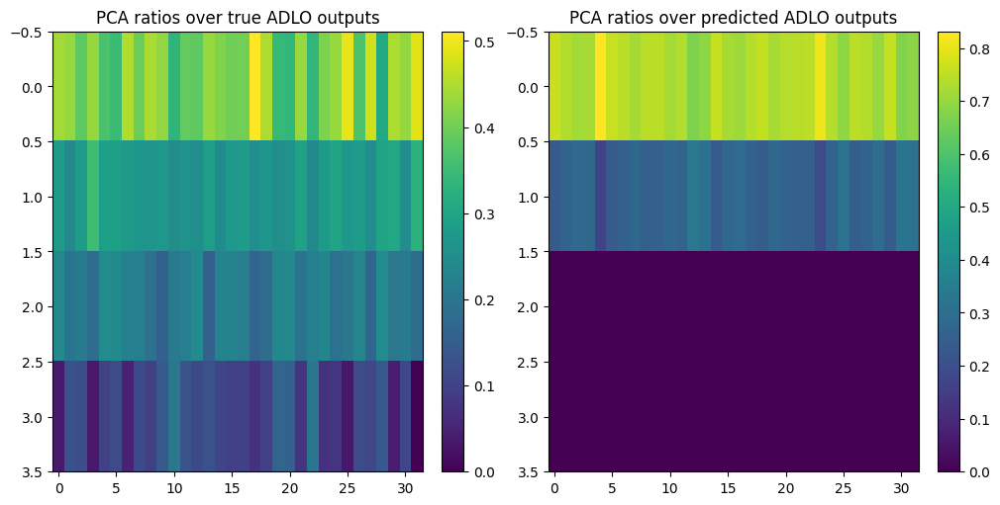

In [ ]:
def do_pca_over_all_data(pred=False):
  results = []
  for (map_input, lds_input), y_true in tqdm.tqdm(model_train_data):
    values = y_true
    if pred:
      values = model((map_input, lds_input))

    # run PCA
    df = pd.DataFrame(values)
    scaling=StandardScaler()
    scaling.fit(df)
    df = scaling.transform(df)
    principle = PCA(n_components=4)
    principle.fit(df)
    results.append(principle.explained_variance_ratio_)

  return np.stack(results, axis=0)

def plot_compare_pca_ratios(ratios_true, ratios_pred):
  plt.figure(figsize=(10,5), layout='constrained')
  plt.subplot(1,2,1)
  plt.title("PCA ratios over true ADLO outputs")
  plt.imshow(ratios_true.T, aspect='auto')
  plt.colorbar()

  plt.subplot(1,2,2)
  plt.title("PCA ratios over predicted ADLO outputs")
  plt.imshow(ratios_pred.T, aspect='auto')
  plt.colorbar()

  plt.show()

ratios_true = do_pca_over_all_data(pred=False)
ratios_pred = do_pca_over_all_data(pred=True)
plot_compare_pca_ratios(ratios_true, ratios_pred)


Clearly consistent. The y_true values are realistic, while the y_pred values are dependent on 1 to 2 variables only.

What if this is a bug in the custom fit function that isn't handling a model with multiple inputs correctly? Let's get back to basics and train with the standard fit function.

In [ ]:
reload(slam_models)
np.random.seed(42)
tf.random.set_seed(42)
epochs = 2
batch_size = 32
tf.config.run_functions_eagerly(False)
map_shape = next(iter(train_data))[0][0].shape
model_train_data = train_data.map(for_adlo_training)\
  .shuffle(buffer_size=len(train_data))\
  .batch(batch_size)\
  .prefetch(tf.data.experimental.AUTOTUNE)
model = adlo_model(map_shape, compile=True)

model_history = model.fit(model_train_data, epochs=epochs)

Prepared SLAM model
  Map shape:        (149, 149, 3) + padding (11, 11, 0)
  Skip-connections: concat
  Output scaling:   logits
  Layers:           38
  Inputs:           [<KerasTensor shape=(None, 149, 149, 3), dtype=float32, sparse=False, name=map_input>, <KerasTensor shape=(None, 149, 149), dtype=float32, sparse=False, name=lds_input>]
  Outputs:          [<KerasTensor shape=(None, 4), dtype=float32, sparse=False, name=keras_tensor_71>]
  Output names:     ListWrapper(['adlo_output'])
  Compiled:         True
Epoch 1/2
32/32 ━━━━━━━━━━━━━━━━━━━━ 20s 230ms/step - accept_accuracy: 0.7025 - adlo_loss: 0.1600 - loc_error: 0.2398 - loss: 0.1600 - orientation_error: 0.2503
Epoch 2/2
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 72ms/step - accept_accuracy: 0.7480 - adlo_loss: 0.1082 - loc_error: 0.2505 - loss: 0.1082 - orientation_error: 0.2127


100%|██████████| 32/32 [00:01<00:00, 20.19it/s]


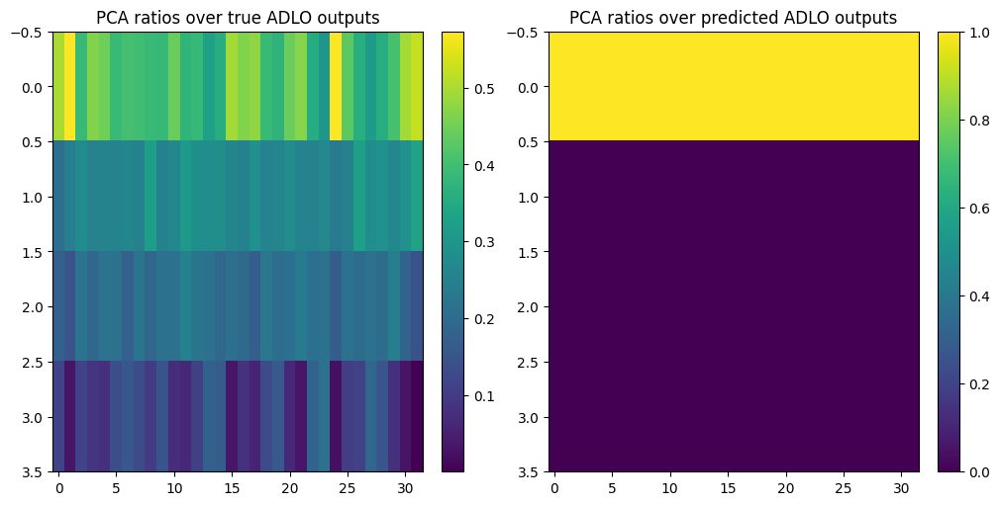

In [ ]:
ratios_true = do_pca_over_all_data(pred=False)
ratios_pred = do_pca_over_all_data(pred=True)
plot_compare_pca_ratios(ratios_true, ratios_pred)

That's even worse. Now, just to confirm, what if we train for longer.

In [ ]:
reload(slam_models)
np.random.seed(42)
tf.random.set_seed(42)
epochs = 20
batch_size = 32
tf.config.run_functions_eagerly(False)
map_shape = next(iter(train_data))[0][0].shape
model_train_data = train_data.map(for_adlo_training)\
  .shuffle(buffer_size=len(train_data))\
  .batch(batch_size)\
  .prefetch(tf.data.experimental.AUTOTUNE)
model = adlo_model(map_shape, compile=True)

model_history = model.fit(model_train_data, epochs=epochs)

Prepared SLAM model
  Map shape:        (149, 149, 3) + padding (11, 11, 0)
  Skip-connections: concat
  Output scaling:   logits
  Layers:           38
  Inputs:           [<KerasTensor shape=(None, 149, 149, 3), dtype=float32, sparse=False, name=map_input>, <KerasTensor shape=(None, 149, 149), dtype=float32, sparse=False, name=lds_input>]
  Outputs:          [<KerasTensor shape=(None, 4), dtype=float32, sparse=False, name=keras_tensor_107>]
  Output names:     ListWrapper(['adlo_output'])
  Compiled:         True
Epoch 1/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - accept_accuracy: 0.7236 - adlo_loss: 0.1213 - loc_error: 0.1624 - loss: 0.1213 - orientation_error: 0.2277
Epoch 2/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 72ms/step - accept_accuracy: 0.7480 - adlo_loss: 0.0761 - loc_error: 0.1172 - loss: 0.0761 - orientation_error: 0.2135
Epoch 3/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 71ms/step - accept_accuracy: 0.7595 - adlo_loss: 0.0711 - loc_error: 0.1126 - loss: 0.0711 - orientation_error: 0.19

100%|██████████| 32/32 [00:01<00:00, 20.70it/s]


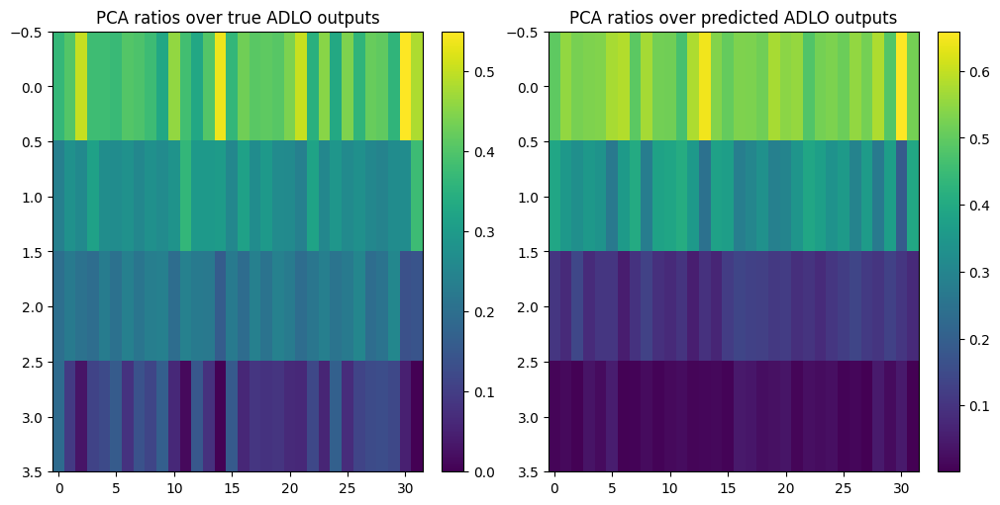

In [ ]:
ratios_true = do_pca_over_all_data(pred=False)
ratios_pred = do_pca_over_all_data(pred=True)
plot_compare_pca_ratios(ratios_true, ratios_pred)

Ok, so there's a really interesting problem with the way that networks are trained and the use of ReLU. But given sufficient time, the network does usually recover.

This looks like a really interesting research project to look into the benefit of some other kind of regularization to avoid this problem.

## Lots of Dropout
In the meantime, I'm going to give the idea of using lots of dropout an idea. If that does work, ideally I'd set dropout really high initially and scale it down over the course of training.

To start with, we'll be very targeted and try to fix just the worst layer - the flatten layer. It's producing mostly dead outputs, which means that its conv input is already pretty dead. Let's add a dropout just before that conv layer.

Prepared SLAM model
  Map shape:        (149, 149, 3) + padding (11, 11, 0)
  Skip-connections: concat
  Output scaling:   logits
  Layers:           39
  Inputs:           [<KerasTensor shape=(None, 149, 149, 3), dtype=float32, sparse=False, name=map_input>, <KerasTensor shape=(None, 149, 149), dtype=float32, sparse=False, name=lds_input>]
  Outputs:          [<KerasTensor shape=(None, 4), dtype=float32, sparse=False, name=keras_tensor_248>]
  Output names:     ListWrapper(['adlo_output'])
  Compiled:         True
Epoch 1/2
32/32 ━━━━━━━━━━━━━━━━━━━━ 46s 1s/step - accept_accuracy: 0.7141 - adlo_loss: 0.1196 - loc_error: 0.1506 - loss: 0.1196 - orientation_error: 0.2219  
Epoch 2/2
32/32 ━━━━━━━━━━━━━━━━━━━━ 15s 479ms/step - accept_accuracy: 0.7480 - adlo_loss: 0.0832 - loc_error: 0.1230 - loss: 0.0832 - orientation_error: 0.2166


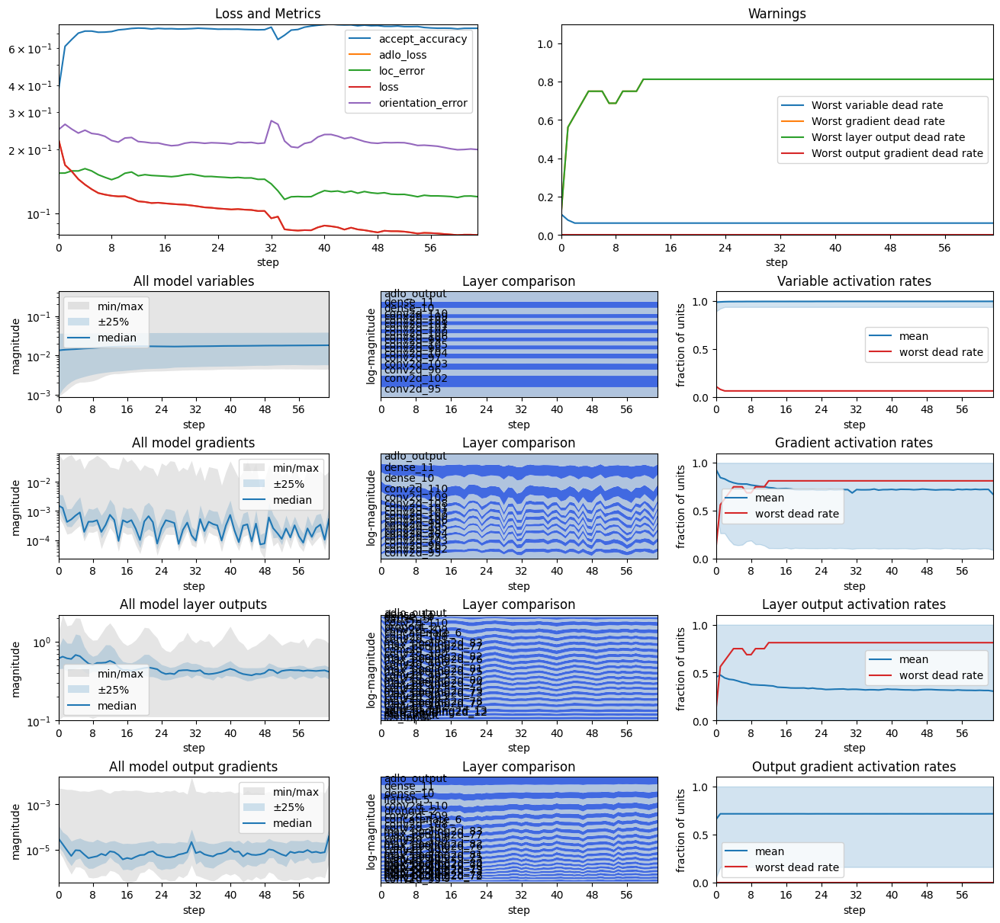

In [ ]:
def pad_block(x, input_size):
    """
    Works out if padding is required and applies it if needed.
    Args:
      x: image or map tensor (B,H,W,...)
      input_size: size of input (H,W,...)
    Returns:
      padded tensor (B,H+pad_h,W+pad_w,...), total padded width, total padded height
    """
    pad_h = 64 - input_size[0] % 64
    pad_w = 64 - input_size[1] % 64
    if pad_h > 0 or pad_w > 0:
        padded = ZeroPadding2D(padding=((pad_h//2, pad_h-pad_h//2), (pad_w//2, pad_w-pad_w//2)))(x)
    else:
        padded = x
    return padded, pad_w, pad_h

def adlo_model(map_shape, conv_filters=32, adlo_units=256, **kwargs):
    merge_mode = kwargs.get('merge_mode', 'concat')
    output_logits = kwargs.get('output_logits', True)
    do_compile = kwargs.get('compile', False)

    # Sanity check
    if np.size(map_shape) != 3:
        raise ValueError(f"Map shape must have 3 dims, found {np.size(map_shape)}")

    # Prepare map input
    # (pad so it's a multiple of our down/up-scaling blocks)
    map_input = Input(shape=map_shape, name='map_input')
    map_down, pad_w, pad_h = slam_models.pad_block(map_input, map_shape)
    n_classes = map_shape[2]

    # Prepare LDS input
    # (convert from (B,H,W) to (B,H,W,1) to make later work easier)
    # (pad so it's a multiple of our down/up-scaling blocks)
    lds_shape = (map_shape[0], map_shape[1], 1)
    lds_input = Input(shape=(map_shape[0], map_shape[1]), name='lds_input')  # raw input omits channels axis
    lds_down = tf.keras.layers.Reshape(target_shape=lds_shape)(lds_input)
    lds_down, _, _ = slam_models.pad_block(lds_down, lds_shape)

    # Map downsampling input arm
    # (each block here returns two outputs (downsampled, convolved-only),
    #  the latter is used for skip-connections)
    map_down = Conv2D(filters=conv_filters, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(map_down)
    map_down = MaxPooling2D(pool_size=(2, 2))(map_down)
    map_down = Conv2D(filters=conv_filters * 2, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(map_down)
    map_down = MaxPooling2D(pool_size=(2, 2))(map_down)
    map_down = Conv2D(filters=conv_filters * 4, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(map_down)
    map_down = MaxPooling2D(pool_size=(2, 2))(map_down)
    map_down = Conv2D(filters=conv_filters * 4, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(map_down)
    map_down = MaxPooling2D(pool_size=(2, 2))(map_down)
    map_down = Conv2D(filters=conv_filters * 4, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(map_down)
    map_down = MaxPooling2D(pool_size=(2, 2))(map_down)
    map_down = Conv2D(filters=conv_filters * 4, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(map_down)
    map_down = MaxPooling2D(pool_size=(2, 2))(map_down)
    # reduce before concatenating
    map_down = Conv2D(filters=conv_filters * 4, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(map_down)

    # LDS downsampling input arm
    lds_down = Conv2D(filters=conv_filters, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(lds_down)
    lds_down = MaxPooling2D(pool_size=(2, 2))(lds_down)
    lds_down = Conv2D(filters=conv_filters * 2, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(lds_down)
    lds_down = MaxPooling2D(pool_size=(2, 2))(lds_down)
    lds_down = Conv2D(filters=conv_filters * 4, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(lds_down)
    lds_down = MaxPooling2D(pool_size=(2, 2))(lds_down)
    lds_down = Conv2D(filters=conv_filters * 4, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(lds_down)
    lds_down = MaxPooling2D(pool_size=(2, 2))(lds_down)
    lds_down = Conv2D(filters=conv_filters * 4, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(lds_down)
    lds_down = MaxPooling2D(pool_size=(2, 2))(lds_down)
    lds_down = Conv2D(filters=conv_filters * 4, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(lds_down)
    lds_down = MaxPooling2D(pool_size=(2, 2))(lds_down)
    # reduce before concatenating
    lds_down = Conv2D(filters=conv_filters * 4, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(lds_down)

    # Bottom layer
    # (combine both input arms, apply some final convolutions, leave at same scale)
    bottom = Concatenate(axis=3)([map_down, lds_down])
    bottom = Conv2D(filters=conv_filters * 4, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(bottom)
    bottom = Dropout(rate=0.5)(bottom)

    # ADLO output
    adlo = Conv2D(filters=4, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(bottom)
    adlo = Flatten()(adlo)
    adlo = Dense(units=256, activation='relu')(adlo)
    adlo = Dense(units=16, activation='relu')(adlo)
    adlo_out = Dense(units=4, name='adlo_output')(adlo)

    model = tf.keras.Model(inputs=[map_input, lds_input], outputs=[adlo_out])

    if do_compile:
        loss = (
            'mse'
        )
        metrics = {
            'adlo_output': [tf.keras.metrics.MeanSquaredError(name='adlo_loss'),
                            slam_models.AcceptAccuracy(),
                            slam_models.LocationError(),
                            slam_models.OrientationError()]
        }
        model.compile(optimizer='adam', loss=loss, metrics=metrics)

    print(f"Prepared SLAM model")
    print(f"  Map shape:        {map_shape} + padding ({pad_h}, {pad_w}, 0)")
    print(f"  Skip-connections: {merge_mode}")
    print(f"  Output scaling:   {'logits' if output_logits else 'scaled'}")
    print(f"  Layers:           {len(model.layers)}")
    print(f"  Inputs:           {model.inputs}")
    print(f"  Outputs:          {model.outputs}")
    print(f"  Output names:     {model.output_names}")
    print(f"  Compiled:         {do_compile}")
    return model

def for_adlo_training(inputs, outputs, metadata):
    (map_input, lds_input), (map_output, adlo_output) = inputs, outputs
    return (map_input, lds_input), adlo_output

reload(slam_models)
np.random.seed(42)
tf.random.set_seed(42)
epochs = 2
batch_size = 32
tf.config.run_functions_eagerly(False)
map_shape = next(iter(train_data))[0][0].shape
model_train_data = train_data.map(for_adlo_training)\
  .shuffle(buffer_size=len(train_data))\
  .batch(batch_size)\
  .prefetch(tf.data.experimental.AUTOTUNE)
model = adlo_model(map_shape, compile=True)

per_step=True
variables = tot.VariableHistoryCallback(per_step=per_step)
outputs = tot.LayerOutputHistoryCallback(per_step=per_step)
gradients = tot.GradientHistoryCallback(per_step=per_step)
output_gradients = tot.LayerOutputGradientHistoryCallback(per_step=per_step)
model_history = tot.fit(model, model_train_data, epochs=epochs, callbacks=[variables, outputs, gradients, output_gradients, tot.HistoryStats(per_step=per_step)])

tot.plot_history_overview([model_history, variables, gradients, outputs, output_gradients])

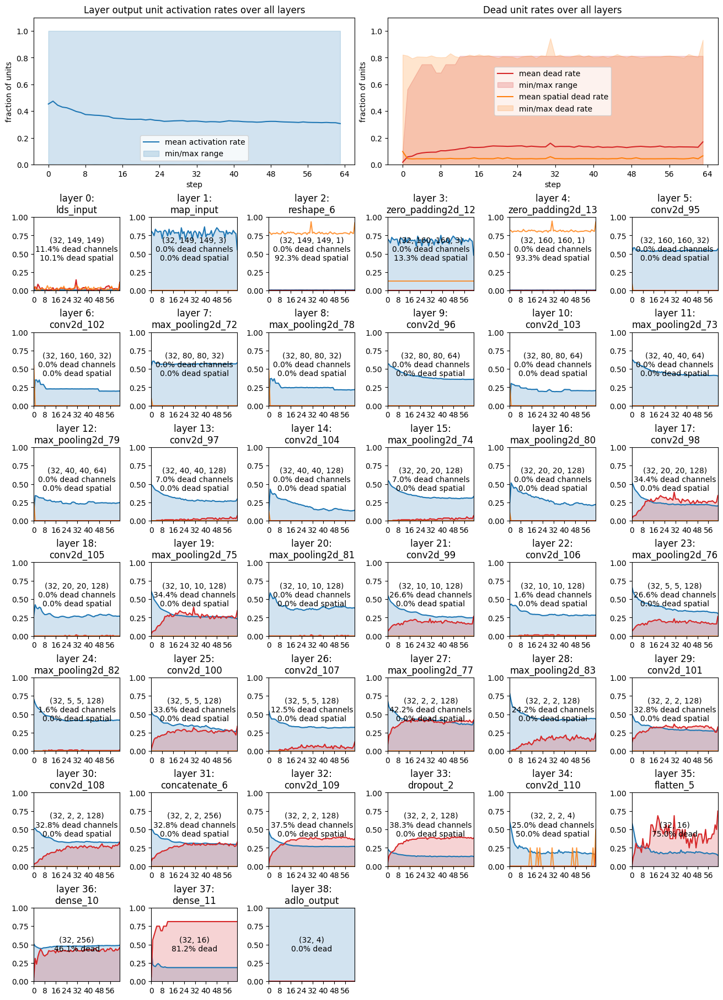

In [ ]:
tot.plot_activity_history(outputs)

That took effect, but there's still a lot of dead units around 30% across many layers. Let's go to the other extreme and add dropout everywhere.

Prepared SLAM model
  Map shape:        (149, 149, 3) + padding (11, 11, 0)
  Skip-connections: concat
  Output scaling:   logits
  Layers:           55
  Inputs:           [<KerasTensor shape=(None, 149, 149, 3), dtype=float32, sparse=False, name=map_input>, <KerasTensor shape=(None, 149, 149), dtype=float32, sparse=False, name=lds_input>]
  Outputs:          [<KerasTensor shape=(None, 4), dtype=float32, sparse=False, name=keras_tensor_460>]
  Output names:     ListWrapper(['adlo_output'])
  Compiled:         True
Epoch 1/2
 1/32 ━━━━━━━━━━━━━━━━━━━━ 5:05 10s/step - accept_accuracy: 0.6562 - adlo_loss: 0.2368 - loc_error: 0.2282 - loss: 0.2368 - orientation_error: 0.3973

32/32 ━━━━━━━━━━━━━━━━━━━━ 56s 1s/step - accept_accuracy: 0.7439 - adlo_loss: 0.1862 - loc_error: 0.2279 - loss: 0.1862 - orientation_error: 0.2714
Epoch 2/2
32/32 ━━━━━━━━━━━━━━━━━━━━ 18s 563ms/step - accept_accuracy: 0.7480 - adlo_loss: 0.1020 - loc_error: 0.1764 - loss: 0.1020 - orientation_error: 0.2424


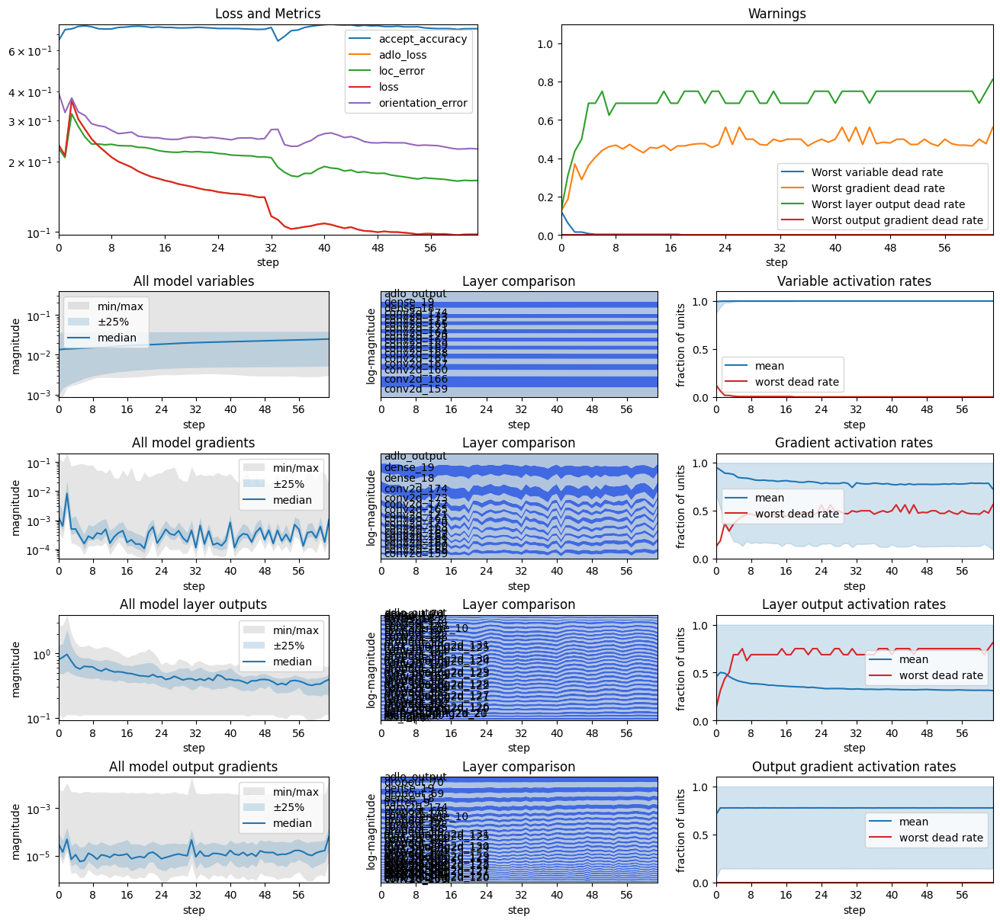

In [ ]:
def pad_block(x, input_size):
    """
    Works out if padding is required and applies it if needed.
    Args:
      x: image or map tensor (B,H,W,...)
      input_size: size of input (H,W,...)
    Returns:
      padded tensor (B,H+pad_h,W+pad_w,...), total padded width, total padded height
    """
    pad_h = 64 - input_size[0] % 64
    pad_w = 64 - input_size[1] % 64
    if pad_h > 0 or pad_w > 0:
        padded = ZeroPadding2D(padding=((pad_h//2, pad_h-pad_h//2), (pad_w//2, pad_w-pad_w//2)))(x)
    else:
        padded = x
    return padded, pad_w, pad_h

def adlo_model(map_shape, conv_filters=32, adlo_units=256, dropout_rate=0.1, **kwargs):
    merge_mode = kwargs.get('merge_mode', 'concat')
    output_logits = kwargs.get('output_logits', True)
    do_compile = kwargs.get('compile', False)

    # Sanity check
    if np.size(map_shape) != 3:
        raise ValueError(f"Map shape must have 3 dims, found {np.size(map_shape)}")

    # Prepare map input
    # (pad so it's a multiple of our down/up-scaling blocks)
    map_input = Input(shape=map_shape, name='map_input')
    map_down, pad_w, pad_h = slam_models.pad_block(map_input, map_shape)
    n_classes = map_shape[2]

    # Prepare LDS input
    # (convert from (B,H,W) to (B,H,W,1) to make later work easier)
    # (pad so it's a multiple of our down/up-scaling blocks)
    lds_shape = (map_shape[0], map_shape[1], 1)
    lds_input = Input(shape=(map_shape[0], map_shape[1]), name='lds_input')  # raw input omits channels axis
    lds_down = tf.keras.layers.Reshape(target_shape=lds_shape)(lds_input)
    lds_down, _, _ = slam_models.pad_block(lds_down, lds_shape)

    drate = dropout_rate

    # Map downsampling input arm
    # (each block here returns two outputs (downsampled, convolved-only),
    #  the latter is used for skip-connections)
    map_down = Conv2D(filters=conv_filters, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(map_down)
    map_down = MaxPooling2D(pool_size=(2, 2))(map_down)
    map_down = Dropout(rate=drate)(map_down)
    map_down = Conv2D(filters=conv_filters * 2, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(map_down)
    map_down = MaxPooling2D(pool_size=(2, 2))(map_down)
    map_down = Dropout(rate=drate)(map_down)
    map_down = Conv2D(filters=conv_filters * 4, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(map_down)
    map_down = MaxPooling2D(pool_size=(2, 2))(map_down)
    map_down = Dropout(rate=drate)(map_down)
    map_down = Conv2D(filters=conv_filters * 4, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(map_down)
    map_down = MaxPooling2D(pool_size=(2, 2))(map_down)
    map_down = Dropout(rate=drate)(map_down)
    map_down = Conv2D(filters=conv_filters * 4, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(map_down)
    map_down = MaxPooling2D(pool_size=(2, 2))(map_down)
    map_down = Dropout(rate=drate)(map_down)
    map_down = Conv2D(filters=conv_filters * 4, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(map_down)
    map_down = MaxPooling2D(pool_size=(2, 2))(map_down)
    map_down = Dropout(rate=drate)(map_down)
    # reduce before concatenating
    map_down = Conv2D(filters=conv_filters * 4, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(map_down)
    map_down = Dropout(rate=drate)(map_down)

    # LDS downsampling input arm
    lds_down = Conv2D(filters=conv_filters, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(lds_down)
    lds_down = MaxPooling2D(pool_size=(2, 2))(lds_down)
    lds_down = Dropout(rate=drate)(lds_down)
    lds_down = Conv2D(filters=conv_filters * 2, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(lds_down)
    lds_down = MaxPooling2D(pool_size=(2, 2))(lds_down)
    lds_down = Dropout(rate=drate)(lds_down)
    lds_down = Conv2D(filters=conv_filters * 4, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(lds_down)
    lds_down = MaxPooling2D(pool_size=(2, 2))(lds_down)
    lds_down = Dropout(rate=drate)(lds_down)
    lds_down = Conv2D(filters=conv_filters * 4, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(lds_down)
    lds_down = MaxPooling2D(pool_size=(2, 2))(lds_down)
    lds_down = Dropout(rate=drate)(lds_down)
    lds_down = Conv2D(filters=conv_filters * 4, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(lds_down)
    lds_down = MaxPooling2D(pool_size=(2, 2))(lds_down)
    lds_down = Dropout(rate=drate)(lds_down)
    lds_down = Conv2D(filters=conv_filters * 4, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(lds_down)
    lds_down = MaxPooling2D(pool_size=(2, 2))(lds_down)
    lds_down = Dropout(rate=drate)(lds_down)
    # reduce before concatenating
    lds_down = Conv2D(filters=conv_filters * 4, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(lds_down)
    lds_down = Dropout(rate=drate)(lds_down)

    # Bottom layer
    # (combine both input arms, apply some final convolutions, leave at same scale)
    bottom = Concatenate(axis=3)([map_down, lds_down])
    bottom = Conv2D(filters=conv_filters * 4, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(bottom)
    bottom = Dropout(rate=drate)(bottom)

    # ADLO output
    adlo = Conv2D(filters=4, kernel_size=(3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(bottom)
    adlo = Flatten()(adlo)
    adlo = Dense(units=256, activation='relu')(adlo)
    adlo = Dropout(rate=drate)(adlo)
    adlo = Dense(units=16, activation='relu')(adlo)
    adlo = Dropout(rate=drate)(adlo)
    adlo_out = Dense(units=4, name='adlo_output')(adlo)

    model = tf.keras.Model(inputs=[map_input, lds_input], outputs=[adlo_out])

    if do_compile:
        loss = (
            'mse'
        )
        metrics = {
            'adlo_output': [tf.keras.metrics.MeanSquaredError(name='adlo_loss'),
                            slam_models.AcceptAccuracy(),
                            slam_models.LocationError(),
                            slam_models.OrientationError()]
        }
        model.compile(optimizer='adam', loss=loss, metrics=metrics)

    print(f"Prepared SLAM model")
    print(f"  Map shape:        {map_shape} + padding ({pad_h}, {pad_w}, 0)")
    print(f"  Skip-connections: {merge_mode}")
    print(f"  Output scaling:   {'logits' if output_logits else 'scaled'}")
    print(f"  Layers:           {len(model.layers)}")
    print(f"  Inputs:           {model.inputs}")
    print(f"  Outputs:          {model.outputs}")
    print(f"  Output names:     {model.output_names}")
    print(f"  Compiled:         {do_compile}")
    return model

def for_adlo_training(inputs, outputs, metadata):
    (map_input, lds_input), (map_output, adlo_output) = inputs, outputs
    return (map_input, lds_input), adlo_output

reload(slam_models)
np.random.seed(42)
tf.random.set_seed(42)
epochs = 2
batch_size = 32
tf.config.run_functions_eagerly(False)
map_shape = next(iter(train_data))[0][0].shape
model_train_data = train_data.map(for_adlo_training)\
  .shuffle(buffer_size=len(train_data))\
  .batch(batch_size)\
  .prefetch(tf.data.experimental.AUTOTUNE)
model = adlo_model(map_shape, compile=True, dropout_rate=0.1)

per_step=True
variables = tot.VariableHistoryCallback(per_step=per_step)
outputs = tot.LayerOutputHistoryCallback(per_step=per_step)
gradients = tot.GradientHistoryCallback(per_step=per_step)
output_gradients = tot.LayerOutputGradientHistoryCallback(per_step=per_step)
model_history = tot.fit(model, model_train_data, epochs=epochs, callbacks=[variables, outputs, gradients, output_gradients, tot.HistoryStats(per_step=per_step)])

tot.plot_history_overview([model_history, variables, gradients, outputs, output_gradients])

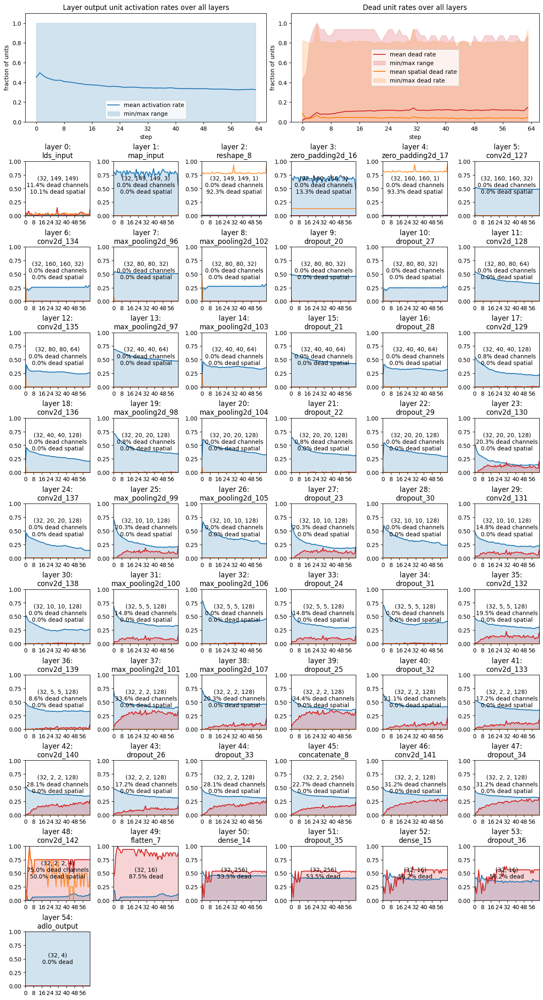

In [ ]:
tot.plot_activity_history(outputs)

In [ ]:
show_adlo_predictions(model, train_data, num=10, display_type='list')

None
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 641ms/step


,type,accept,accept_pred,delta_x,delta_x_pred,delta_y,delta_y_pred,delta_orientation,delta_orientation_pred
0,0.0,1.0,0.384740,0.000000,-0.018173,0.000000,0.020187,0.000000,0.020171
1,3.0,0.0,0.487817,0.000000,-0.009526,0.000000,0.033895,0.000000,0.025794
2,2.0,1.0,0.417661,-0.494130,-0.015786,-0.206749,0.024255,-0.944113,0.022235
3,1.0,1.0,0.367588,-0.032534,-0.018841,-0.002947,0.018690,0.050610,0.018891
4,2.0,1.0,0.424892,0.274840,-0.015227,-0.128493,0.025177,0.629031,0.022664
5,3.0,0.0,0.314415,0.000000,-0.022369,0.000000,0.014230,0.000000,0.015191
6,1.0,1.0,0.359793,-0.022084,-0.018787,0.030389,0.018491,0.078957,0.018286
7,2.0,1.0,0.443225,-0.225254,-0.014263,0.444011,0.027133,-0.485207,0.024061
8,1.0,1.0,0.409687,-0.040690,-0.015840,-0.061804,0.023703,0.018774,0.021359
9,2.0,1.0,0.380179,0.388187,-0.018200,-0.212914,0.019879,0.628041,0.019687


100%|██████████| 32/32 [00:01<00:00, 17.93it/s]


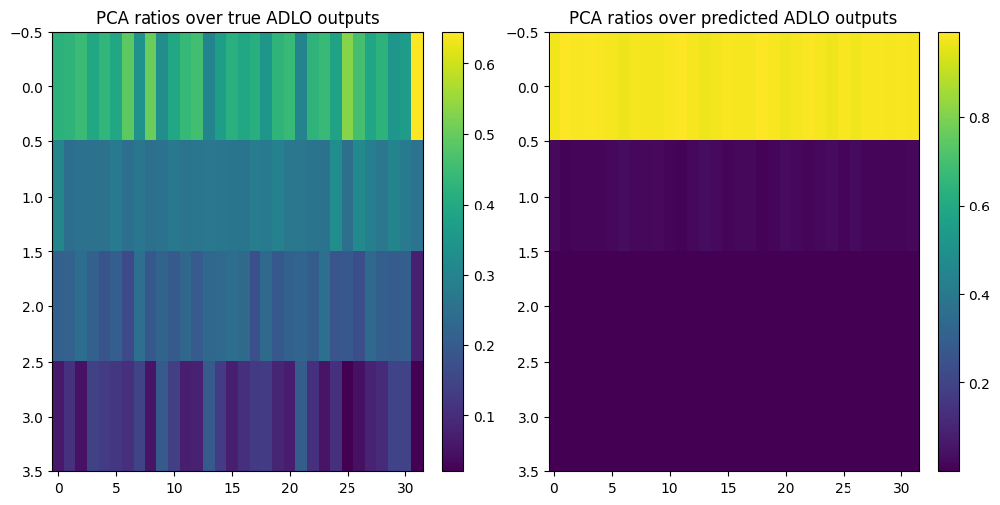

In [ ]:
# with dropout rate=0.1 for all dropouts
ratios_true = do_pca_over_all_data(pred=False)
ratios_pred = do_pca_over_all_data(pred=True)
plot_compare_pca_ratios(ratios_true, ratios_pred)

Some results:
* dropout rate=0.5 for all dropouts
  * very bad results
  * dead rates were jumping up and down between 0% and 100% all over the place.
  * after only 2 epochs the model was producing constant output values
* dropout rate=0.1 for all dropouts
  * no improvement over baseline
  * y_pred still depends on only 1 variable after 2 epochs.

Also note:
* Where the layer has high activation rates, dropout doesn't lead to dead units. But for layers that already have low activation rates, dropout can push it over the edge. One example I saw above was a layer with 0% dead rate, but the very next dropout layer (dropout rate = 10%) had a 20% dead rate.

Let's train this for longer and see how its learning curve goes.

In [ ]:
reload(slam_models)
np.random.seed(42)
tf.random.set_seed(42)
epochs = 20
batch_size = 32
tf.config.run_functions_eagerly(False)
map_shape = next(iter(train_data))[0][0].shape
model_train_data = train_data.map(for_adlo_training)\
  .shuffle(buffer_size=len(train_data))\
  .batch(batch_size)\
  .prefetch(tf.data.experimental.AUTOTUNE)
model = adlo_model(map_shape, compile=True, dropout=0.1)

per_step=False
variables = tot.VariableHistoryCallback(per_step=per_step)
outputs = tot.LayerOutputHistoryCallback(per_step=per_step)
gradients = tot.GradientHistoryCallback(per_step=per_step)
output_gradients = tot.LayerOutputGradientHistoryCallback(per_step=per_step)
model_history = tot.fit(model, model_train_data, epochs=epochs, callbacks=[variables, outputs, gradients, output_gradients, tot.HistoryStats(per_step=per_step)])

Prepared SLAM model
  Map shape:        (149, 149, 3) + padding (11, 11, 0)
  Skip-connections: concat
  Output scaling:   logits
  Layers:           55
  Inputs:           [<KerasTensor shape=(None, 149, 149, 3), dtype=float32, sparse=False, name=map_input>, <KerasTensor shape=(None, 149, 149), dtype=float32, sparse=False, name=lds_input>]
  Outputs:          [<KerasTensor shape=(None, 4), dtype=float32, sparse=False, name=keras_tensor_407>]
  Output names:     ListWrapper(['adlo_output'])
  Compiled:         True
Epoch 1/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 20s 408ms/step - accept_accuracy: 0.6987 - adlo_loss: 0.1901 - loc_error: 0.2290 - loss: 0.1901 - orientation_error: 0.3385


Epoch 2/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 4s 110ms/step - accept_accuracy: 0.7480 - adlo_loss: 0.1042 - loc_error: 0.1809 - loss: 0.1042 - orientation_error: 0.2792
Epoch 3/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 4s 109ms/step - accept_accuracy: 0.7595 - adlo_loss: 0.0927 - loc_error: 0.1625 - loss: 0.0927 - orientation_error: 0.2396
Epoch 4/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 4s 109ms/step - accept_accuracy: 0.7340 - adlo_loss: 0.0857 - loc_error: 0.1545 - loss: 0.0857 - orientation_error: 0.2184
Epoch 5/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 4s 109ms/step - accept_accuracy: 0.7333 - adlo_loss: 0.0835 - loc_error: 0.1481 - loss: 0.0835 - orientation_error: 0.2181
Epoch 6/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 4s 110ms/step - accept_accuracy: 0.7583 - adlo_loss: 0.0848 - loc_error: 0.1434 - loss: 0.0848 - orientation_error: 0.2114
Epoch 7/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 4s 110ms/step - accept_accuracy: 0.7186 - adlo_loss: 0.0788 - loc_error: 0.1429 - loss: 0.0788 - orientation_error: 0.2163
Epoch 8/20
32/32 ━━━━━━━━━━━━━━━━━

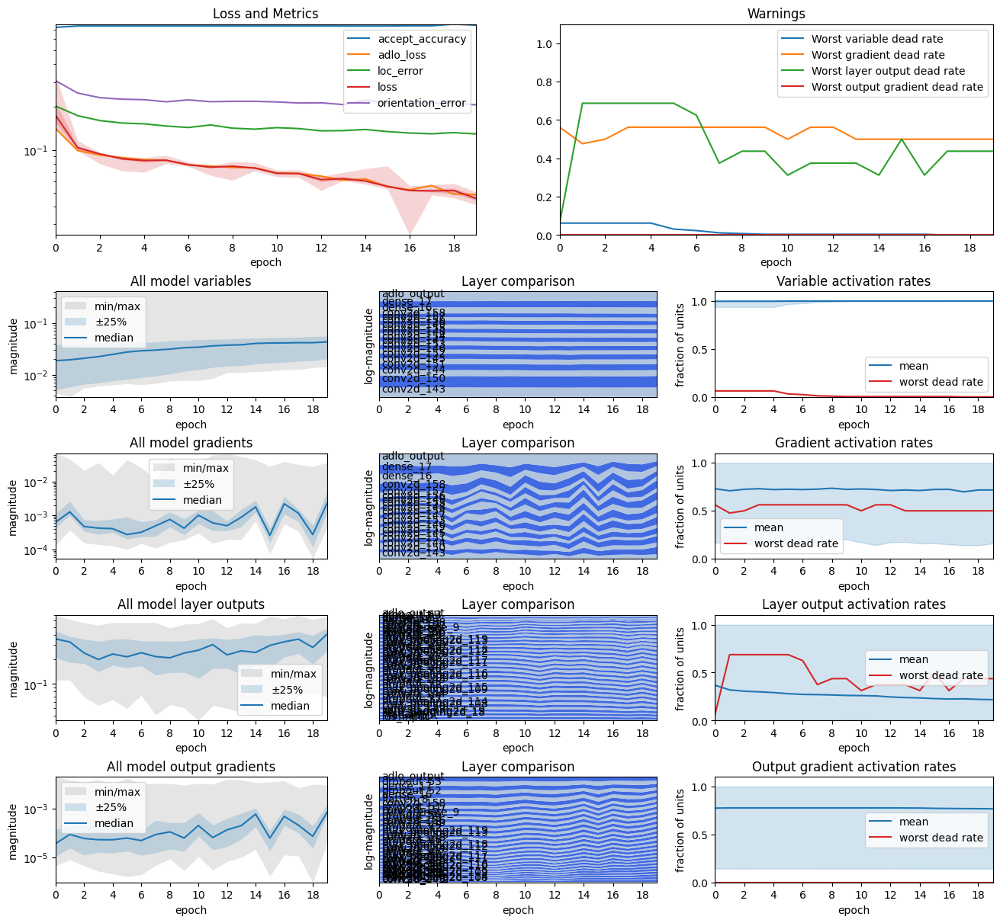

In [ ]:
tot.plot_history_overview([model_history, variables, gradients, outputs, output_gradients])

In [ ]:
# For comparison, without dropout
reload(slam_models)
np.random.seed(42)
tf.random.set_seed(42)
epochs = 20
batch_size = 32
tf.config.run_functions_eagerly(False)
map_shape = next(iter(train_data))[0][0].shape
model_train_data = train_data.map(for_adlo_training)\
  .shuffle(buffer_size=len(train_data))\
  .batch(batch_size)\
  .prefetch(tf.data.experimental.AUTOTUNE)
model = adlo_model(map_shape, compile=True, dropout=0.0)

per_step=False
variables = tot.VariableHistoryCallback(per_step=per_step)
outputs = tot.LayerOutputHistoryCallback(per_step=per_step)
gradients = tot.GradientHistoryCallback(per_step=per_step)
output_gradients = tot.LayerOutputGradientHistoryCallback(per_step=per_step)
model_history = tot.fit(model, model_train_data, epochs=epochs, callbacks=[variables, outputs, gradients, output_gradients, tot.HistoryStats(per_step=per_step)])

Prepared SLAM model
  Map shape:        (149, 149, 3) + padding (11, 11, 0)
  Skip-connections: concat
  Output scaling:   logits
  Layers:           55
  Inputs:           [<KerasTensor shape=(None, 149, 149, 3), dtype=float32, sparse=False, name=map_input>, <KerasTensor shape=(None, 149, 149), dtype=float32, sparse=False, name=lds_input>]
  Outputs:          [<KerasTensor shape=(None, 4), dtype=float32, sparse=False, name=keras_tensor_566>]
  Output names:     ListWrapper(['adlo_output'])
  Compiled:         True
Epoch 1/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 18s 389ms/step - accept_accuracy: 0.7106 - adlo_loss: 0.1584 - loc_error: 0.2212 - loss: 0.1584 - orientation_error: 0.2776
Epoch 2/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 4s 111ms/step - accept_accuracy: 0.7480 - adlo_loss: 0.0924 - loc_error: 0.1536 - loss: 0.0924 - orientation_error: 0.2331
Epoch 3/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 4s 110ms/step - accept_accuracy: 0.7595 - adlo_loss: 0.0843 - loc_error: 0.1442 - loss: 0.0843 - orientation_error: 0.

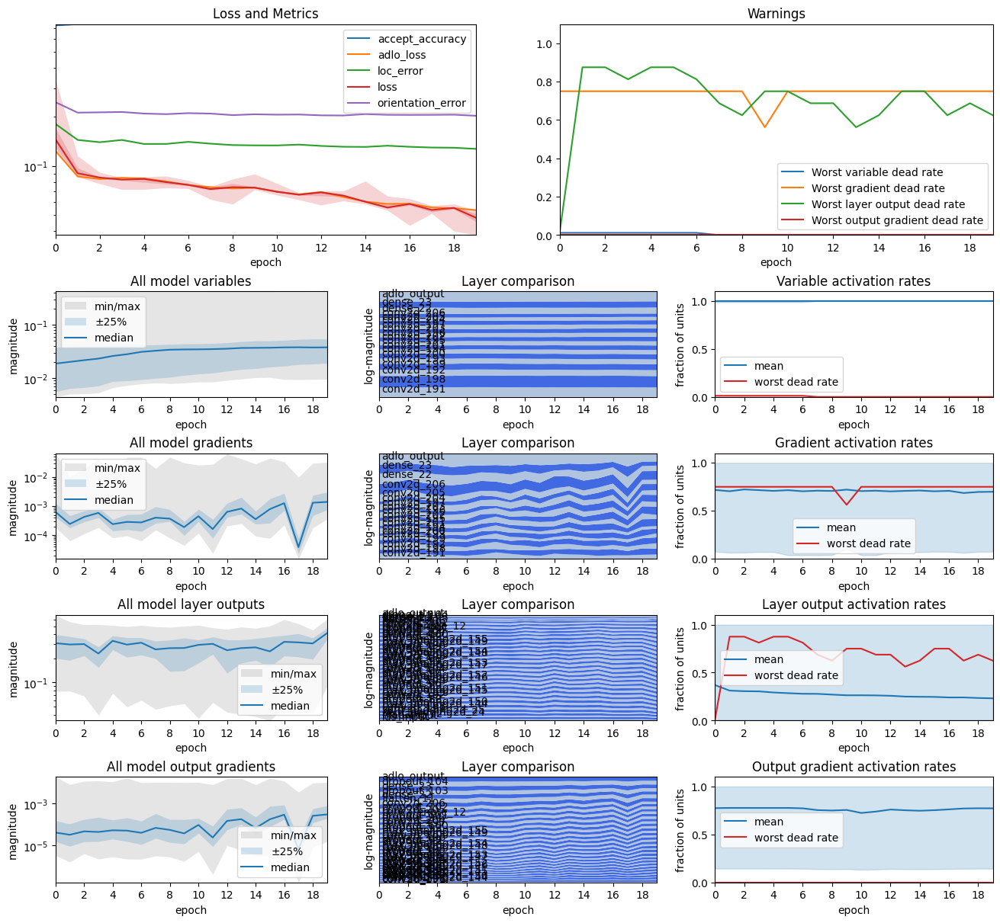

In [ ]:
tot.plot_history_overview([model_history, variables, gradients, outputs, output_gradients])

**Analysis:**

* I had to run the without-dropout version twice, because the first time it flatlined. On the other hand, this second time I ran it it produced a pretty similar set of charts.
* I think dropout is helping, but it's not the best tool for the problem. I just don't know what the alternative would be.



## Conclusions

* I have discovered that there were two problems with my adlo_model() and its training routine:
    1. **ADLOLoss is broken**. Removing that fixed the output gradients.
    2. **Input-Output Feature Inbalance**. This CNN-to-Regression model takes a highly feature rich input, but produces only 4 floats. It's a very unstable position and the model isn't really coping well. So far it looks

* Dropout helps a little with the second problem.

**Next Steps:**

* I need to fix my ADLOLoss function. In fact, that was really the whole reason why this entire notebook was started, because I noticed that the ADLO component did'nt seem to be doing well.
* Procedure:
  1. Start a new notebook.
  1. Start with this simplified lower-capacity model that trains much faster. And add in a little bit of dropout to keep it healthy.
  1. Prove out a fixed ADLOLoss function, and potentially simplify or discard the ADLOActivation component too.
  1. Add unit tests for ADLOLoss.
* Once I've identified the problem with ADLOLoss, it might be useful as a way to emulate a similar problem in a much simpler model for use in my observability and troubleshooting blog post.


## Appendix: Old Investigations
The following are older investigations that I haven't bothered to delete, but which have been discarded.

Next, what's going on with the individual unit gradients on this layer?


In [ ]:
# train for one additional epoch and collect raw gradients
epochs = 1
batch_size = 32
tf.config.run_functions_eagerly(False)
map_shape = next(iter(train_data))[0][0].shape
model_train_data = train_data.map(for_adlo_training)\
  .shuffle(buffer_size=len(train_data))\
  .batch(batch_size)\
  .prefetch(tf.data.experimental.AUTOTUNE)

activity2 = toolkit.ActivityRateCallback(model_train_data, interval=1)
gradients2 = toolkit.GradientHistoryCallback(verbose=3)
model_history2 = toolkit.fit(model, model_train_data, epochs=epochs, gradient_callback=gradients2, callbacks=[activity2])

 1/32 ━━━━━━━━━━━━━━━━━━━━ 1:32 3s/step - accept_accuracy: 0.7812 - adlo_loss: 1.2478 - loc_error: 0.1086 - loss: 1.2478 - orientation_error: 0.2880

32/32 ━━━━━━━━━━━━━━━━━━━━ 16s 427ms/step - accept_accuracy: 0.7425 - adlo_loss: 1.1875 - loc_error: 0.1064 - loss: 1.1770 - orientation_error: 0.2000


In [ ]:
# Look at the gradients of just our target layer: #35
l_idx=35
variable_indices = gradients2._variable_indices_by_layer[l_idx]
print(f"gradients_list: {len(gradients2.gradients_list)} steps x {type(gradients2.gradients_list[0])} x {len(gradients2.gradients_list[0])} gradients x {type(gradients2.gradients_list[0][0])}")
print(f"layer {l_idx} - gradients at indices {variable_indices}:")
for index in variable_indices:
  print(f"  {index}: {gradients2.gradients_list[0][index].shape}")

print(f"biases: {gradients2.gradients_list[0][variable_indices[1]]}")

gradients_list: 32 steps x <class 'list'> x 44 gradients x <class 'tensorflow.python.framework.ops.EagerTensor'>
layer 35 - gradients at indices [36, 37]:
  36: (3, 3, 512, 16)
  37: (16,)
biases: [ 0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.         -0.03027999  0.          0.        ]


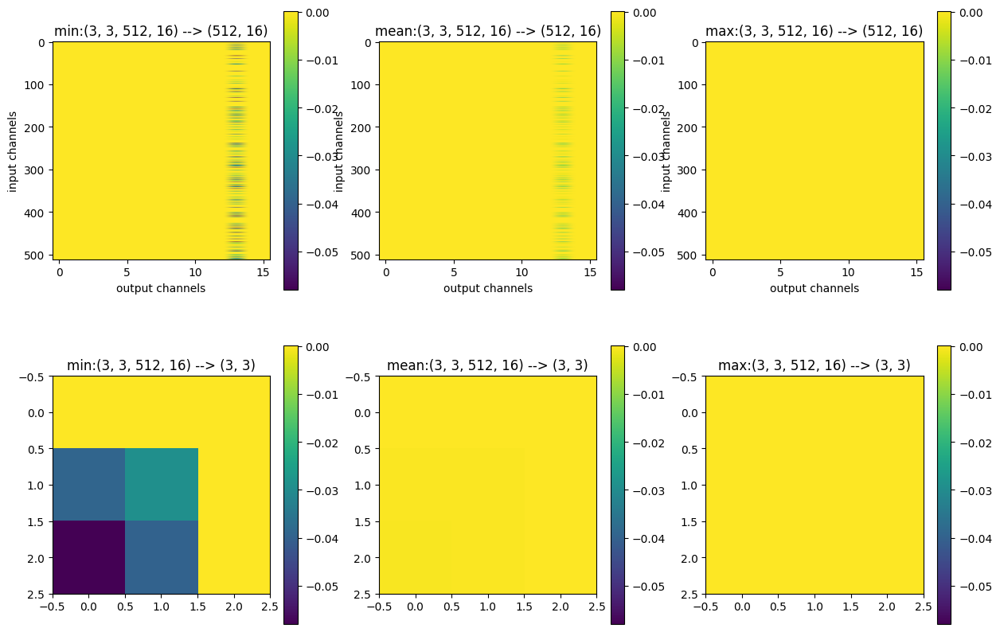

In [ ]:
g = gradients2.gradients_list[0][variable_indices[0]]
plot_conv_layer_values(g)

At the risk of blowing out memory consumption, let's just simplistically see if we can collect all raw gradients during a short training run that hopefully gets close to the point of failure like we're getting.

Prepared SLAM model
  Map shape:        (149, 149, 3) + padding (11, 11, 0)
  Skip-connections: concat
  Output scaling:   logits
  DLO encoding:     linear/importance
  Layers:           41
  Inputs:           [<KerasTensor shape=(None, 149, 149, 3), dtype=float32, sparse=False, name=map_input>, <KerasTensor shape=(None, 149, 149), dtype=float32, sparse=False, name=lds_input>]
  Outputs:          [<KerasTensor shape=(None, 4), dtype=float32, sparse=False, name=keras_tensor_389>]
  Output names:     ListWrapper(['adlo_output'])
  Compiled:         True
Epoch 1/3
32/32 ━━━━━━━━━━━━━━━━━━━━ 19s 419ms/step - accept_accuracy: 0.6546 - adlo_loss: 3.2573 - loc_error: 0.2344 - loss: 1.9392 - orientation_error: 0.6350
Epoch 2/3
32/32 ━━━━━━━━━━━━━━━━━━━━ 10s 303ms/step - accept_accuracy: 0.7480 - adlo_loss: 1.2947 - loc_error: 0.1124 - loss: 1.2403 - orientation_error: 0.2028
Epoch 3/3
32/32 ━━━━━━━━━━━━━━━━━━━━ 10s 301ms/step - accept_accuracy: 0.7595 - adlo_loss: 1.2523 - loc_error: 0.1085 -

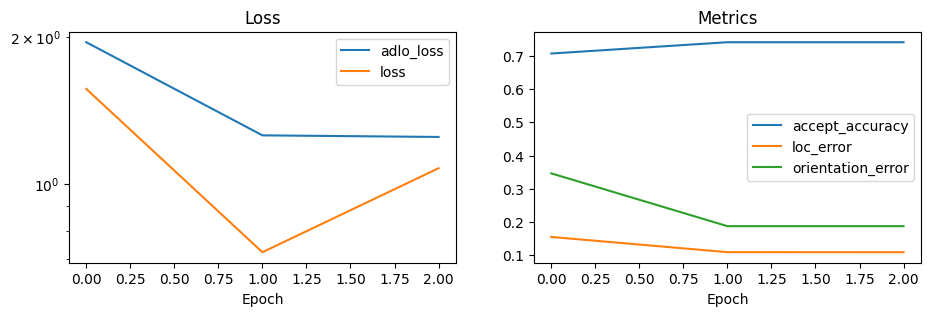

In [ ]:
# Let's re-train with training visualisations enabled
reload(slam_models)
np.random.seed(42)
tf.random.set_seed(42)
epochs = 3
batch_size = 32
tf.config.run_functions_eagerly(False)
map_shape = next(iter(train_data))[0][0].shape
model_train_data = train_data.map(for_adlo_training)\
  .shuffle(buffer_size=len(train_data))\
  .batch(batch_size)\
  .prefetch(tf.data.experimental.AUTOTUNE)
model = adlo_model(map_shape, compile=True, verbose_history=True)

activity = toolkit.ActivityRateCallback(model_train_data, interval=1)
gradients = toolkit.GradientHistoryCallback(verbose=3)
model_history = toolkit.fit(model, model_train_data, epochs=epochs, gradient_callback=gradients, callbacks=[activity])

display_history(model_history)

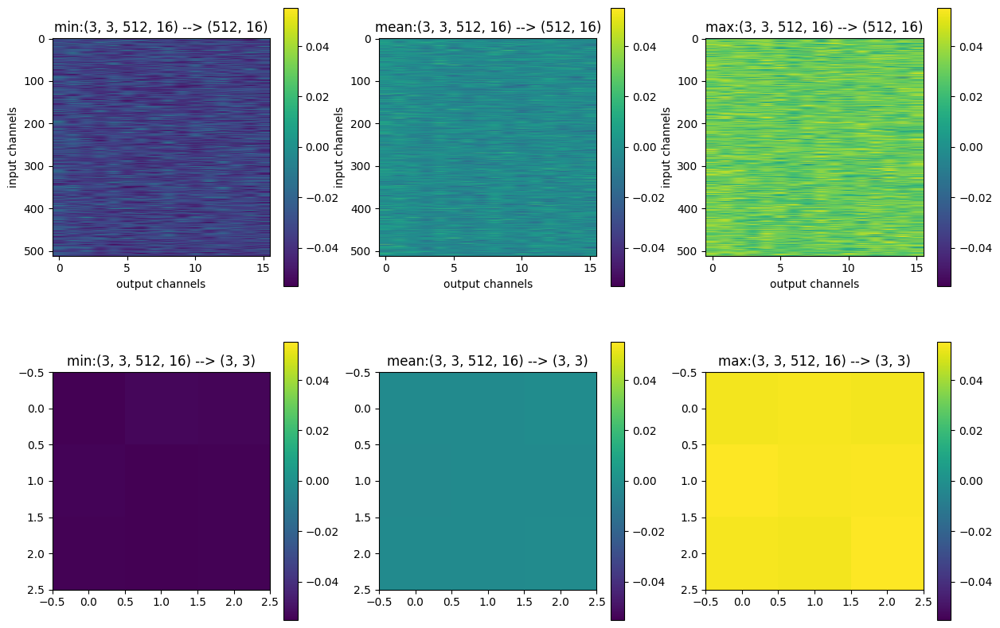

In [ ]:
w = model.layers[l_idx].weights[0]
plot_conv_layer_values(w)

In [ ]:
# Look at the gradients of just our target layer: #35
l_idx=35
variable_indices = gradients._variable_indices_by_layer[l_idx]
print(f"gradients_list: {len(gradients.gradients_list)} steps x {type(gradients.gradients_list[0])} x {len(gradients.gradients_list[0])} gradients x {type(gradients.gradients_list[0][0])}")
print(f"layer {l_idx} - gradients at indices {variable_indices}:")
for index in variable_indices:
  print(f"  {index}: {gradients.gradients_list[0][index].shape}")

print(f"biases: {gradients.gradients_list[0][variable_indices[1]]}")

gradients_list: 96 steps x <class 'list'> x 44 gradients x <class 'tensorflow.python.framework.ops.EagerTensor'>
layer 35 - gradients at indices [36, 37]:
  36: (3, 3, 512, 16)
  37: (16,)
biases: [-9.52416509e-02 -1.67520463e-01 -4.40145954e-02  7.48446941e-01
 -1.92981720e-01  6.05780363e-01  9.31004405e-01  5.64909339e-01
 -1.07026845e-02 -7.29180872e-04  1.34721386e+00  2.43623972e-01
 -2.15717226e-01  2.50968099e-01  2.90872604e-02  1.85527503e-01]


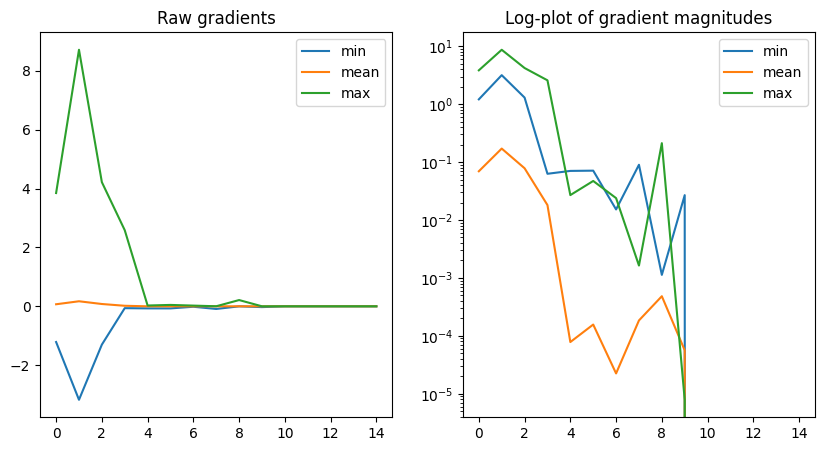

In [ ]:
min_grads = np.array([tf.reduce_min(grads[variable_indices[0]]) for grads in gradients.gradients_list])
mean_grads = np.array([tf.reduce_mean(grads[variable_indices[0]]) for grads in gradients.gradients_list])
max_grads = np.array([tf.reduce_max(grads[variable_indices[0]]) for grads in gradients.gradients_list])

plt.figure(figsize=(10,5))

plt.subplot(1,2,1)
plt.title('Raw gradients')
plt.plot(min_grads[0:15], label='min')
plt.plot(mean_grads[0:15], label='mean')
plt.plot(max_grads[0:15], label='max')
plt.legend()

plt.subplot(1,2,2)
plt.title('Log-plot of gradient magnitudes')
plt.plot(np.abs(min_grads)[0:15], label='min')
plt.plot(np.abs(mean_grads)[0:15], label='mean')
plt.plot(np.abs(max_grads)[0:15], label='max')
plt.legend()
plt.yscale('log')

plt.show()

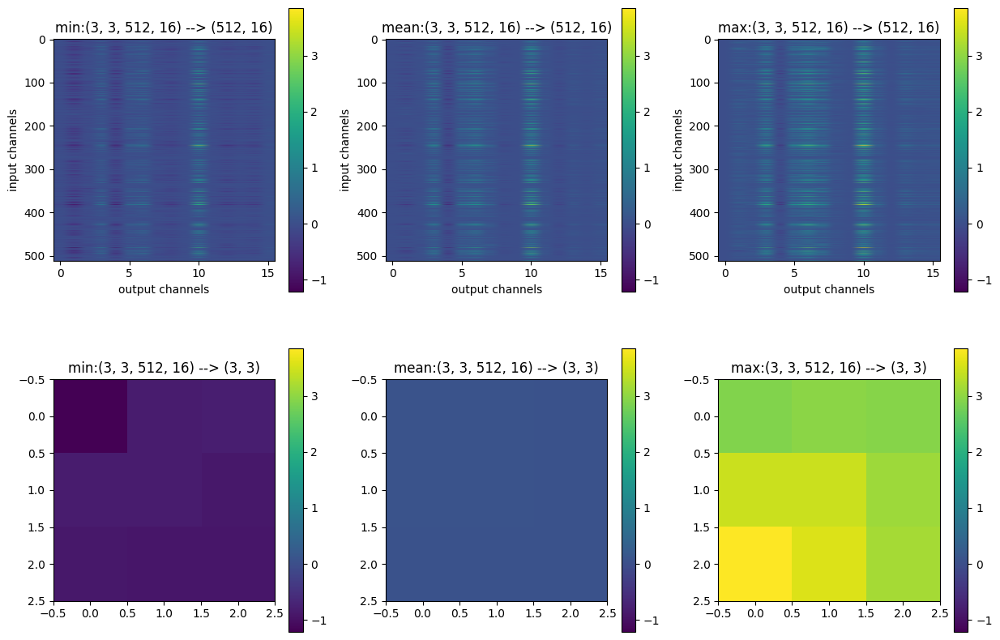

In [ ]:
# layer 35 gradients at start
g = gradients.gradients_list[0][variable_indices[0]]
plot_conv_layer_values(g)

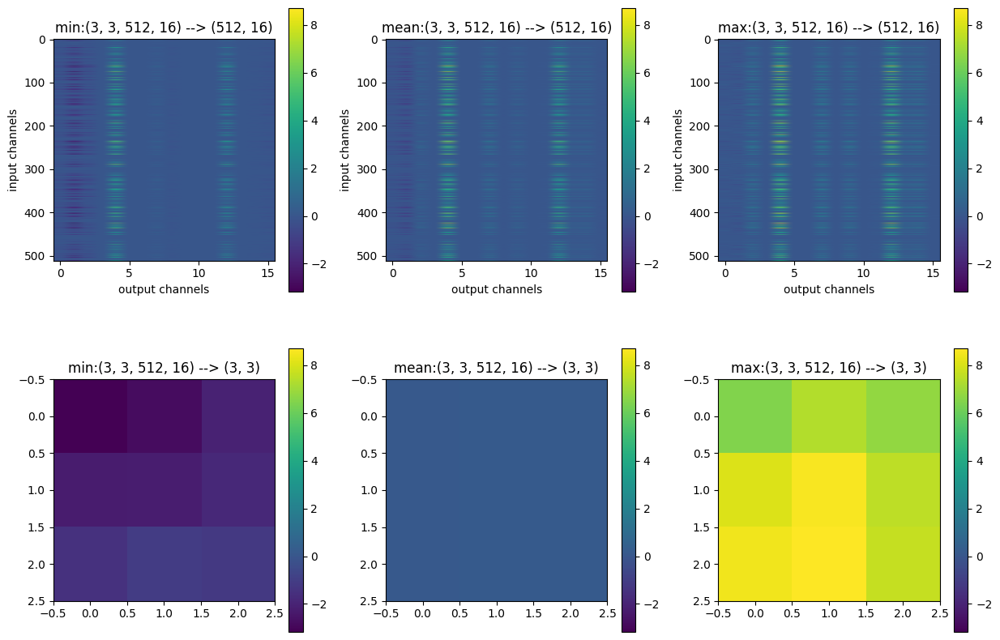

In [ ]:
# layer 35 gradients at step 1
g = gradients.gradients_list[1][variable_indices[0]]
plot_conv_layer_values(g)

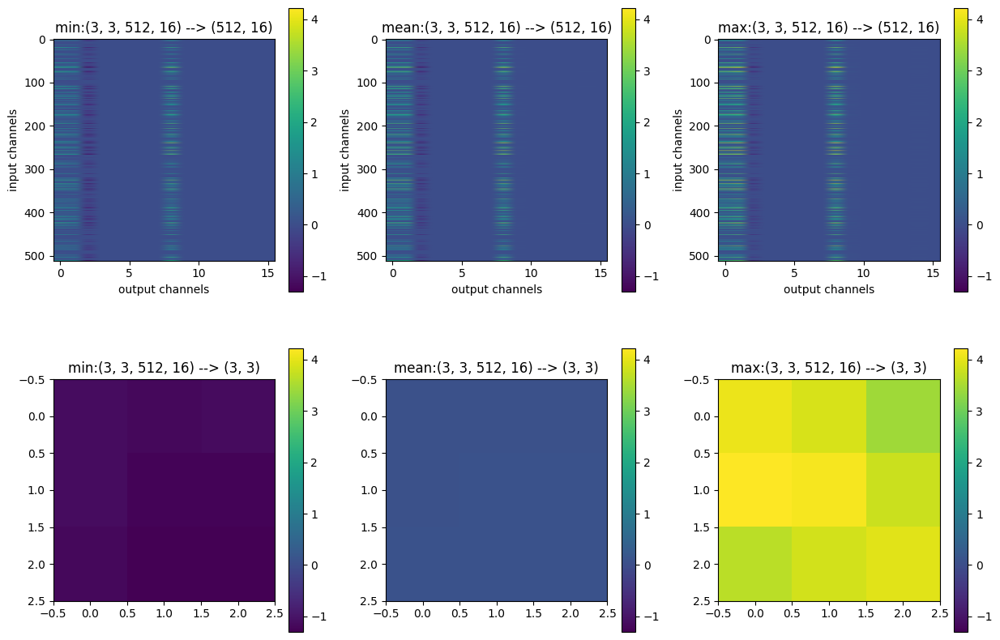

In [ ]:
# layer 35 gradients at step 2
g = gradients.gradients_list[2][variable_indices[0]]
plot_conv_layer_values(g)

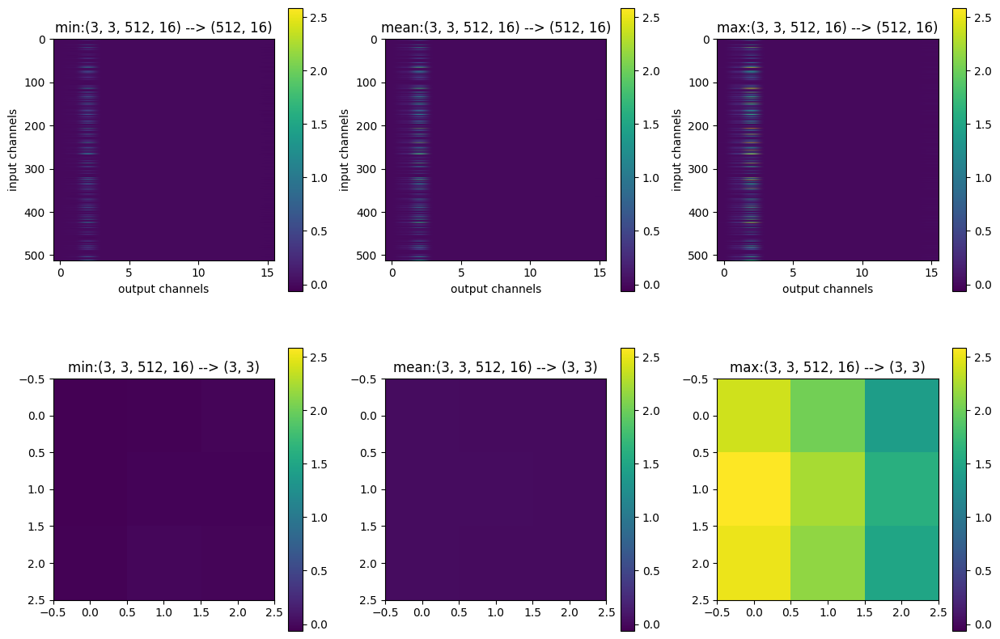

In [ ]:
# layer 35 gradients at step 3
g = gradients.gradients_list[3][variable_indices[0]]
plot_conv_layer_values(g)

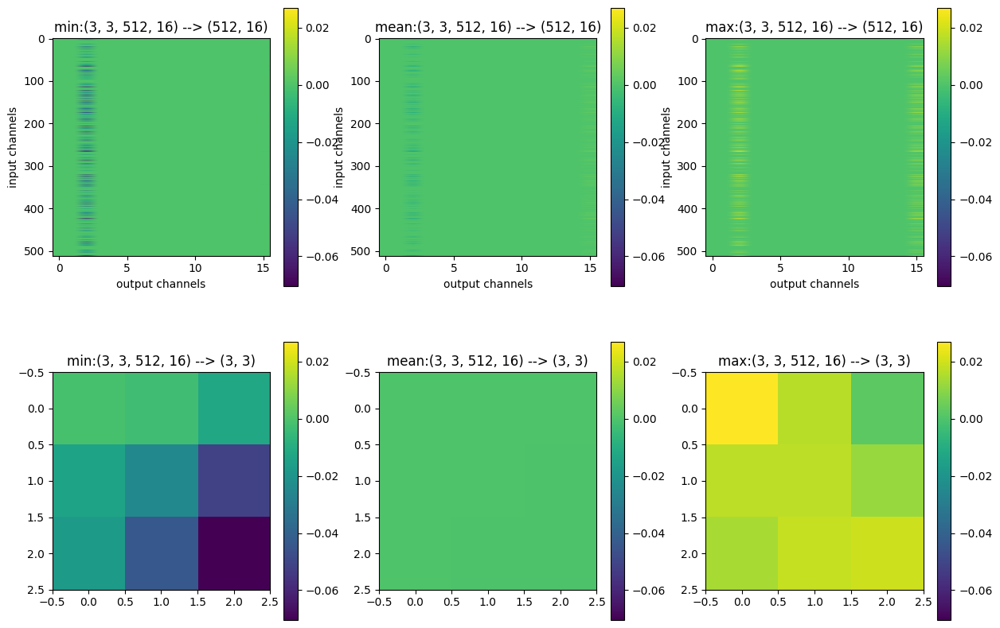

In [ ]:
# layer 35 gradients at step 4
g = gradients.gradients_list[4][variable_indices[0]]
plot_conv_layer_values(g)

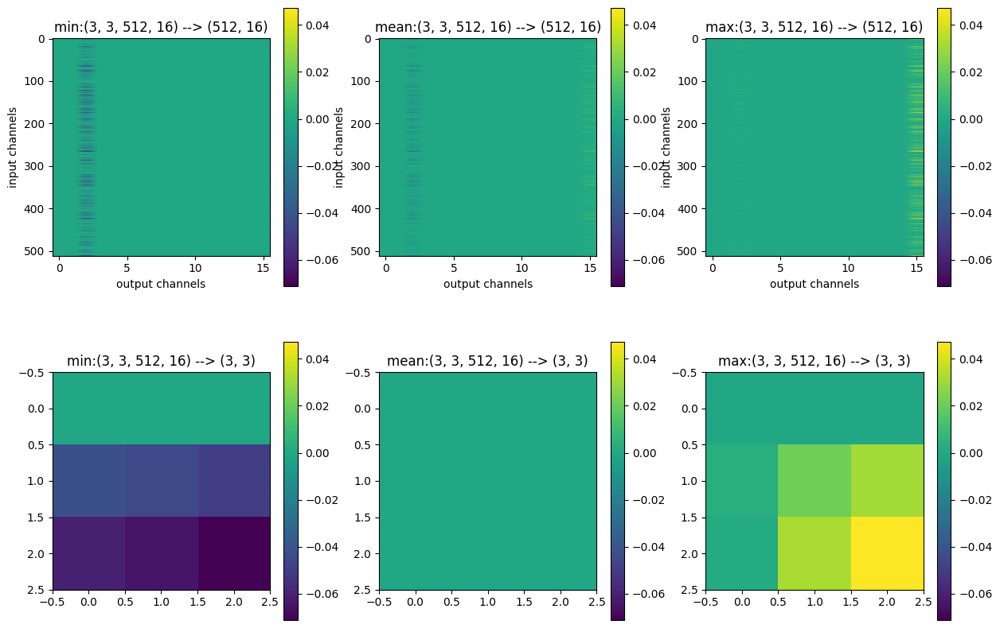

In [ ]:
# layer 35 gradients at step 5 (about 2/3rd towards collapse point)
g = gradients.gradients_list[5][variable_indices[0]]
plot_conv_layer_values(g)

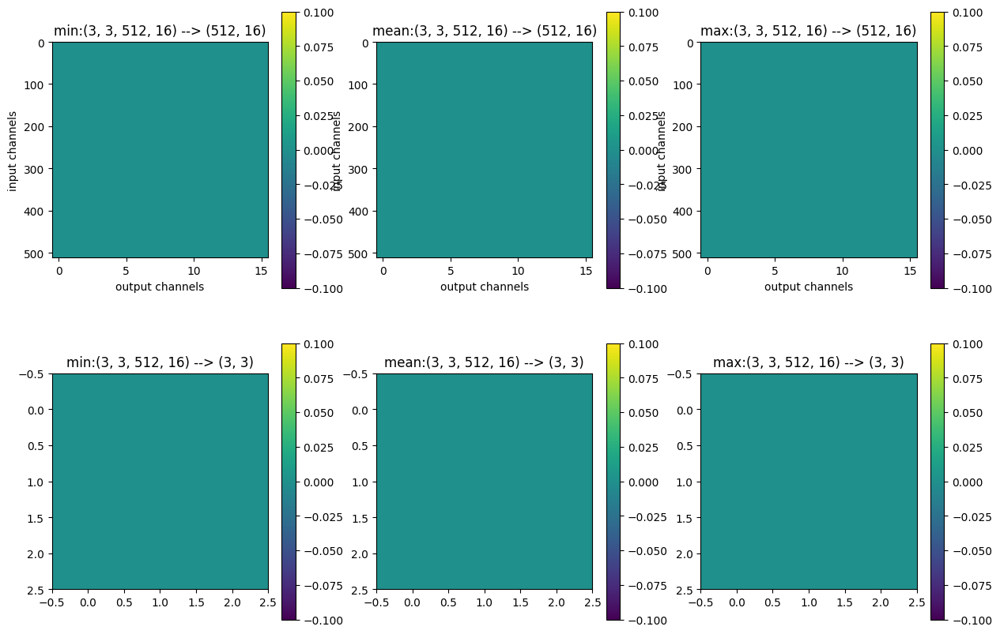

In [ ]:
# layer 35 gradients at end
g = gradients.gradients_list[-1][variable_indices[0]]
plot_conv_layer_values(g)

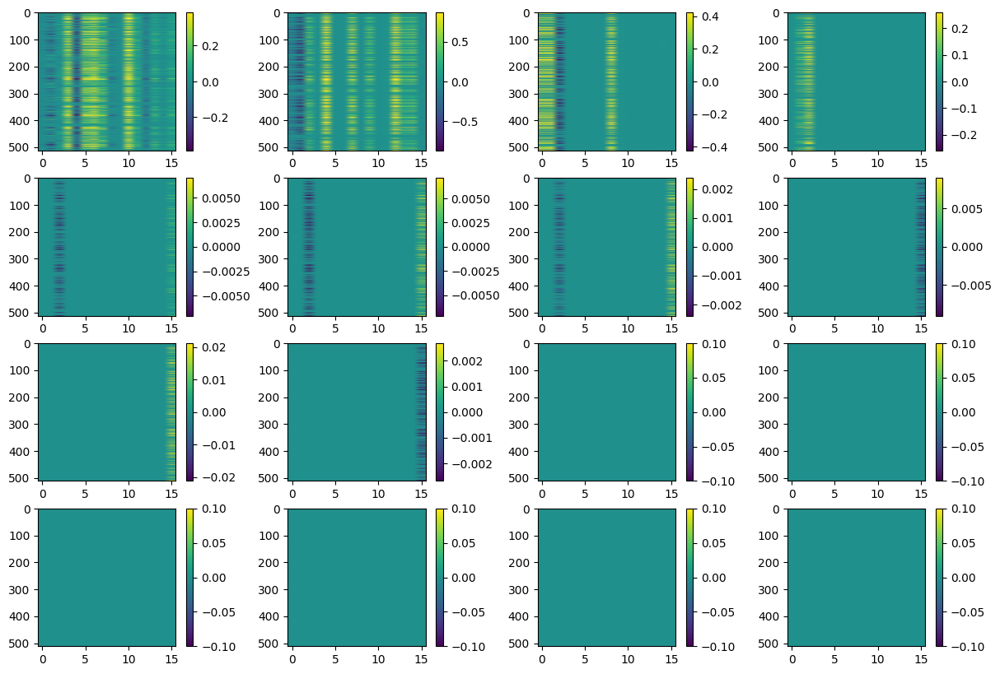

In [ ]:
# Plot just the channel-to-channel means, with colorbar scaled to exaggerate contrast
ln=16
plt.figure(figsize=(15,10))
for step in range(0, ln):
  g = gradients.gradients_list[step][variable_indices[0]]
  g_min = tf.reduce_min(g)
  g_max = tf.reduce_max(g)
  vsz = max(abs(g_min), abs(g_max))
  mean = tf.reduce_mean(g, axis=(0, 1))
  plot_aspect = mean.shape[1] / mean.shape[0]

  plt.subplot(4, math.ceil(ln/4), step+1)
  plt.imshow(mean, aspect=plot_aspect, vmin=-vsz/10, vmax=vsz/10)
  plt.colorbar()

**Observations:**

* Gradients for all units hit zero on the 11th step.
* The number of live output channels (units) steadily reduces over time.
* Gradients on the output-channel axis stongly move as groups, in the same direction.
* What's inexplicable is that the raw weights at the end don't show any of this trend.

**Theories:**
* I think the output-channel grouping implies that there's pressure due to backprop from the next layer (as opposed to being activation pressure from the previous layer)
* This is further implied by the weights being good.

Remember:
* gradient at a given ReLU layer is a result of:
  * prev_layer_activations $\times$ 1 $\times$ current_layer_activation_bool_matrix $\times$ next_layer_backprop_gradients
* backprop gradients from next layer are result of:
  * current_layer_weights $\times$ current_layer_activation_bool_matrix $\times$ 1 $\times$ next_layer_activation_bool_matrix $\times$ ...

## Appendix: Untrained model
For reference to results above, let's look at what things look like for an entirely untrained model.

In [ ]:
untrained_model = adlo_model((149, 149, 3), compile=True, verbose_history=True)
untrained_model.summary()

Prepared SLAM model
  Map shape:        (149, 149, 3) + padding (11, 11, 0)
  Skip-connections: concat
  Output scaling:   logits
  DLO encoding:     linear/importance
  Layers:           41
  Inputs:           [<KerasTensor shape=(None, 149, 149, 3), dtype=float32, sparse=False, name=map_input>, <KerasTensor shape=(None, 149, 149), dtype=float32, sparse=False, name=lds_input>]
  Outputs:          [<KerasTensor shape=(None, 4), dtype=float32, sparse=False, name=keras_tensor_233>]
  Output names:     ListWrapper(['adlo_output'])
  Compiled:         True


Model: "functional_9"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ lds_input (InputLayer)    │ (None, 149, 149)       │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ map_input (InputLayer)    │ (None, 149, 149, 3)    │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ reshape_5 (Reshape)       │ (None, 149, 149, 1)    │              0 │ lds_input[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ zero_padding2d_10         │ (None, 160, 160, 3)    │              0 │ map_input[0][0]        │
│ (ZeroPadding2D)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ zero_padding2d_11         │ (None, 160, 160, 1)    │              0 │ reshape_5[0][0]        │
│ (ZeroPadding2D)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_95 (Conv2D)        │ (None, 160, 160, 32)   │            896 │ zero_padding2d_10[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_103 (Conv2D)       │ (None, 160, 160, 32)   │            320 │ zero_padding2d_11[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_96 (Conv2D)        │ (None, 160, 160, 32)   │          9,248 │ conv2d_95[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_104 (Conv2D)       │ (None, 160, 160, 32)   │          9,248 │ conv2d_103[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_40          │ (None, 80, 80, 32)     │              0 │ conv2d_96[0][0]        │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_44          │ (None, 80, 80, 32)     │              0 │ conv2d_104[0][0]       │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_97 (Conv2D)        │ (None, 80, 80, 64)     │         18,496 │ max_pooling2d_40[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_105 (Conv2D)       │ (None, 80, 80, 64)     │         18,496 │ max_pooling2d_44[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_98 (Conv2D)        │ (None, 80, 80, 64)     │         36,928 │ conv2d_97[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_106 (Conv2D)       │ (None, 80, 80, 64)     │         36,928 │ conv2d_105[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_41          │ (None, 40, 40, 64)     │              0 │ conv2d_98[0][0]        │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_45          │ (None, 40, 40, 64)     │              0 │ conv2d_106[0][0]       │
│ (MaxPooling2D)       

 Total params: 7,613,972 (29.04 MB)

 Trainable params: 7,613,972 (29.04 MB)

 Non-trainable params: 0 (0.00 B)

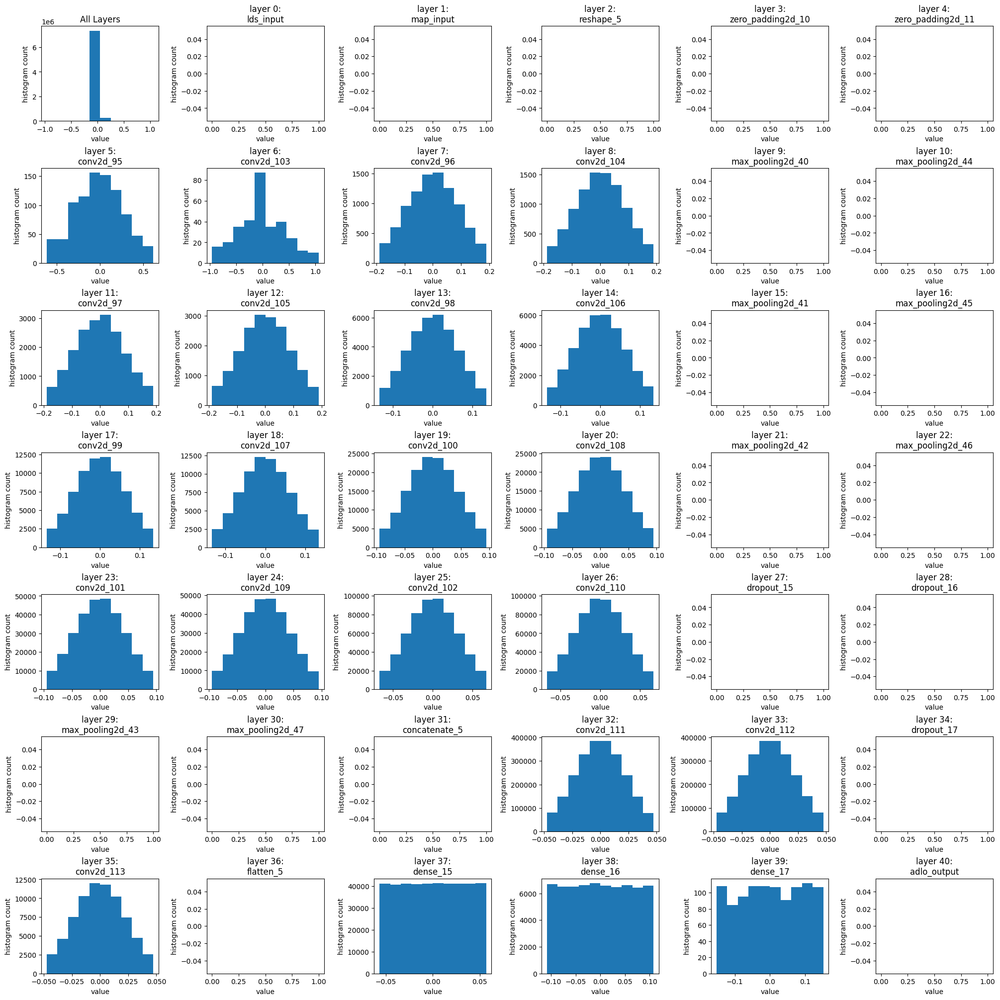

In [ ]:
# weights for an untrained model
plot_weights(untrained_model, all_layers=True)

In [ ]:
# collect model and layer stats from untrained model
model_stats, layer_stats, layer_channel_activity, layer_spatial_activity = toolkit.measure_unit_activity(untrained_model, model_train_data, include_channel_activity=True, include_spatial_activity=True, verbose=1)
print(f"model_stats: {model_stats}")
print(f"layer_stats: {layer_stats}")

Prepared SLAM model
  Map shape:        (149, 149, 3) + padding (11, 11, 0)
  Skip-connections: concat
  Output scaling:   logits
  DLO encoding:     linear/importance
  Layers:           41
  Inputs:           [<KerasTensor shape=(None, 149, 149, 3), dtype=float32, sparse=False, name=map_input>, <KerasTensor shape=(None, 149, 149), dtype=float32, sparse=False, name=lds_input>]
  Outputs:          [<KerasTensor shape=(None, 4), dtype=float32, sparse=False, name=keras_tensor_155>]
  Output names:     ListWrapper(['adlo_output'])
  Compiled:         True


100%|██████████| 32/32 [00:04<00:00,  7.08it/s]

model_stats: {'min_dead_rate': 0.0, 'max_dead_rate': 0.19140625, 'mean_dead_rate': 0.01229611280487805, 'min_activation_rate': 0.008030129, 'max_activation_rate': 1.0, 'mean_activation_rate': 0.41871923}
layer_stats: [{'dead_rate': 0.0, 'activation_rate': 0.00925955}, {'dead_rate': 0.0, 'activation_rate': 0.7788696}, {'dead_rate': 0.0, 'activation_rate': 0.009259551}, {'dead_rate': 0.0, 'activation_rate': 0.6754565}, {'dead_rate': 0.0, 'activation_rate': 0.008030129}, {'dead_rate': 0.0, 'activation_rate': 0.3933217}, {'dead_rate': 0.0, 'activation_rate': 0.017440964}, {'dead_rate': 0.0, 'activation_rate': 0.41327614}, {'dead_rate': 0.0, 'activation_rate': 0.02902909}, {'dead_rate': 0.0, 'activation_rate': 0.44391623}, {'dead_rate': 0.0, 'activation_rate': 0.054898396}, {'dead_rate': 0.0, 'activation_rate': 0.4775759}, {'dead_rate': 0.0, 'activation_rate': 0.07068715}, {'dead_rate': 0.0, 'activation_rate': 0.50857323}, {'dead_rate': 0.0, 'activation_rate': 0.09237398}, {'dead_rate': 0.0

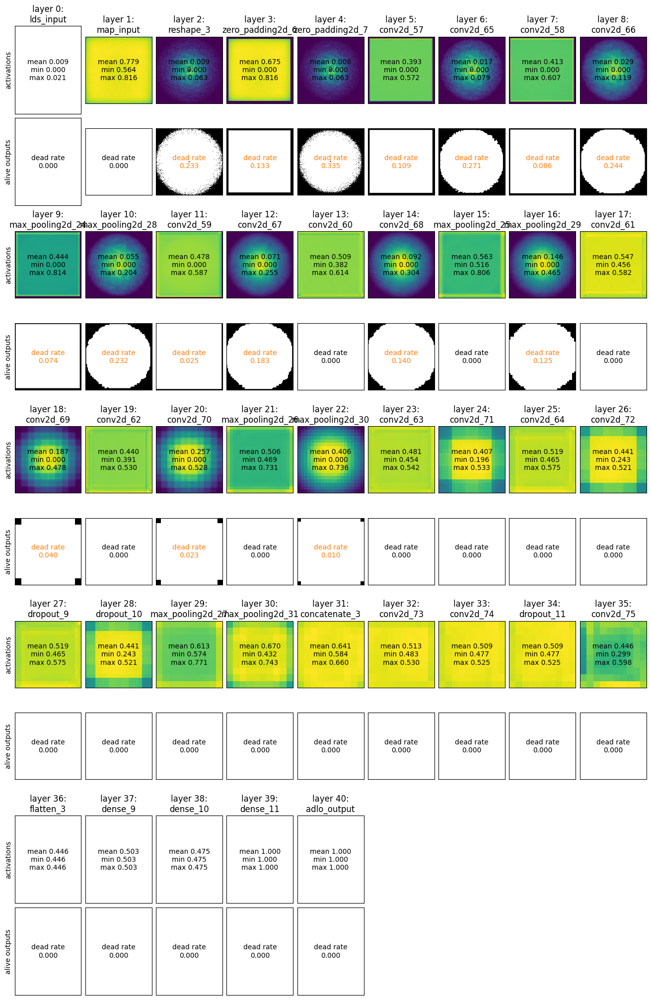

In [ ]:
reload(toolkit)
toolkit.plot_spatial_stats(layer_spatial_activity, untrained_model)

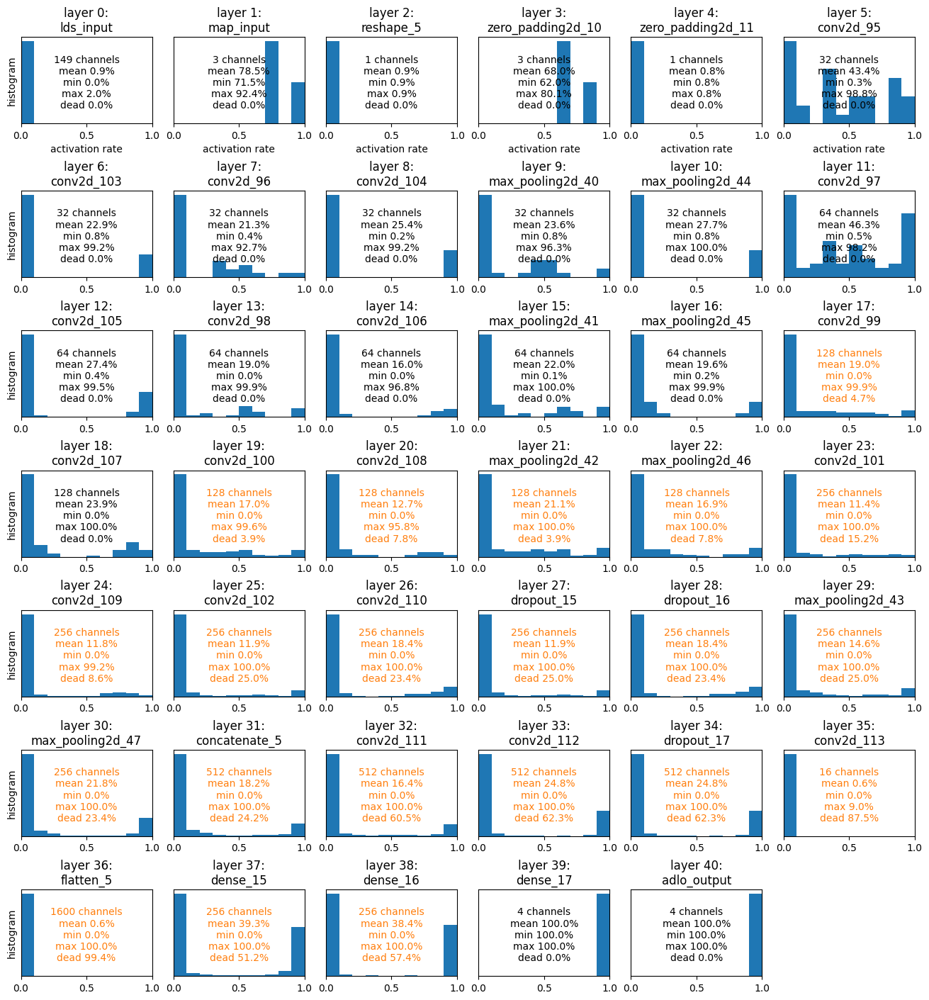

In [ ]:
reload(toolkit)
toolkit.plot_channel_stats(layer_channel_activity, untrained_model)